# Importing

## Modules

In [398]:
from F00_global_variables import *
os.chdir('/mnt/08_thymus_cell_atlas/')

sys.path.append('/mnt/thymus_atlas')
import scjp
from scjp import markers, model, draw, species

sc.settings.verbosity = 3
sc.settings.set_figure_params(dpi=100, color_map='OrRd')
sc.logging.print_version_and_date()
%load_ext autoreload
%autoreload 2
%load_ext rpy2.ipython

version = 'HTA08.v02.A04.'

print('Version: '+version)

Running Scanpy 1.4.3 on 2019-09-29 04:01.
The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload
The rpy2.ipython extension is already loaded. To reload it, use:
  %reload_ext rpy2.ipython
Version: HTA08.v02.A04.


## Write

In [117]:
ann = scjp.annotater(mm_jptca,'anno_level_16',old_label='anno_level_15')

In [118]:
ann.update(mm_jptca,'anno_level_15','entry1,entry2','αβT(entry)')
ann.update(mm_jptca,'anno_level_15','T_Tnfrsf9','IELpA')
ann.update(mm_jptca,'anno_level_15','NKT','IELpB/NKT')
ann.update(mm_jptca,'anno_level_15','T_gd','γδT')
ann.update(mm_jptca,'anno_level_15','T_CD4','CD4+T')
ann.update(mm_jptca,'anno_level_15','T_CD8','CD8+T')
ann.update(mm_jptca,'anno_level_15','TEC_unknown_2','Epi_unknown')
ann.update(mm_jptca,'anno_level_15','mTEC_early','TEC_early')

In [69]:
SP = scjp.get_subset(mm_jptca,mm_jptca.obs['anno_level_16'].isin(['CD4+T','CD8+T','Treg','SP_cycling']),cc_genes = [])

Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.` This will likely become the Scanpy default in the future.
computing PCA with n_comps = 50
    finished (0:00:00.34)


creating lr model...


/home/ubuntu/.local/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:469: FutureWarning:

Default multi_class will be changed to 'auto' in 0.22. Specify the multi_class option to silence this warning.

Trying to set attribute `.obs` of view, making a copy.


making lr prediction...
updating lr to adata...


LogisticRegression(C=0.2, class_weight=None, dual=False, fit_intercept=True,
                   intercept_scaling=1, l1_ratio=None, max_iter=100,
                   multi_class='warn', n_jobs=None, penalty='l2',
                   random_state=None, solver='warn', tol=0.0001, verbose=0,
                   warm_start=False)

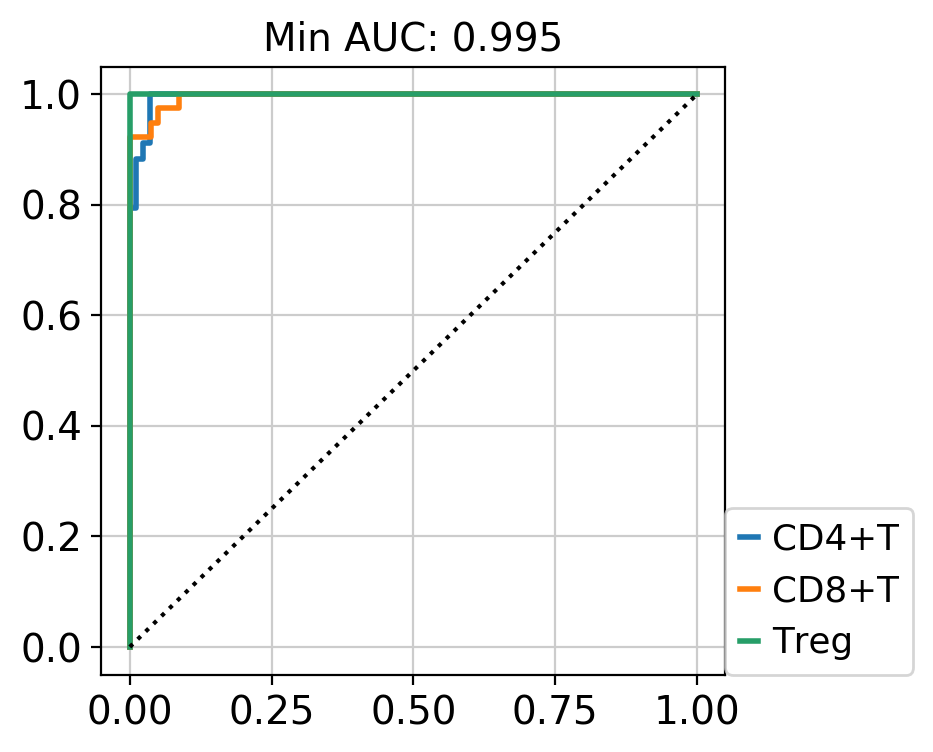

In [54]:
scjp.model.transfer_annotation_jp(SP,'anno_level_16',SP,'anno_level_17',exclude=['SP_cycling'])

In [71]:
scjp.sc_process(SP,pid='nul')

computing neighbors
    using 'X_pca' with n_pcs = 50


/home/ubuntu/.local/lib/python3.6/site-packages/umap/umap_.py:349: NumbaWarning:


Compilation is falling back to object mode WITH looplifting enabled because Function "fuzzy_simplicial_set" failed type inference due to: Untyped global name 'nearest_neighbors': cannot determine Numba type of <class 'function'>

File "../../home/ubuntu/.local/lib/python3.6/site-packages/umap/umap_.py", line 467:
def fuzzy_simplicial_set(
    <source elided>
    if knn_indices is None or knn_dists is None:
        knn_indices, knn_dists, _ = nearest_neighbors(
        ^


/home/ubuntu/.local/lib/python3.6/site-packages/numba/compiler.py:725: NumbaWarning:

Function "fuzzy_simplicial_set" was compiled in object mode without forceobj=True.

File "../../home/ubuntu/.local/lib/python3.6/site-packages/umap/umap_.py", line 350:
@numba.jit()
def fuzzy_simplicial_set(
^


/home/ubuntu/.local/lib/python3.6/site-packages/numba/compiler.py:734: NumbaDeprecationWarning:


Fall-back from the nopython compilation path

    finished (0:00:02.06) --> added to `.uns['neighbors']`
    'distances', distances for each pair of neighbors
    'connectivities', weighted adjacency matrix
computing UMAP
    using 'X_pca' with n_pcs = 50
    finished (0:00:05.90) --> added
    'X_umap', UMAP coordinates (adata.obsm)
running Leiden clustering
    finished (0:00:00.35) --> found 9 clusters and added
    'leiden', the cluster labels (adata.obs, categorical)


In [85]:
scjp.bbknn_umap(SP,'Age',30)

computing batch balanced neighbors


/home/ubuntu/.local/lib/python3.6/site-packages/umap/umap_.py:349: NumbaWarning:


Compilation is falling back to object mode WITH looplifting enabled because Function "fuzzy_simplicial_set" failed type inference due to: Untyped global name 'nearest_neighbors': cannot determine Numba type of <class 'function'>

File "../../home/ubuntu/.local/lib/python3.6/site-packages/umap/umap_.py", line 467:
def fuzzy_simplicial_set(
    <source elided>
    if knn_indices is None or knn_dists is None:
        knn_indices, knn_dists, _ = nearest_neighbors(
        ^


/home/ubuntu/.local/lib/python3.6/site-packages/numba/compiler.py:725: NumbaWarning:

Function "fuzzy_simplicial_set" was compiled in object mode without forceobj=True.

File "../../home/ubuntu/.local/lib/python3.6/site-packages/umap/umap_.py", line 350:
@numba.jit()
def fuzzy_simplicial_set(
^


/home/ubuntu/.local/lib/python3.6/site-packages/numba/compiler.py:734: NumbaDeprecationWarning:


Fall-back from the nopython compilation path

	finished (0:00:01.73) --> added to `.uns['neighbors']`
	'distances', weighted adjacency matrix
	'connectivities', weighted adjacency matrix
computing UMAP
    using 'X_pca' with n_pcs = 50
    finished (0:00:05.43) --> added
    'X_umap', UMAP coordinates (adata.obsm)


In [86]:
sc.tl.leiden(SP)

running Leiden clustering
    finished (0:00:00.27) --> found 10 clusters and added
    'leiden', the cluster labels (adata.obs, categorical)


In [100]:
sc.tl.leiden(SP,resolution=3.0)

running Leiden clustering
    finished (0:00:00.57) --> found 33 clusters and added
    'leiden', the cluster labels (adata.obs, categorical)


In [103]:
ann = scjp.annotater(SP,'anno_level_17',old_label='anno_level_17')

In [104]:
ann.update(SP,'leiden','28','Treg')

In [122]:
del mm_jptca.obs['anno_level_17']

In [123]:
scjp.model.update_label(SP,'anno_level_17',mm_jptca,'anno_level_16','anno_level_17')

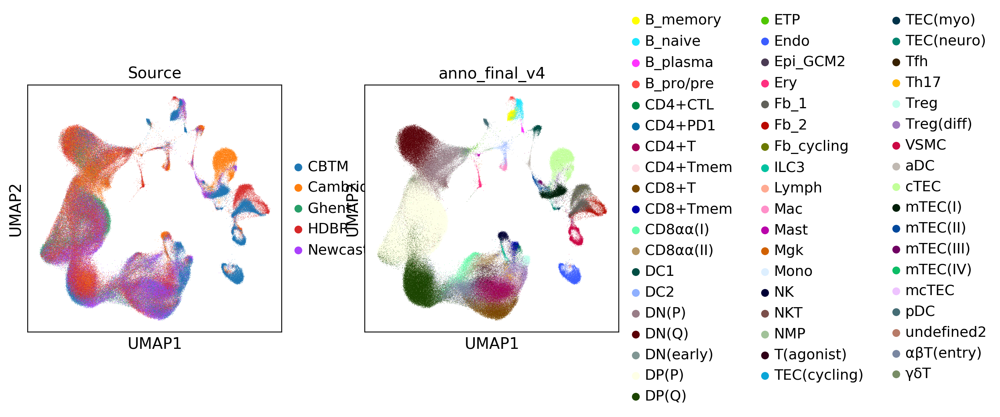

In [138]:
scjp.us(hs,'Source,anno_final_v4')

In [141]:
del hs.obs['anno_final_v5']

In [142]:
scjp.model.update_label(TEC_hs,'anno_final_v4',hs,'anno_final_v4','anno_final_v5')

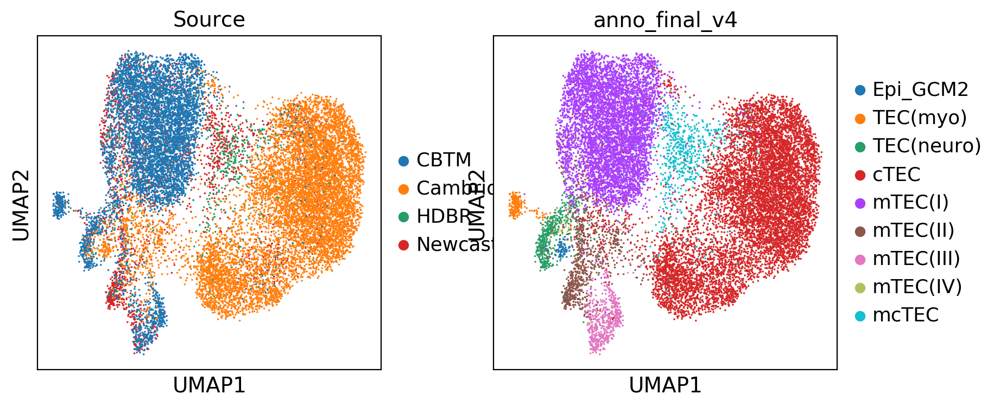

In [137]:
scjp.us(TEC_hs,'Source,anno_final_v4')

... storing 'anno_final_v5' as categorical


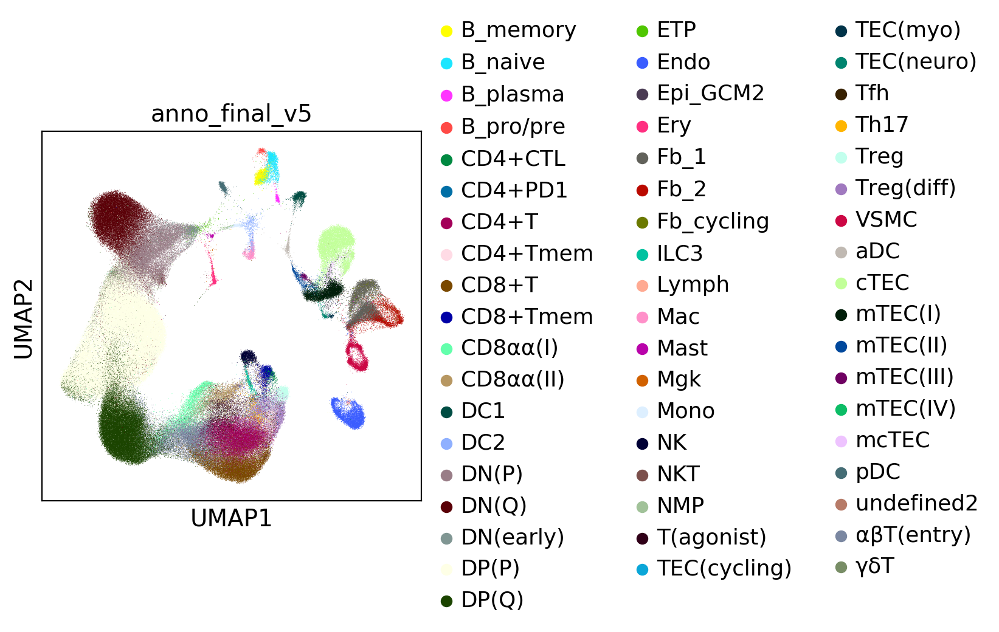

In [143]:
scjp.us(hs,'anno_final_v5')

In [144]:
tc = hs[hs.obs['anno_final_v5']=='TEC(cycling)']

creating lr model...


/home/ubuntu/.local/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning:

Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.

/home/ubuntu/.local/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:469: FutureWarning:

Default multi_class will be changed to 'auto' in 0.22. Specify the multi_class option to silence this warning.

Trying to set attribute `.obs` of view, making a copy.


making lr prediction...
updating lr to adata...


LogisticRegression(C=0.2, class_weight=None, dual=False, fit_intercept=True,
                   intercept_scaling=1, l1_ratio=None, max_iter=100,
                   multi_class='warn', n_jobs=None, penalty='l2',
                   random_state=None, solver='warn', tol=0.0001, verbose=0,
                   warm_start=False)

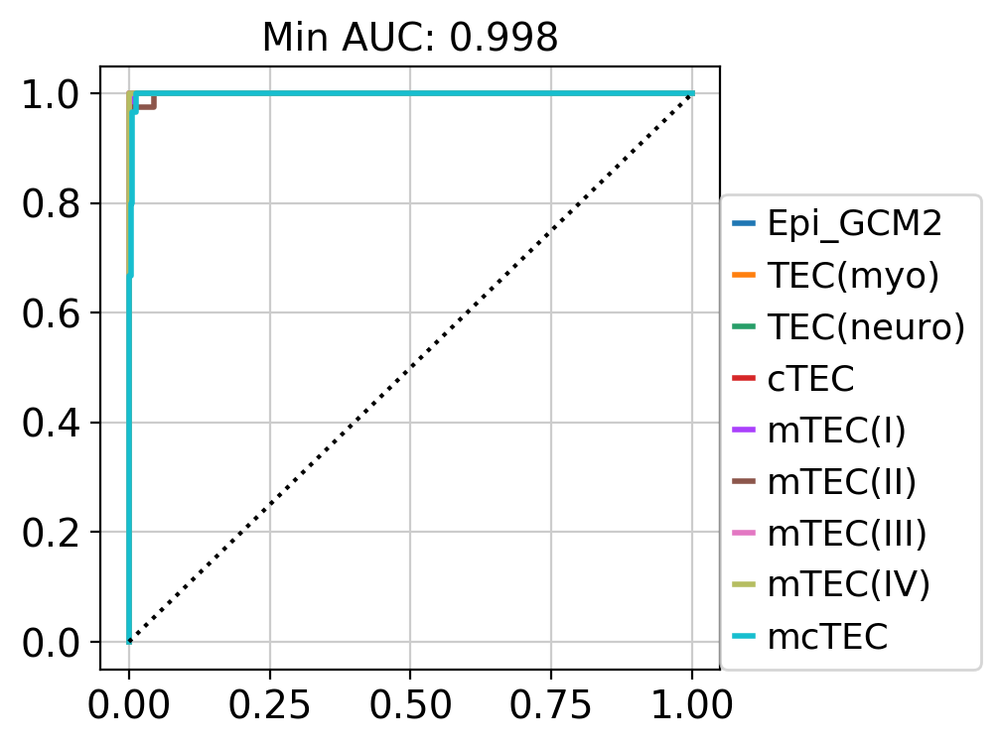

In [145]:
scjp.model.transfer_annotation_jp(TEC_hs,'anno_final_v4',tc,'anno_final_v5')

In [146]:
scjp.model.update_label(tc,'anno_final_v5',hs,'anno_final_v5','anno_final_v6')

In [154]:
ann = scjp.annotater(hs,'anno_final_v6',old_label='anno_final_v6')
ann.update(hs,'anno_final_v6','undefined2','mTEC(IV)')

... storing 'anno_final_v6' as categorical


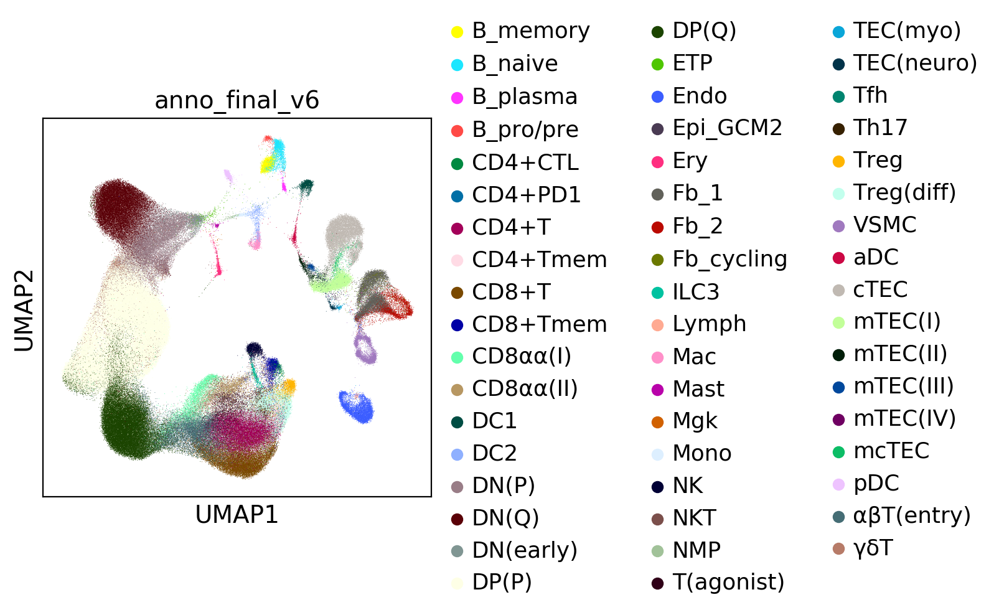

In [155]:
scjp.us(hs,'anno_final_v6')

In [156]:
scjp.write(hs,version,'fig1_data_epi_updated')

Only considering the two last: ['.A04', '.fig1_data_epi_updated'].
HTA08_v02_A04_fig1_data_epi_updated = 'HTA08.v02.A04.fig1_data_epi_updated'


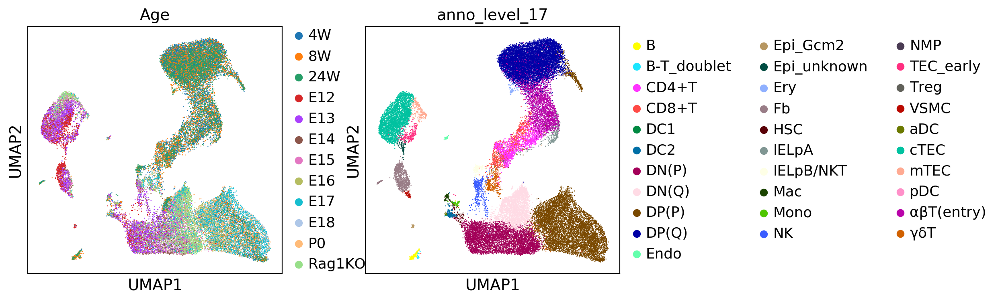

In [125]:
scjp.us(mm_jptca,'Age,anno_level_17')

In [113]:
scjp.write(mm_jptca,version,'mouse_jptca')

Only considering the two last: ['.A04', '.mouse_jptca'].
HTA08_v02_A04_mouse_jptca = 'HTA08.v02.A04.mouse_jptca'


## write paper output

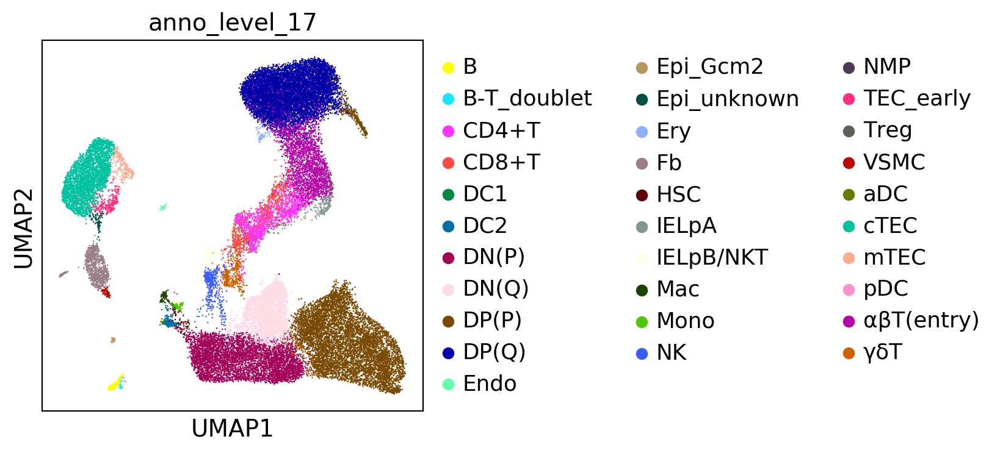

In [472]:
scjp.us(mm_jptca,'anno_level_17')

In [478]:
model.update_label(mm_jptca,'anno_level_17',mm,'anno_level_15','anno_level_17')

In [483]:
model.update_label(mm_jptca,'anno_level_17',mm_jp,'anno_level_15','anno_level_17')

In [148]:
scjp.write(mm_jptca,version,'mouse_jptca')

Only considering the two last: ['.A04', '.mouse_jptca'].
HTA08_v02_A04_mouse_jptca = 'HTA08.v02.A04.mouse_jptca'


In [485]:
scjp.write(mm,version,'mouse_jptcaido')

... storing 'anno_level_17' as categorical


Only considering the two last: ['.A04', '.mouse_jptcaido'].
HTA08_v02_A04_mouse_jptcaido = 'HTA08.v02.A04.mouse_jptcaido'


In [486]:
scjp.write(mm_jp,version,'mouse_jp')

... storing 'anno_level_17' as categorical


Only considering the two last: ['.A04', '.mouse_jp'].
HTA08_v02_A04_mouse_jp = 'HTA08.v02.A04.mouse_jp'


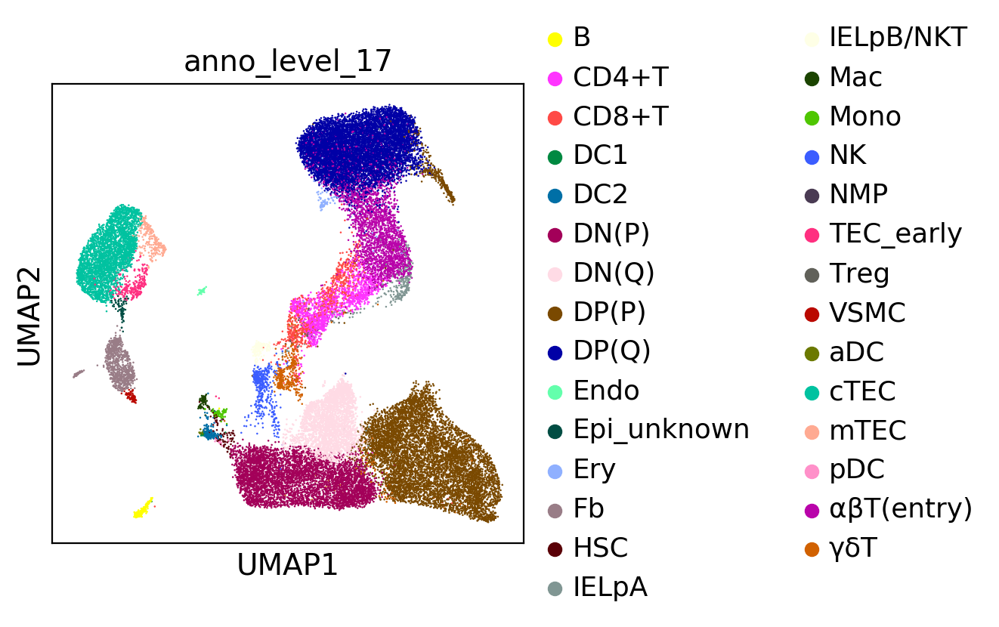

In [824]:
scjp.us(mm_jptca,'anno_level_17')

In [826]:
mouse_total = sc.AnnData(mm_jptca.raw.X)
mouse_total.obs_names = mm_jptca.obs_names
mouse_total.var_names = mm_jptca.raw.var_names

In [833]:
mouse_total.obs['cell types'] = mm_jptca.obs['anno_level_17']
mouse_total.obs['stage'] = mm_jptca.obs['stage']
mouse_total.obs['age'] = mm_jptca.obs['age']
mouse_total.obs['sample_ID'] = mm_jptca.obs['Sample']

In [837]:
mouse_total.obsm['X_umap'] = mm_jptca.obsm['X_umap']

In [840]:
scjp.write(mouse_total,version,'Science_mouse_total')

Only considering the two last: ['.A04', '.Science_mouse_total'].
HTA08_v02_A04_Science_mouse_total = 'HTA08.v02.A04.Science_mouse_total'


In [843]:
mouse_strom = sc.AnnData(ST_mm.raw.X)
mouse_strom.obs_names = ST_mm.obs_names
mouse_strom.var_names = ST_mm.raw.var_names

In [859]:
mouse_strom.obs['cell types'] = ST_mm.obs['anno_level_14']
mouse_strom.obs['age'] = ST_mm.obs['mouse age:ch1']
mouse_strom.obs['sample_ID'] = ST_mm.obs['Experiment_ID']
mouse_strom.obsm['X_umap'] = ST_mm.obsm['X_umap']

In [860]:
scjp.write(mouse_strom,version,'Science_mouse_stromal')

Only considering the two last: ['.A04', '.Science_mouse_stromal'].
HTA08_v02_A04_Science_mouse_stromal = 'HTA08.v02.A04.Science_mouse_stromal'


## Read

In [487]:
mm = sc.read('HTA08.v02.A04.mouse_jptcaido') # 'HTA08.v01.A02.mouse_total_final_v2')

Only considering the two last: ['.A04', '.mouse_jptcaido'].


In [488]:
mm_jp = sc.read( 'HTA08.v02.A04.mouse_jp')

Only considering the two last: ['.A04', '.mouse_jp'].


In [456]:
mm_jptca = sc.read('HTA08.v02.A04.mouse_jptca')

Only considering the two last: ['.A04', '.mouse_jptca'].


In [133]:
TEC_hs = sc.read('HTA08.v01.A05.human_TECs')

Only considering the two last: ['.A05', '.human_TECs'].


In [394]:
#hs = sc.read('HTA08.v02.A04.fig1_data_epi_updated')
hs = sc.read('HTA08.v01.A05.fig1_data_vdj_added')

Only considering the two last: ['.A05', '.fig1_data_vdj_added'].


In [680]:
ST_mm = sc.read('HTA08.v01.A02.ido_annotated')

Only considering the two last: ['.A02', '.ido_annotated'].


/home/ubuntu/.local/lib/python3.6/site-packages/anndata/readwrite/read.py:440: DeprecationWarning:

In a future version, read_h5ad will no longer explicitly support boolean arguments. Specify the read mode, or leave `backed=None`.



## Subset T cells only

In [142]:
hs_isT = ['CD4+T','CD8+T','CD8αα(I)', 'Th17',
 'CD8αα(II)','ILC3','NK','NKT', 'T(agonist)','αβT(entry)',
 'γδT','Treg', 'Treg(diff)']

In [143]:
mm_isT = ['CD4+T','CD8+T',
'NK','IELpA', 'IELpB/NKT','T(agonist)','αβT(entry)',
 'γδT','Treg']

In [144]:
c1 = hs.obs['anno_final_v6'].isin(hs_isT)
c2 = hs.obs['Source'].isin('Newcastle,HDBR'.split(','))
c3 = hs.obs['method']=='5GEX'
np.sum(c1&c2&c3)

30724

In [145]:
hs_subset = scjp.get_subset(hs,c1&c2,cc_genes = [])

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.` This will likely become the Scanpy default in the future.
computing PCA with n_comps = 50
    finished (0:00:05.84)


In [172]:
c1 = mm_jptca.obs['anno_level_17'].isin(mm_isT)
c2 = mm_jptca.obs['name']=='jp'

mm_subset  = scjp.get_subset(mm_jptca,c1&c2,cc_genes = [])

Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.` This will likely become the Scanpy default in the future.
computing PCA with n_comps = 50
    finished (0:00:00.58)


In [173]:
mouse_names = [scjp.species.mouse_to_human(x) for x in mm_subset.raw.var_names]

In [174]:
mm_subset_raw = sc.AnnData(mm_subset.raw.X)
mm_subset_raw.var_names = mouse_names
mm_subset.raw = mm_subset_raw

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [175]:
hs_s,mm_s = scjp.model.get_common_var_raw(hs_subset,mm_subset)

calculating a...
calculating b...


In [176]:
mm_s.obs['name_2'] = mm_s.obs['name']

In [177]:
hs_s.obs['anno_merge'] = [x+'_hs' for x in hs_s.obs['anno_final_v6']]
mm_s.obs['anno_merge'] = [x+'_mm' for x in mm_s.obs['anno_level_17']]

In [178]:
ad={}
ad['human'] = hs_s
ad['mouse'] = mm_s
merged = scjp.merge_matrix(ad)

47288
Sample
n_counts
n_genes
donor
organ
sort
method
file
mito
doublet_scores
predicted_doublets
name
source
birth
batch
bbk
Donor
Order
Age
Gender
Source
Stage
Stage2
Cycle_score
isCycle
scrublet_doublets
is_Fig1
is_file_Fig1
true_doublets
missed_doublets_scbl
missed_doublets_jp
anno_doublet_4_scores
anno_doublet_5_scores
anno_doublet_6_scores
anno_doublet_7_scores
anno_doublet_8_scores
anno_doublet_T_scores
dbl_jp_method
broad_doublets
anno_pred
anno_fig1_detailed.replaced.1
anno_fig1_detailed
anno_predict_B
anno_predict_fig1.replaced.1
anno_predict_fig1
anno_final_v1
anno_final_v2_epi
Anno_level_1
Anno_level_2
Anno_level_3
Anno_level_4
Anno_level_5
Anno_level_fig1
Anno_level_Staal
donor_method
factor
anno_final_v3
anno_final_v4
anno_final_v5
anno_final_v6
anno_merge
leiden
anno_level_1
anno_level_2
anno_level_4
anno_level_5
anno_level_6
age
anno_level_7
anno_level_8
anno_level_9
trac.replaced.1
trac.replaced.2
trdc.replaced.1
trdc.replaced.2
trac.replaced.3
trac.replaced.4
trdc.rep

In [179]:
adata = merged
adata.obs['ct_batch'] = adata.obs['anno_merge']

In [180]:
select = []
max_num = 1000 #100 

for ct in set(adata.obs['ct_batch']):
    loc = np.where(adata.obs['ct_batch']==ct)[0]
    if len(loc) > max_num:
        loc = np.random.choice(loc,size=max_num,replace=False)
    else:
        loc = loc
    select.extend(list(loc))

In [181]:
mask = np.zeros(len(adata),dtype=bool)
mask[select] = True

In [245]:
tdata = adata[mask]

In [183]:
tdata.obs['bbk'] = [x+y for x,y in zip(tdata.obs['name_2'],tdata.obs['bbk'])]

Trying to set attribute `.obs` of view, making a copy.


In [184]:
scjp.sc_process(tdata,pid='fp')

Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.` This will likely become the Scanpy default in the future.
computing PCA with n_comps = 50
    finished (0:00:00.63)


In [186]:
scjp.bbknn_umap(tdata,'Donor',50)

computing batch balanced neighbors
	finished (0:00:04.57) --> added to `.uns['neighbors']`
	'distances', weighted adjacency matrix
	'connectivities', weighted adjacency matrix
computing UMAP
    using 'X_pca' with n_pcs = 50
    finished (0:00:17.81) --> added
    'X_umap', UMAP coordinates (adata.obsm)


In [187]:
sc.tl.leiden(tdata)

running Leiden clustering
    finished (0:00:17.86) --> found 10 clusters and added
    'leiden', the cluster labels (adata.obs, categorical)


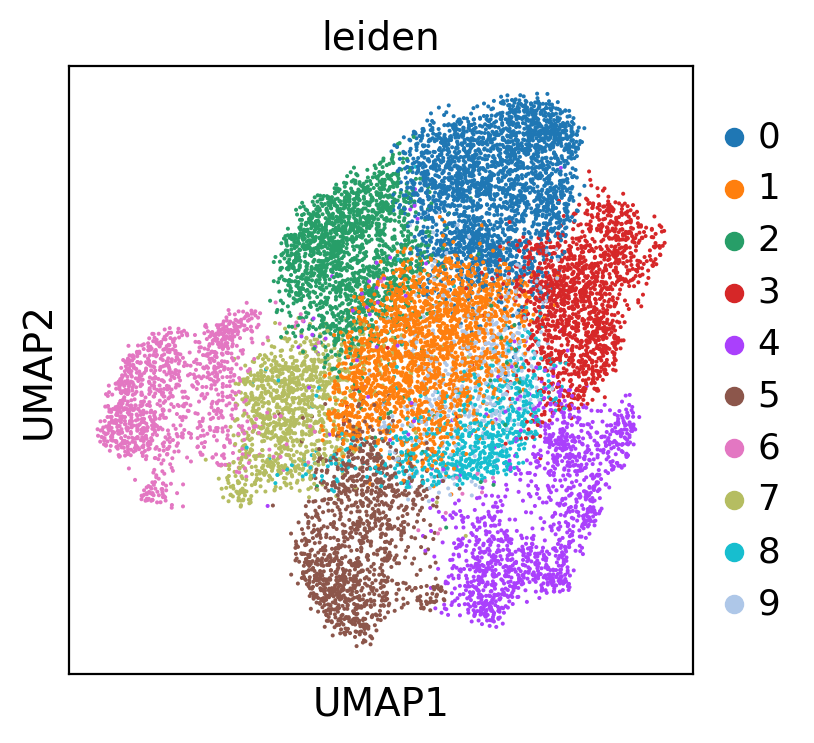

In [194]:
scjp.us(tdata,'leiden')

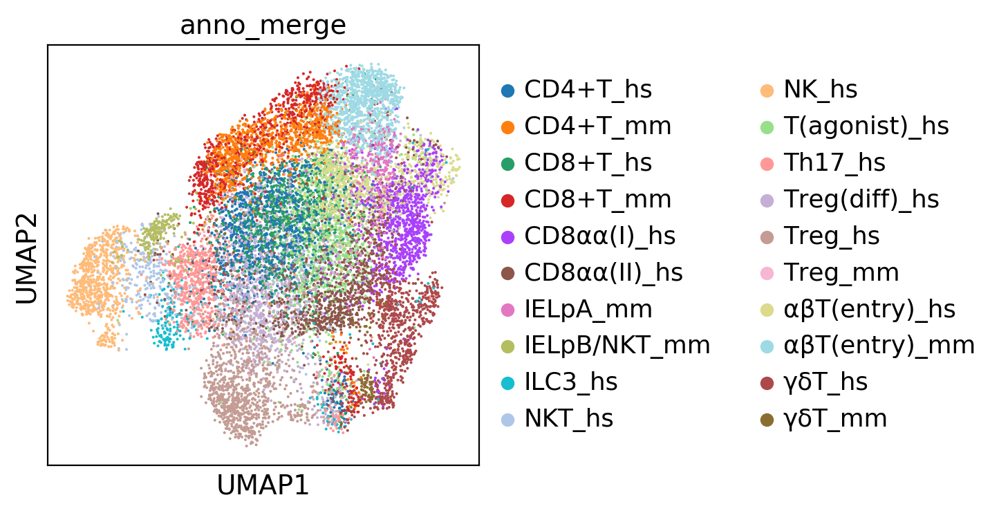

In [190]:
scjp.us(tdata,'anno_merge')

In [205]:
bdata,X = scjp.regress_iter(tdata,['name','Donor'],['leiden'],'Donor')

Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.` This will likely become the Scanpy default in the future.
computing PCA with n_comps = 50
    finished (0:00:00.47)
computing batch balanced neighbors
	finished (0:00:05.27) --> added to `.uns['neighbors']`
	'distances', weighted adjacency matrix
	'connectivities', weighted adjacency matrix


In [206]:
sc.tl.umap(bdata)

computing UMAP
    using 'X_pca' with n_pcs = 50
    finished (0:00:19.13) --> added
    'X_umap', UMAP coordinates (adata.obsm)


In [329]:
scjp.write(bdata,version,'mouse_human_mature_T_merged')

Only considering the two last: ['.A04', '.mouse_human_mature_T_merged'].
HTA08_v02_A04_mouse_human_mature_T_merged = 'HTA08.v02.A04.mouse_human_mature_T_merged'


In [749]:
bdata = sc.read('HTA08.v02.A04.mouse_human_mature_T_merged')

Only considering the two last: ['.A04', '.mouse_human_mature_T_merged'].


/home/ubuntu/.local/lib/python3.6/site-packages/anndata/readwrite/read.py:440: DeprecationWarning:

In a future version, read_h5ad will no longer explicitly support boolean arguments. Specify the read mode, or leave `backed=None`.



In [752]:
bdata.obs['species'] = list(bdata.obs['name'])
bdata.obs['cell types'] = list(bdata.obs['anno_merge'])

... storing 'species' as categorical
... storing 'cell types' as categorical


02_Output/HTA08.v02.A04.Fig_mouse_mature_T_species.pdf


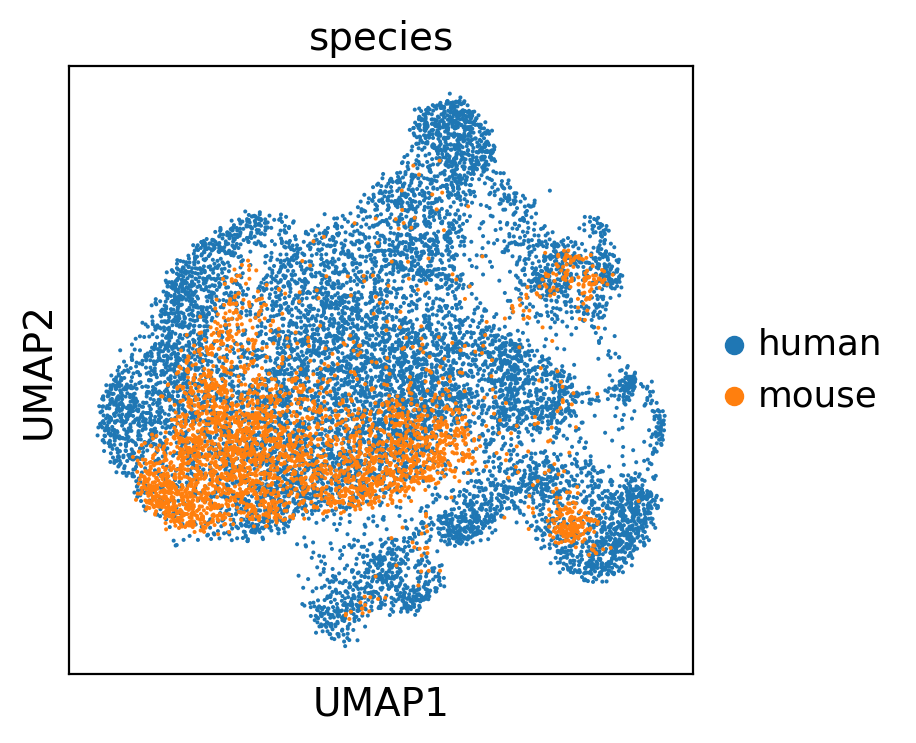

In [753]:
scjp.us(bdata,'species',show=False)
scjp.jp_save_fig(version,'Fig_mouse_mature_T_species',fig_folder=fig_folder)

02_Output/HTA08.v02.A04.Fig_mouse_mature_T_celltype.pdf


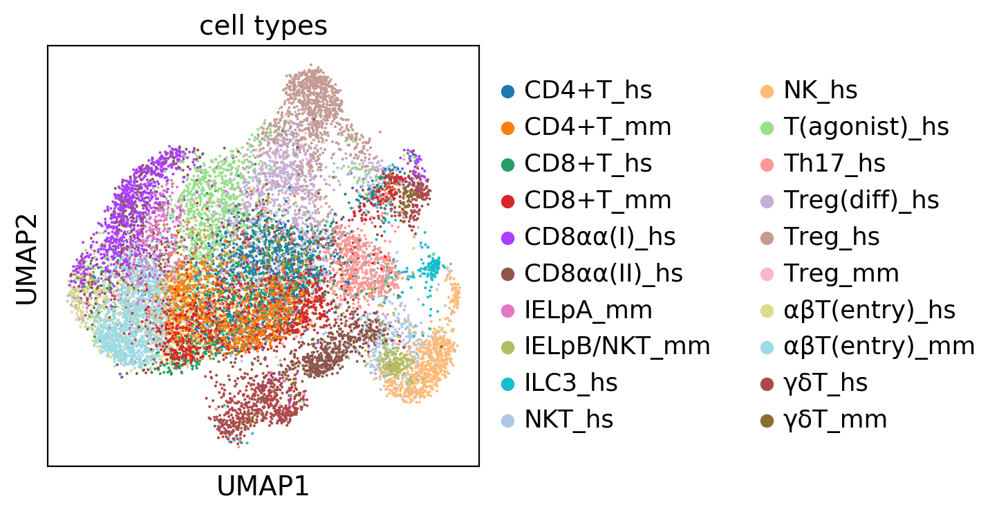

In [754]:
scjp.us(bdata,'cell types')
scjp.jp_save_fig(version,'Fig_mouse_mature_T_celltype',fig_folder=fig_folder)

02_Output/HTA08.v02.A04.Fig_mouse_mature_T_entry.pdf


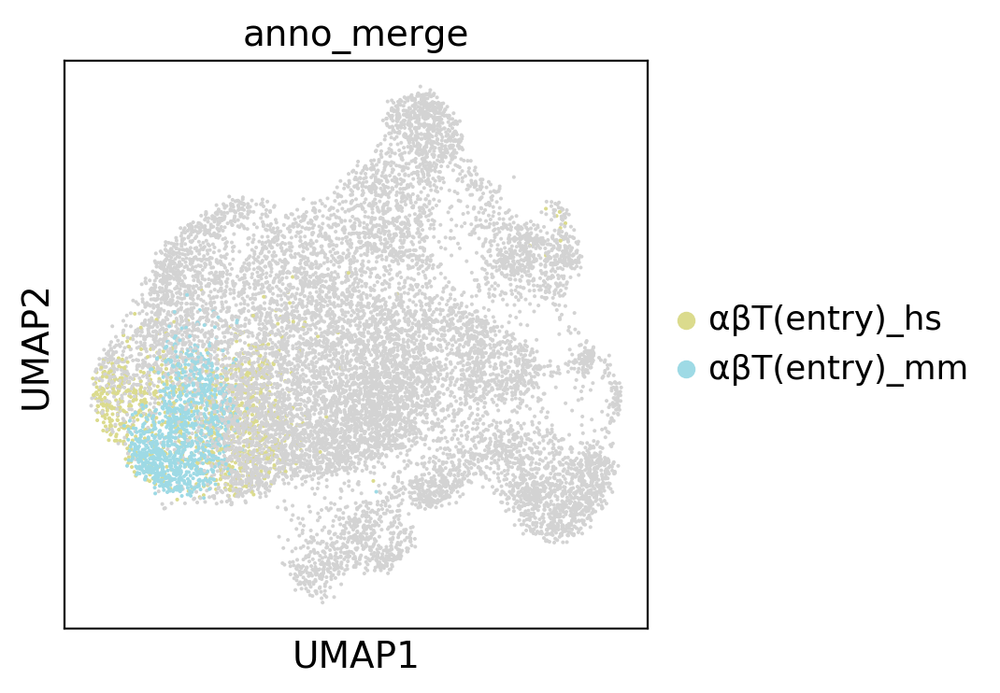

In [755]:
scjp.us(bdata,'anno_merge',groups=['αβT(entry)_hs',
 'αβT(entry)_mm',])
scjp.jp_save_fig(version,'Fig_mouse_mature_T_entry',fig_folder=fig_folder)

02_Output/HTA08.v02.A04.Fig_mouse_mature_T_naive.pdf


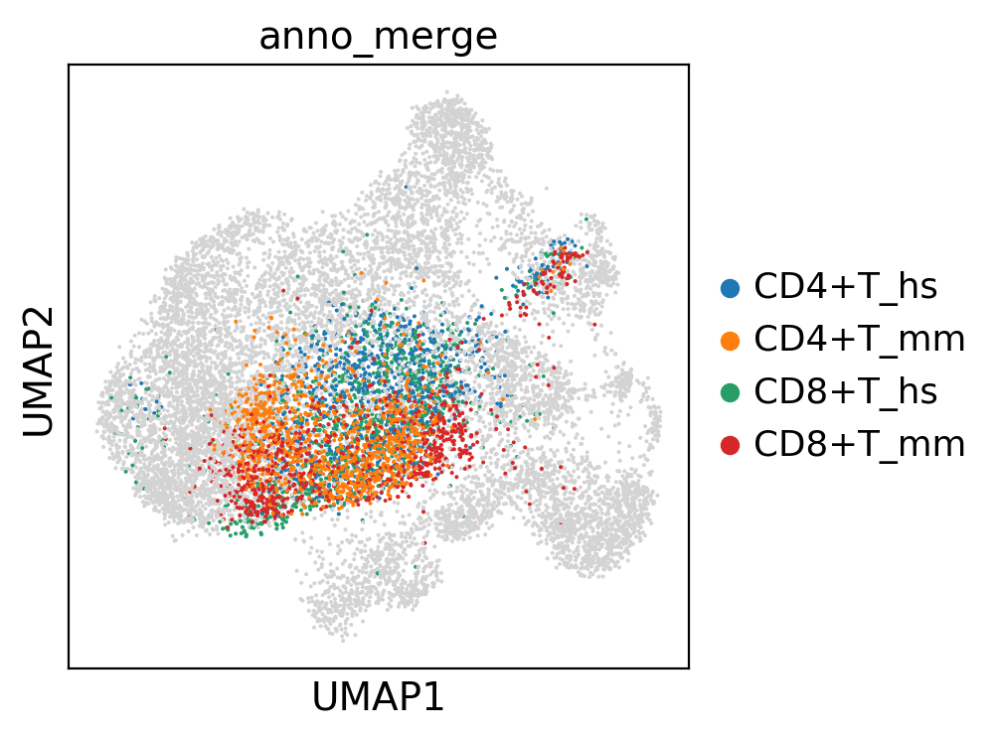

In [756]:
scjp.us(bdata,'anno_merge',groups=['CD4+T_hs',
 'CD4+T_mm',
 'CD8+T_hs',
 'CD8+T_mm',])
scjp.jp_save_fig(version,'Fig_mouse_mature_T_naive',fig_folder=fig_folder)

02_Output/HTA08.v02.A04.Fig_mouse_mature_T_reg.pdf


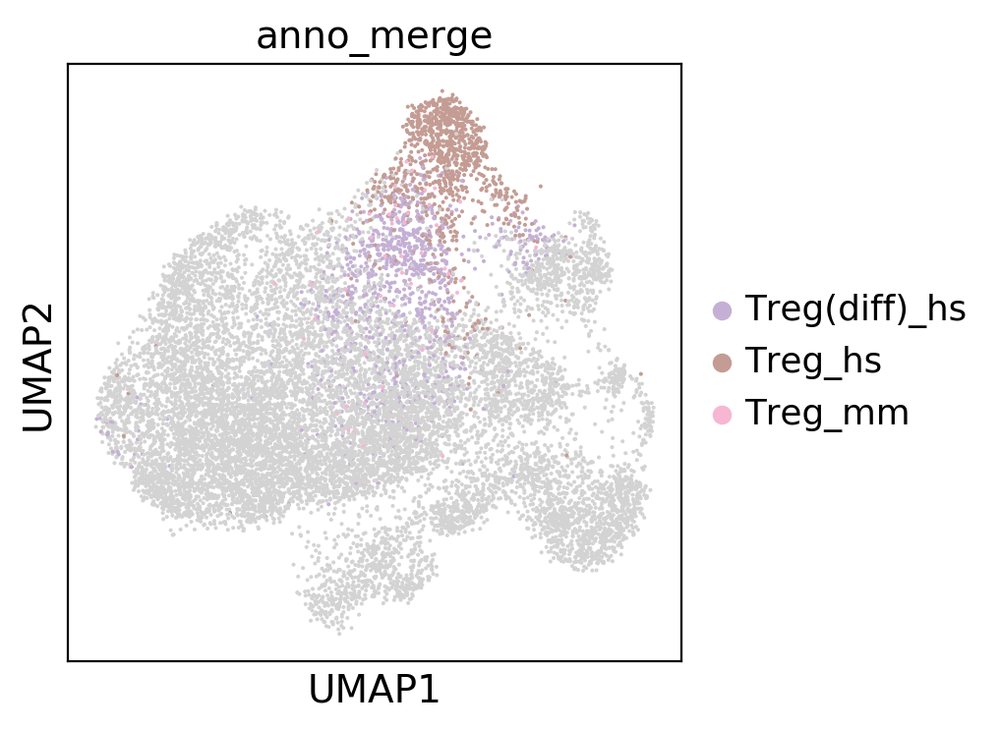

In [757]:
scjp.us(bdata,'anno_merge',groups=['Treg(diff)_hs',
 'Treg_hs',
 'Treg_mm',])
scjp.jp_save_fig(version,'Fig_mouse_mature_T_reg',fig_folder=fig_folder)

02_Output/HTA08.v02.A04.Fig_mouse_mature_T_IELpA.pdf


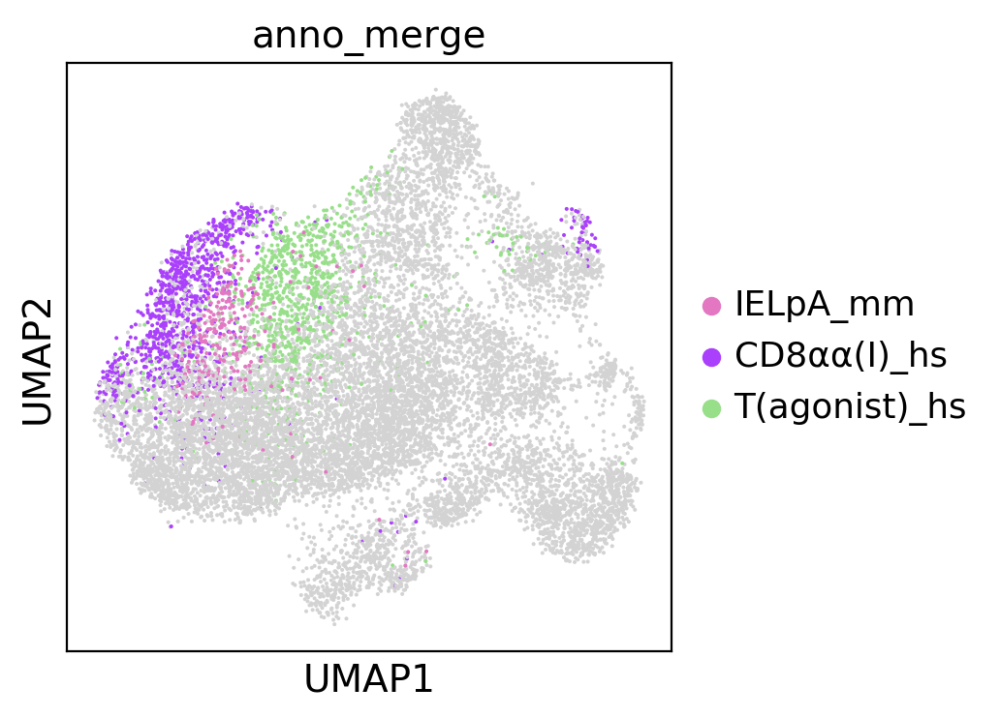

In [758]:
scjp.us(bdata,'anno_merge',groups=['IELpA_mm','CD8αα(I)_hs','T(agonist)_hs'])
scjp.jp_save_fig(version,'Fig_mouse_mature_T_IELpA',fig_folder=fig_folder)

02_Output/HTA08.v02.A04.Fig_mouse_mature_T_gd.pdf


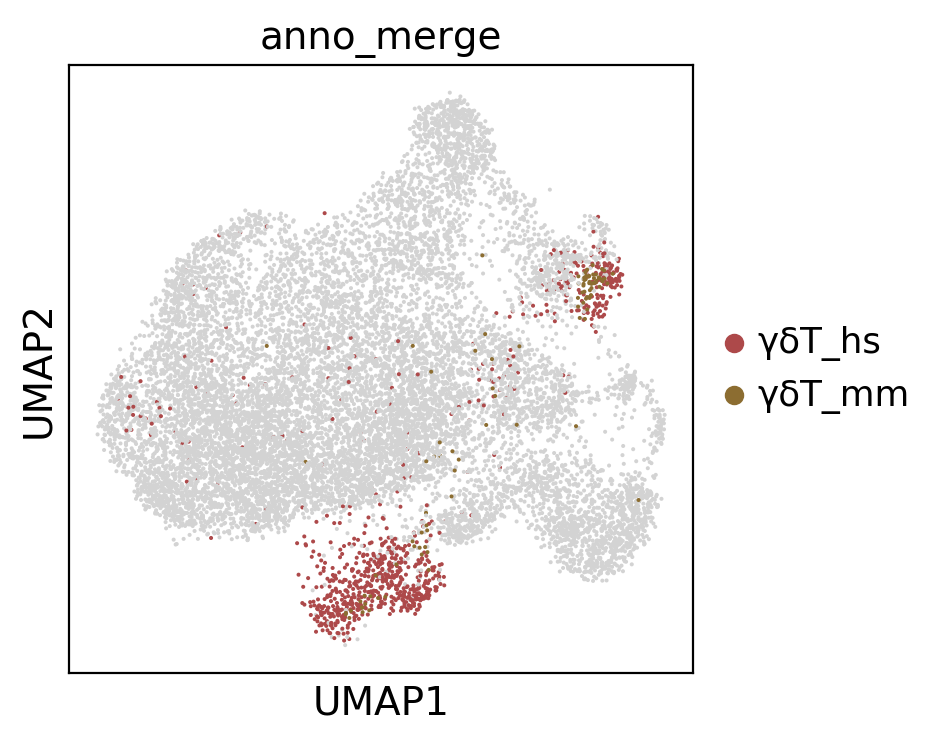

In [762]:
scjp.us(bdata,'anno_merge',groups=['γδT_hs',
 'γδT_mm',])
scjp.jp_save_fig(version,'Fig_mouse_mature_T_gd',fig_folder=fig_folder)

02_Output/HTA08.v02.A04.Fig_mouse_mature_T_NK.pdf


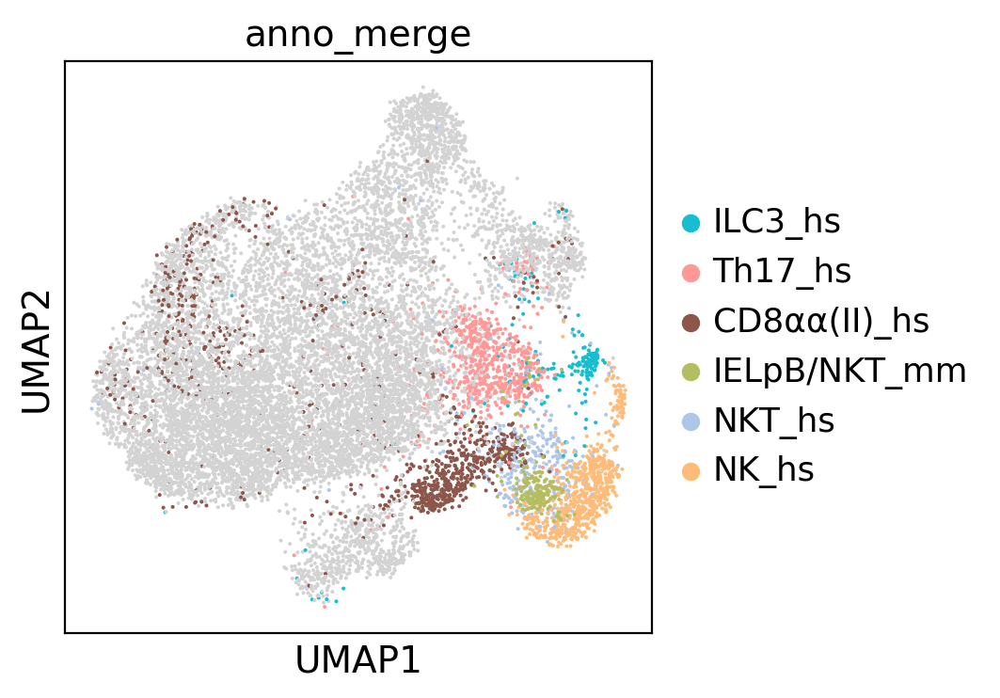

In [763]:
scjp.us(bdata,'anno_merge',groups=['ILC3_hs','Th17_hs',
 'CD8αα(II)_hs','IELpB/NKT_mm','NKT_hs','NK_hs'])
scjp.jp_save_fig(version,'Fig_mouse_mature_T_NK',fig_folder=fig_folder)

In [303]:
bdata.raw = tdata

In [809]:
cts = 'CD8αα(I)_hs,CD8+T_hs,IELpA_mm,CD8+T_mm'.split(',')

In [810]:
T_tnfrsf9 = bdata[bdata.obs['anno_merge'].isin(cts)]

02_Output/HTA08.v02.A04.Fig_mouse_mature_violon_1.pdf


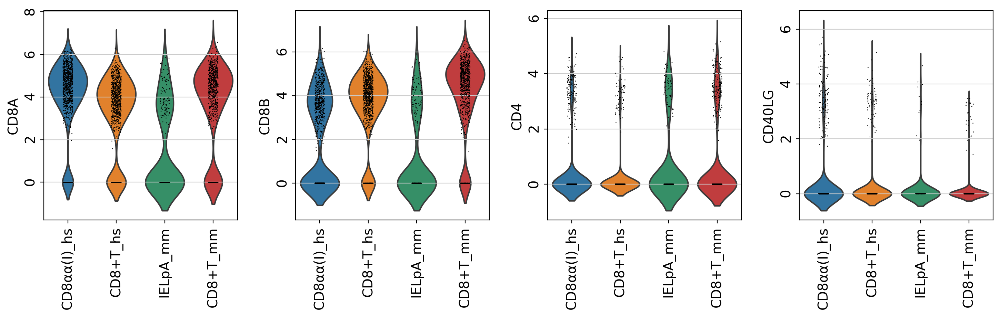

In [819]:
sc.pl.violin(T_tnfrsf9,'CD8A,CD8B,CD4,CD40LG'.split(','),groupby='cell types',use_raw=True,
             order= cts,rotation=90,show=False)
scjp.jp_save_fig(version,'Fig_mouse_mature_violon_1',fig_folder=fig_folder)

02_Output/HTA08.v02.A04.Fig_mouse_mature_violon_2.pdf


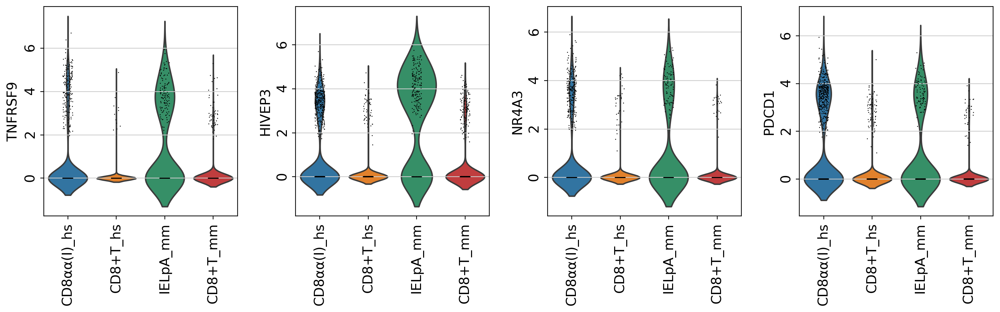

In [818]:
sc.pl.violin(T_tnfrsf9,'TNFRSF9,HIVEP3,NR4A3,PDCD1'.split(','),groupby='cell types',use_raw=True,
             order=cts,rotation=90,show=False)
scjp.jp_save_fig(version,'Fig_mouse_mature_violon_2',fig_folder=fig_folder)

02_Output/HTA08.v02.A04.Fig_mouse_mature_violon_3.pdf


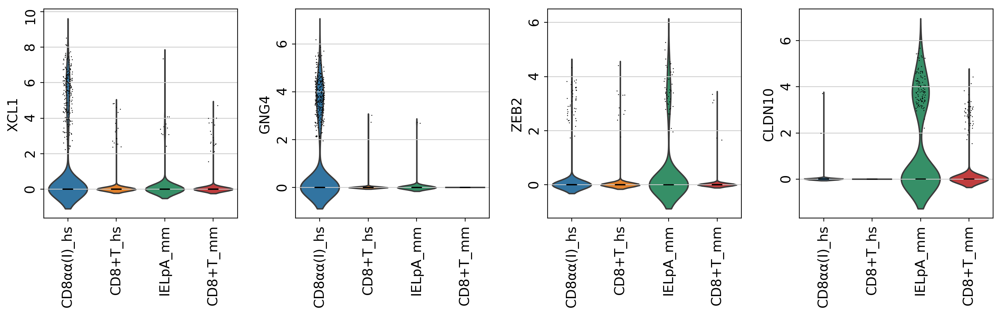

In [817]:
sc.pl.violin(T_tnfrsf9,'XCL1,GNG4,ZEB2,CLDN10'.split(','),groupby='cell types',use_raw=True,
             order=cts,rotation=90,show=False)
scjp.jp_save_fig(version,'Fig_mouse_mature_violon_3',fig_folder=fig_folder)

## Run Seurat integrate

In [249]:
scjp.output_matrix_Seurat(tdata,version,'human_mouse',use_raw=False)

In [250]:
tdata.var['GeneID'] = tdata.var.index

Trying to set attribute `.var` of view, making a copy.


In [251]:
tdata.var.to_csv('HTA08.v02.A04.human_mouse.var.csv')

In [252]:
## Trying Seurat Anchor

In [253]:
%%R
library(Seurat)
library(Matrix)

In [254]:
%%R
my.matrix <- readMM(file = 'HTA08.v02.A04.human_mouse.mtx')
my.matrix <- t(my.matrix)

In [255]:
%%R
my.metadata <- read.csv('HTA08.v02.A04.human_mouse.meta.csv')
my.genes <- read.csv('HTA08.v02.A04.human_mouse.var.csv')

my.metadata$index <-my.metadata$X

rownames(my.matrix) <- my.genes$GeneID
colnames(my.matrix) <- my.metadata$index
rownames(my.metadata) <- my.metadata$index

mca <- CreateSeuratObject(counts = my.matrix, meta.data = my.metadata, project = "show")

In [352]:
%%R
mca.list <- SplitObject(object = mca, split.by = "bbk")

In [353]:
%%R
mca.list

$Newcastle3GEX
An object of class Seurat 
15664 features across 2930 samples within 1 assay 
Active assay: RNA (15664 features)

$Newcastle5GEX
An object of class Seurat 
15664 features across 7833 samples within 1 assay 
Active assay: RNA (15664 features)

$`n/a`
An object of class Seurat 
15664 features across 3397 samples within 1 assay 
Active assay: RNA (15664 features)



In [354]:
%%R
for (i in 1:length(x = mca.list)) {
    #mca.list[[i]] <- NormalizeData(object = mca.list[[i]], verbose = FALSE)
    mca.list[[i]] <- FindVariableFeatures(object = mca.list[[i]], 
        selection.method = "vst", nfeatures = 2000, verbose = FALSE)
}


In [355]:
%%R
#reference.list <- mca.list[c('F675GEX', 'F343GEX', 'P33GEX', 'F223GEX', 'F415GEX', 'F413GEX', 'C33GEX', 'F233GEX', 'A163GEX', 'P23GEX', 'F383GEX', 'F333GEX', 'F323GEX', 'C113GEX', 'F645GEX', 'A165GEX', 'F293GEX', 'F305GEX', 'F455GEX', 'F453GEX', 'P13GEX', 'F213GEX', 'F353GEX', '284C3GEX', 'F385GEX', '302C3GEX', '310B3GEX', 'F295GEX', 'F373GEX', 'F303GEX')]
#reference.list <- mca.list[c('P33GEX', 'F223GEX', 'F415GEX', 'F305GEX', 'A163GEX', 'P23GEX', 'A165GEX', 'F303GEX', '284C3GEX')]
reference.list <- mca.list[c('Newcastle3GEX','Newcastle5GEX','n/a')]
mca.anchors <- FindIntegrationAnchors(object.list = reference.list, dims = 1:30)

R[write to console]: Computing 2000 integration features

R[write to console]: Scaling features for provided objects

R[write to console]: Finding all pairwise anchors

R[write to console]: Running CCA

R[write to console]: Merging objects

R[write to console]: Finding neighborhoods

R[write to console]: Finding anchors

R[write to console]: 	Found 11074 anchors

R[write to console]: Filtering anchors

R[write to console]: 	Retained 4673 anchors

R[write to console]: Extracting within-dataset neighbors

R[write to console]: Running CCA

R[write to console]: Merging objects

R[write to console]: Finding neighborhoods

R[write to console]: Finding anchors

R[write to console]: 	Found 9354 anchors

R[write to console]: Filtering anchors

R[write to console]: 	Retained 2418 anchors

R[write to console]: Extracting within-dataset neighbors

R[write to console]: Running CCA

R[write to console]: Merging objects

R[write to console]: Finding neighborhoods

R[write to console]: Finding anchors

In [356]:
%%R
mca.integrated <- IntegrateData(anchorset = mca.anchors, dims = 1:30)

R[write to console]: Merging dataset 1 into 2

R[write to console]: Extracting anchors for merged samples

R[write to console]: Finding integration vectors

R[write to console]: Finding integration vector weights

R[write to console]: 0%   10   20   30   40   50   60   70   80   90   100%

R[write to console]: [----|----|----|----|----|----|----|----|----|----|

R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to con

In [357]:
%%R
saveRDS(mca.integrated, file = "my.rds")

In [358]:
%%R
library(ggplot2)
library(cowplot)
# switch to integrated assay. The variable features of this assay are
# automatically set during IntegrateData
DefaultAssay(object = mca.integrated) <- "integrated"

In [359]:
%%R
# Run the standard workflow for visualization and clustering
mca.integrated <- ScaleData(object = mca.integrated, verbose = FALSE)
mca.integrated <- RunPCA(object = mca.integrated, npcs = 30, verbose = FALSE)

In [360]:
%%R
saveRDS(mca.integrated, file = "my.rds")

## R notebook -> run UMAP

In [361]:
%%R
mca_umap <- readRDS(file='my_umap_tdata.rds')

In [362]:
%%R -o embeds
embeds = Embeddings(mca_umap[['umap']])

In [363]:
tdata.obsm['X_umap_Seurat'] = embeds

In [364]:
tdata.obsm['X_umap'] = tdata.obsm['X_umap_Seurat']

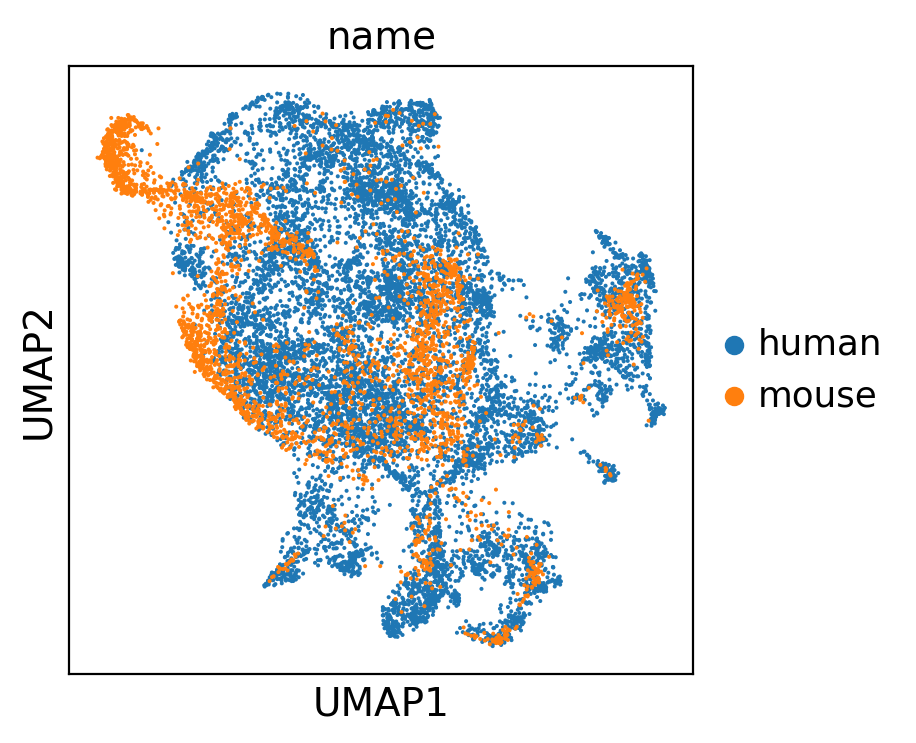

In [376]:
scjp.us(tdata,'name')

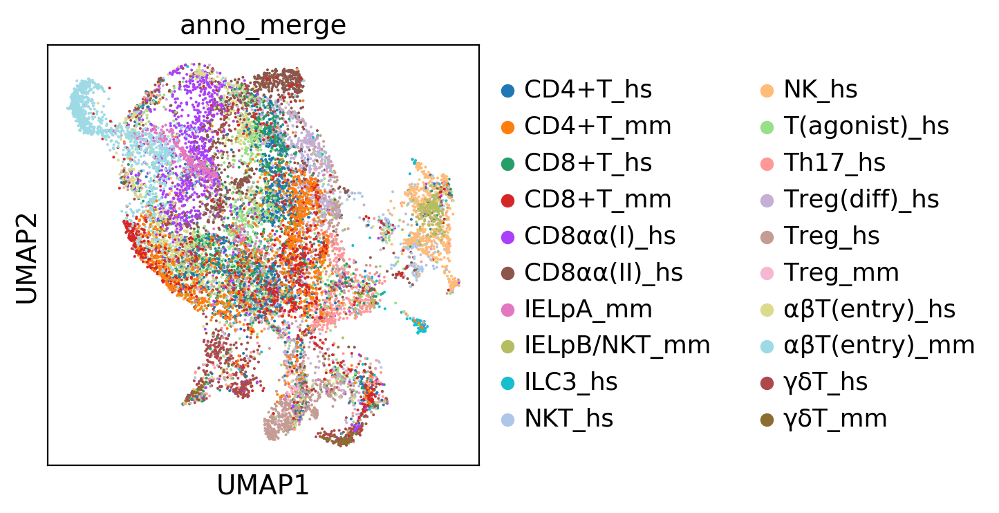

In [367]:
scjp.us(tdata,'anno_merge')

## make humanised mouse data

In [400]:
humanised_names = [species.mouse_to_human(x) for x in mm.raw.var_names]

In [401]:
mm_h = sc.AnnData(mm.raw.X,var=mm.raw.var,obs=mm.obs)

In [402]:
mm_h.var_names = humanised_names

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [403]:
mm_h.raw = mm_h

In [404]:
mm_c, hs_c = model.get_common_var_raw(mm_h,hs)

calculating a...
calculating b...


In [405]:
ido = mm_c[mm_c.obs['name']=='ido']

In [406]:
mm_strom = ido[~ido.obs['anno_level_14'].isin('Epi_PAX8,TEC_Cldn10,Mac,Immune,Ery,Epi(lung),cTEC(cycling),muscle'.split(','))]

In [407]:
strom_list = ['Fb_1', 'Fb_2', 'cTEC',
 'mTEC','VSMC','TEC(myo)',
 'TEC(neuro)','Lymph','Endo']

In [408]:
c1 = hs_c.obs['anno_final_v1'].isin(strom_list)
c2 = hs_c.obs['Stage'].isin('F1,F2,F3,F4,P1'.split(','))

hs_strom = hs_c[c1&c2]

In [411]:
hs_strom.obs['anno_merge'] = [x+'_hs' for x in hs_strom.obs['anno_final_v8']]
mm_strom.obs['anno_merge'] = [x+'_mm' for x in mm_strom.obs['anno_level_14']]

Trying to set attribute `.obs` of view, making a copy.
Trying to set attribute `.obs` of view, making a copy.


In [412]:
ad = {}
ad['hs'] = hs_strom
ad['mm'] = mm_strom

In [413]:
strom = scjp.merge_matrix(ad)

25885
Sample
n_counts
n_genes
donor
organ
sort
method
file
mito
doublet_scores
predicted_doublets
name
source
birth
batch
bbk
Donor
Order
Age
Gender
Source
Stage
Stage2
Cycle_score
isCycle
scrublet_doublets
is_Fig1
is_file_Fig1
true_doublets
missed_doublets_scbl
missed_doublets_jp
anno_doublet_4_scores
anno_doublet_5_scores
anno_doublet_6_scores
anno_doublet_7_scores
anno_doublet_8_scores
anno_doublet_T_scores
dbl_jp_method
broad_doublets
anno_pred
anno_fig1_detailed.replaced.1
anno_fig1_detailed
anno_predict_B
anno_predict_fig1.replaced.1
anno_predict_fig1
anno_final_v1
anno_final_v2_epi
donor_method
factor
anno_final_v3
anno_final_v4
anno_final_v5
anno_final_v6
anno_final_v7
anno_final_v8
is_TRA_fl
is_TRB_fl
is_TRA_np
is_TRB_np
VDJ_TRAJ54
VDJ_TRAV25
VDJ_TRAJ22
VDJ_TRAV8-2
VDJ_TRBV6-9
VDJ_TRBV4-3
VDJ_TRAV8-1
VDJ_TRAV17
VDJ_TRAJ4
VDJ_TRAV29DV5
VDJ_TRAJ26
VDJ_TRAV5
VDJ_TRBV12-4
VDJ_TRAJ39
VDJ_TRAJ15
VDJ_TRBV4-2
VDJ_TRAJ17
VDJ_TRAJ27
VDJ_TRAV4
VDJ_TRBV11-3
VDJ_TRAV26-2
VDJ_TRAJ10
VDJ_TRA

## mouse to human

creating lr model...


/home/ubuntu/.local/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning:

Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.

/home/ubuntu/.local/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:469: FutureWarning:

Default multi_class will be changed to 'auto' in 0.22. Specify the multi_class option to silence this warning.



making lr prediction...


Trying to set attribute `.obs` of view, making a copy.


updating lr to adata...


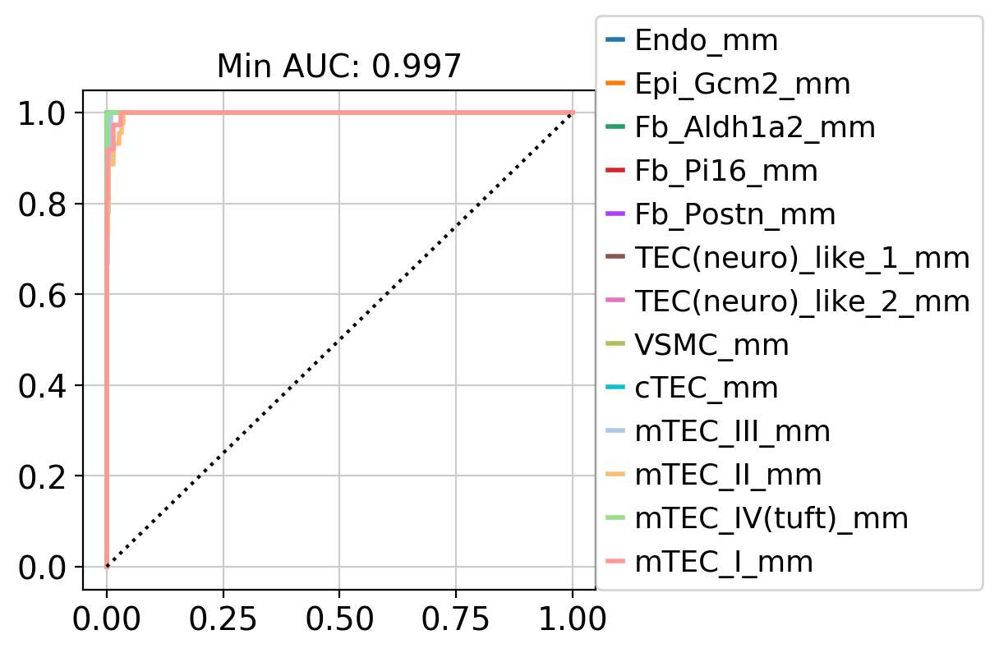

In [414]:
lr_mouse = model.transfer_annotation_jp(strom[strom.obs['name']=='mm'],'anno_merge',
                                       strom[strom.obs['name']=='hs'],'anno_pred',raw=False)

In [415]:
proba_MtH = lr_mouse.predict_proba(strom.X)

In [416]:
a = proba_MtH[strom.obs['anno_merge']=='Fb_2_hs'].mean(axis=0)
b = lr_mouse.classes_

sorted([(b1,a1) for a1,b1 in zip(a,b)],key=lambda x:-x[1])

[('Fb_Pi16_mm', 0.9239076702833853),
 ('cTEC_mm', 0.05897181841190679),
 ('Fb_Postn_mm', 0.007799537937468792),
 ('mTEC_II_mm', 0.004112359516307998),
 ('mTEC_I_mm', 0.0018124483183670503),
 ('Fb_Aldh1a2_mm', 0.001248217579273639),
 ('VSMC_mm', 0.0011406594461399312),
 ('Endo_mm', 0.0005305200604704161),
 ('TEC(neuro)_like_2_mm', 0.0002488910261962435),
 ('Epi_Gcm2_mm', 0.00019183237724166284),
 ('mTEC_IV(tuft)_mm', 2.1179864838643874e-05),
 ('TEC(neuro)_like_1_mm', 1.4504772291422682e-05),
 ('mTEC_III_mm', 3.604061125490642e-07)]

## human to mouse

creating lr model...
making lr prediction...


Trying to set attribute `.obs` of view, making a copy.


updating lr to adata...


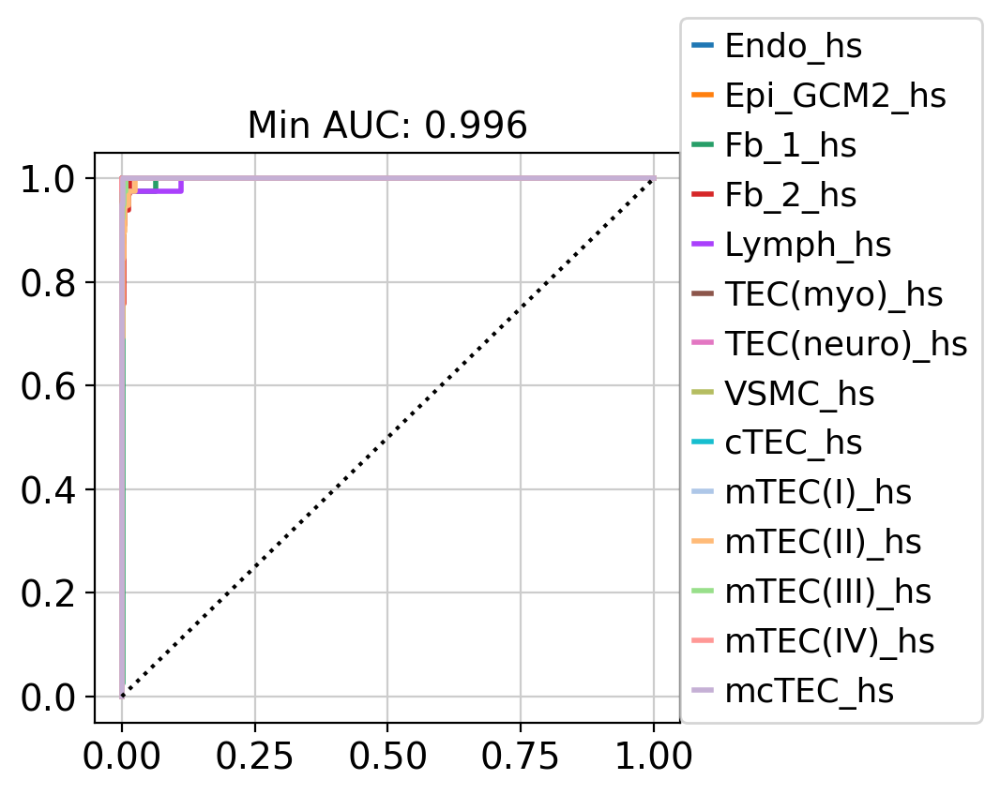

In [417]:
c1 = strom.obs['name']=='hs'
lr_human = model.transfer_annotation_jp(strom[c1],'anno_merge',
                                       strom[strom.obs['name']=='mm'],'anno_pred',
                                        raw=False,exclude=['TEC(cycling)_hs'])

In [418]:
proba_HtM = lr_human.predict_proba(strom.X)

In [419]:
a = proba_HtM[strom.obs['anno_merge']=='TEC(neuro)_like_2_mm'].mean(axis=0)
b = lr_human.classes_

sorted([(b1,a1) for a1,b1 in zip(a,b)],key=lambda x:-x[1])

[('mTEC(II)_hs', 0.20666111351087077),
 ('mTEC(IV)_hs', 0.16319625095266735),
 ('mTEC(III)_hs', 0.13720596126891346),
 ('TEC(neuro)_hs', 0.07843080008636216),
 ('Epi_GCM2_hs', 0.07700549270800645),
 ('Lymph_hs', 0.07183023639962538),
 ('cTEC_hs', 0.05198917874766316),
 ('Endo_hs', 0.0418669096388838),
 ('TEC(myo)_hs', 0.041166564092891655),
 ('VSMC_hs', 0.03266478407142411),
 ('mTEC(I)_hs', 0.032145316210758924),
 ('mcTEC_hs', 0.029377399933224156),
 ('Fb_2_hs', 0.026298078041803345),
 ('Fb_1_hs', 0.010161914336905352)]

In [420]:
HtM_mean_proba =[]
for mm_label in lr_mouse.classes_:
    HtM_mean_proba.append(proba_HtM[strom.obs['anno_merge']==mm_label].mean(axis=0))
HtM_mean_proba = np.vstack(HtM_mean_proba)  

In [421]:
MtH_mean_proba =[]
for hs_label in lr_human.classes_:
    MtH_mean_proba.append(proba_MtH[strom.obs['anno_merge']==hs_label].mean(axis=0))
MtH_mean_proba = np.vstack(MtH_mean_proba)      

In [422]:
HtM_mean_proba.shape

(13, 14)

In [423]:
MtH_mean_proba.shape

(14, 13)

In [424]:
lr_mouse.classes_

array(['Endo_mm', 'Epi_Gcm2_mm', 'Fb_Aldh1a2_mm', 'Fb_Pi16_mm',
       'Fb_Postn_mm', 'TEC(neuro)_like_1_mm', 'TEC(neuro)_like_2_mm',
       'VSMC_mm', 'cTEC_mm', 'mTEC_III_mm', 'mTEC_II_mm',
       'mTEC_IV(tuft)_mm', 'mTEC_I_mm'], dtype=object)

In [425]:
lr_human.classes_

array(['Endo_hs', 'Epi_GCM2_hs', 'Fb_1_hs', 'Fb_2_hs', 'Lymph_hs',
       'TEC(myo)_hs', 'TEC(neuro)_hs', 'VSMC_hs', 'cTEC_hs', 'mTEC(I)_hs',
       'mTEC(II)_hs', 'mTEC(III)_hs', 'mTEC(IV)_hs', 'mcTEC_hs'],
      dtype=object)

In [426]:
hs_order = [ 'Fb_1_hs', 'Fb_2_hs', 'VSMC_hs','Endo_hs', 'Lymph_hs', 'cTEC_hs','mcTEC_hs', 'mTEC(I)_hs', 'mTEC(II)_hs',
       'mTEC(III)_hs', 'mTEC(IV)_hs', 'TEC(myo)_hs','TEC(neuro)_hs']
hs_index = [list(lr_human.classes_).index(x) for x in hs_order]

In [427]:
mm_order = [ 'Fb_Pi16_mm', 'Fb_Postn_mm','Fb_Aldh1a2_mm', 'VSMC_mm','Endo_mm',
       'cTEC_mm','mTEC_I_mm', 'mTEC_II_mm',  'mTEC_III_mm','mTEC_IV(tuft)_mm', 'TEC(neuro)_like_1_mm',
            'TEC(neuro)_like_2_mm']
mm_index = [list(lr_mouse.classes_).index(x) for x in mm_order]

02_Output/HTA08.v02.A04.FigS1_epi_mouse_comp_HtM.pdf


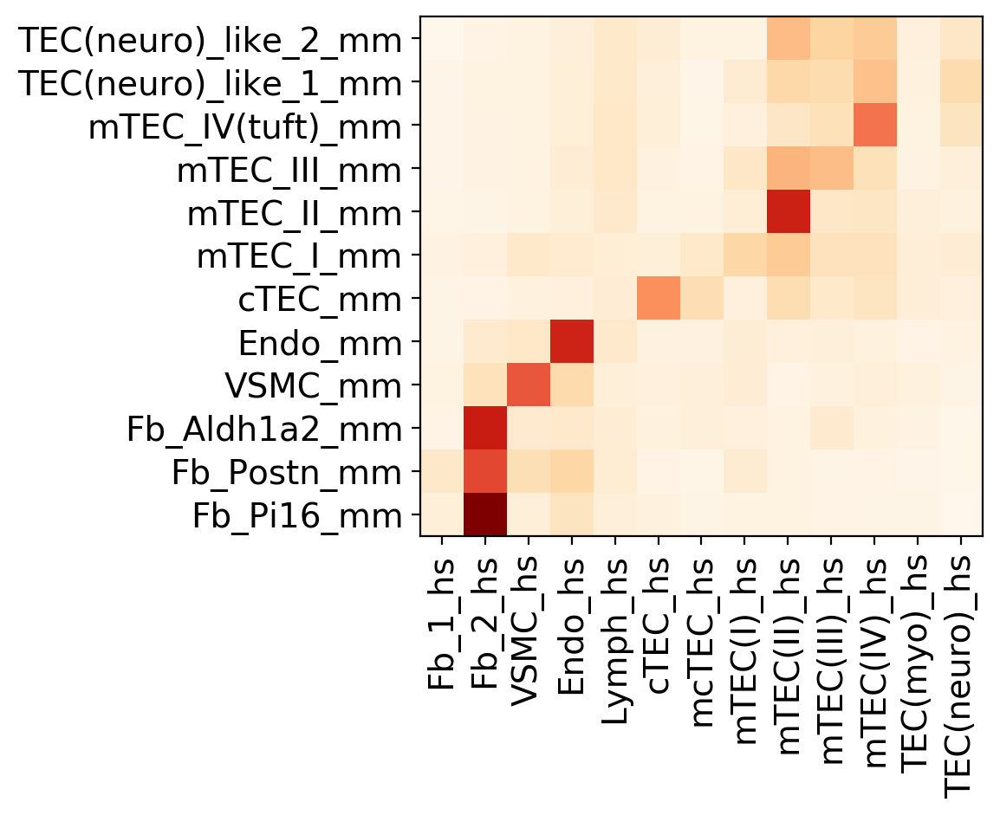

In [428]:
fig, ax = plt.subplots(figsize=(6,6))
im = ax.imshow(HtM_mean_proba[mm_index][:,hs_index])
plt.grid(False)

xlabel = lr_human.classes_[hs_index]
ylabel = lr_mouse.classes_[mm_index]

ax.set_xticks(np.arange(len(xlabel)))
ax.set_yticks(np.arange(len(ylabel)+1))

plt.ylim(-0.5,len(ylabel)-0.5)

ax.set_xticklabels(xlabel)
ax.set_yticklabels(ylabel)

plt.setp(ax.get_xticklabels(),rotation=90)

fig.tight_layout()
plt.grid(False)
scjp.jp_save_fig(version,'FigS1_epi_mouse_comp_HtM',fig_folder=fig_folder)

02_Output/HTA08.v02.A04.FigS1_epi_mouse_comp_MtH.pdf


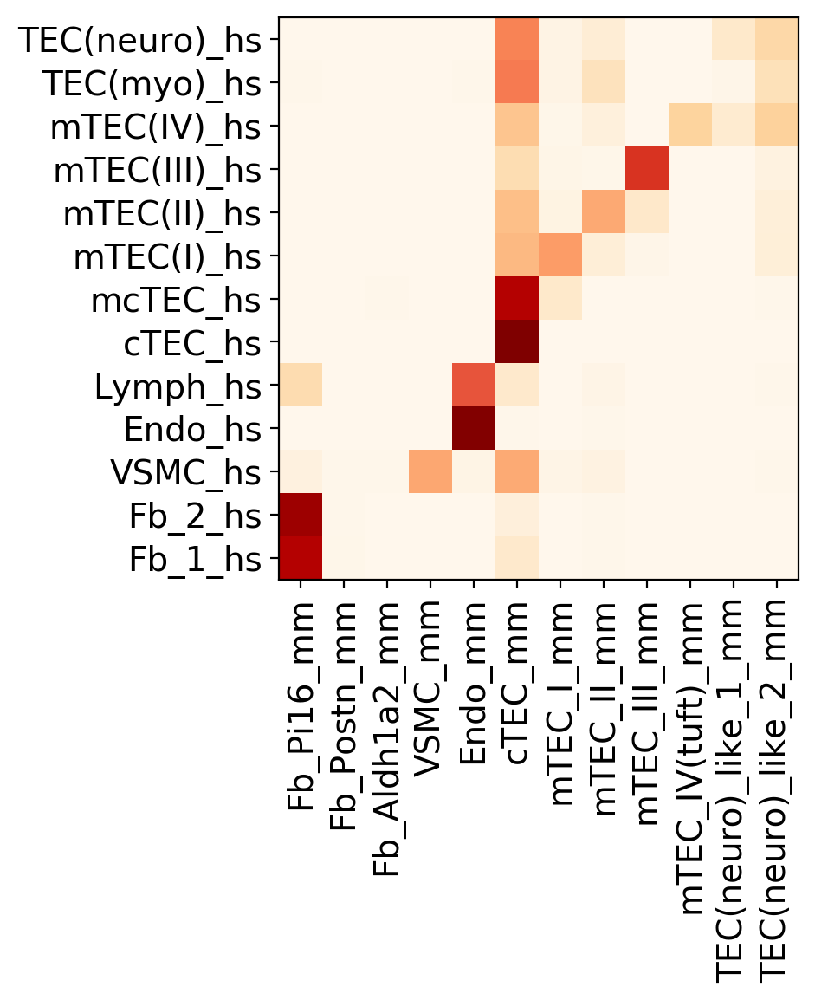

In [429]:
fig, ax = plt.subplots(figsize=(6,6))
im = ax.imshow(MtH_mean_proba[hs_index][:,mm_index])
plt.grid(False)

xlabel = lr_mouse.classes_[mm_index]
ylabel = lr_human.classes_[hs_index]

ax.set_xticks(np.arange(len(xlabel)))
ax.set_yticks(np.arange(len(ylabel)+1))

plt.ylim(-0.5,len(ylabel)-0.5)

ax.set_xticklabels(xlabel)
ax.set_yticklabels(ylabel)

plt.setp(ax.get_xticklabels(),rotation=90)

fig.tight_layout()
plt.grid(False)
scjp.jp_save_fig(version,'FigS1_epi_mouse_comp_MtH',fig_folder=fig_folder)

In [430]:
multi = MtH_mean_proba[hs_index][:,mm_index]*HtM_mean_proba[mm_index][:,hs_index].T

02_Output/HTA08.v02.A04.FigS1_epi_mouse_comp_multi.pdf


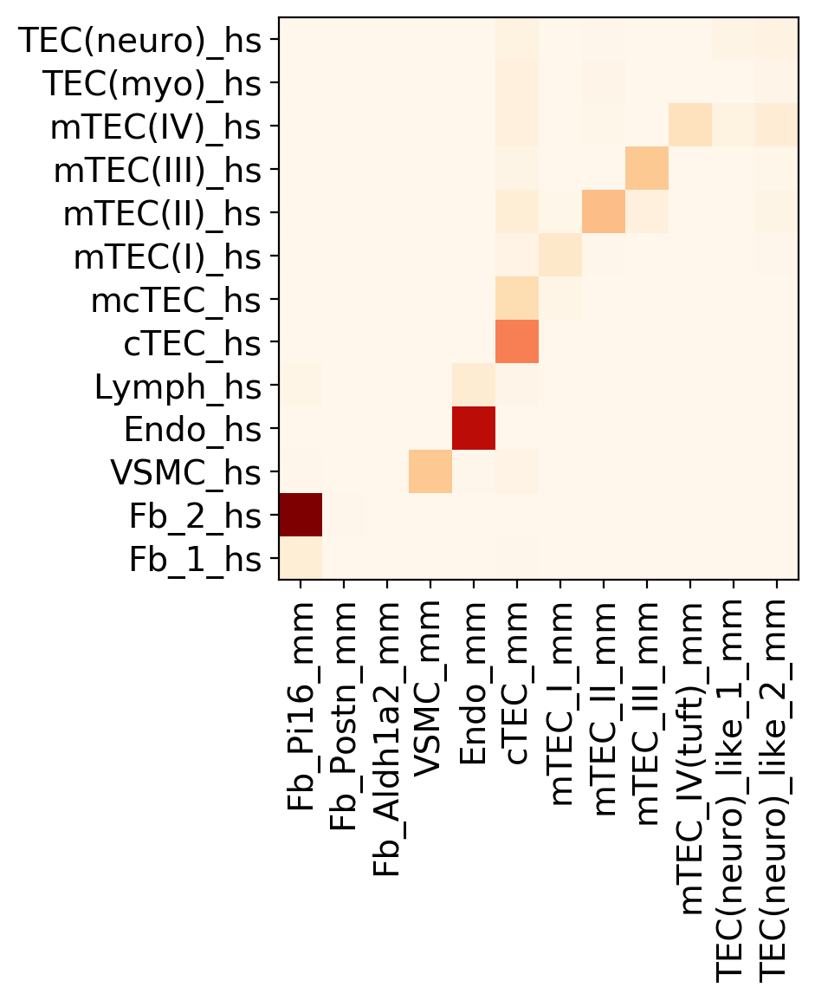

In [431]:
fig, ax = plt.subplots(figsize=(6,6))
im = ax.imshow(multi)
plt.grid(False)

xlabel = lr_mouse.classes_[mm_index]
ylabel = lr_human.classes_[hs_index]

ax.set_xticks(np.arange(len(xlabel)))
ax.set_yticks(np.arange(len(ylabel)+1))

plt.ylim(-0.5,len(ylabel)-0.5)

ax.set_xticklabels(xlabel)
ax.set_yticklabels(ylabel)

plt.setp(ax.get_xticklabels(),rotation=90)

fig.tight_layout()
plt.grid(False)
scjp.jp_save_fig(version,'FigS1_epi_mouse_comp_multi',fig_folder=fig_folder)

In [432]:
isTEC = ['mTEC(IV)_hs',
 'Epi_GCM2_hs',
 'Epi_Gcm2_mm',
'TEC(cycling)_hs',
 'TEC(myo)_hs',
 'TEC(neuro)_hs',
 'TEC(neuro)_like_1_mm',
 'TEC(neuro)_like_2_mm',
 'cTEC_hs',
 'cTEC_mm',
 'mTEC(I)_hs',
 'mTEC(II)_hs',
 'mTEC(III)_hs',
 'mTEC_III_mm',
 'mTEC_II_mm',
 'mTEC_IV(tuft)_mm',
 'mTEC_I_mm',
 'mcTEC_hs']

In [433]:
TEC = strom[strom.obs['anno_merge'].isin(isTEC)]

In [434]:
TEC.raw = TEC

In [711]:
TEC.obs['isTuft'] = TEC.obs['anno_merge'].isin('mTEC_IV(tuft)_mm,mTEC(IV)_hs'.split(','))
TEC.obs['ismTECI'] = TEC.obs['anno_merge'].isin('mTEC(I)_hs,mTEC_I_mm'.split(','))
TEC.obs['ismTECII'] = TEC.obs['anno_merge'].isin('mTEC(II)_hs,mTEC_II_mm'.split(','))
TEC.obs['ismcTEC'] = TEC.obs['anno_merge'].isin('mcTEC_hs,cTEC_mm'.split(','))
TEC.obs['isGCM2'] = TEC.obs['anno_merge'].isin('Epi_GCM2_hs,Epi_Gcm2_mm'.split(','))
TEC.obs['isNeuro2'] = TEC.obs['anno_merge'].isin('TEC(neuro)_hs,mTEC_II_mm'.split(','))
TEC.obs['isNeuro'] = TEC.obs['anno_merge'].isin('TEC(neuro)_hs,TEC(neuro)_like_1_mm,TEC(neuro)_like_2_mm'.split(','))
TEC.obs['isNeuro_tuft'] = TEC.obs['anno_merge'].isin('TEC(neuro)_hs,mTEC_IV(tuft)_mm'.split(','))
TEC.obs['ismyo'] = TEC.obs['anno_merge'].isin('TEC(myo)_hs,TEC(neuro)_like_1_mm,TEC(neuro)_like_2_mm'.split(','))
TEC.obs['ismyo2'] = TEC.obs['anno_merge'].isin('TEC(myo)_hs,mTEC_II_mm'.split(','))
TEC.obs['ismTECIII'] = TEC.obs['anno_merge'].isin('mTEC(III)_hs,mTEC_III_mm'.split(','))
TEC.obs['iscTEC'] = TEC.obs['anno_merge'].isin('cTEC_hs,cTEC_mm'.split(','))

In [714]:
TEC_hs = TEC[TEC.obs['name']=='hs']
TEC_hs.raw = TEC_hs

In [715]:
TEC_mm = TEC[TEC.obs['name']=='mm']
TEC_mm.raw = TEC_mm

In [ ]:
fc_tec = defaultdict(lambda : defaultdict())

In [716]:
for ct in ['isNeuro_tuft','ismyo','ismyo2']:
    print(ct)
    fc_tec[ct]['hs'] = markers.volcano_plot(TEC_hs,ct,True,False)
    fc_tec[ct]['mm'] = markers.volcano_plot(TEC_mm,ct,True,False)

isNeuro_tuft
ismyo
ismyo2


In [439]:
for ct in ['isTuft','ismTECI','ismcTEC','isGCM2','isNeuro','isNeuro2','iscTEC','ismTECII','ismTECIII','ismyo']:
    print(ct)
    fc_tec[ct]['hs'] = markers.volcano_plot(TEC_hs,ct,True,False)
    fc_tec[ct]['mm'] = markers.volcano_plot(TEC_mm,ct,True,False)

isTuft
ismTECI
ismcTEC
isGCM2
isNeuro
isNeuro2
iscTEC
ismTECII
ismTECIII
ismyo


/mnt/thymus_atlas/scjp/species.py:41: RuntimeWarning:

divide by zero encountered in log10

/mnt/thymus_atlas/scjp/species.py:42: RuntimeWarning:

divide by zero encountered in log10



02_Output/HTA08.v02.A04.FigS1_epi_isNeuro_tuft.pdf


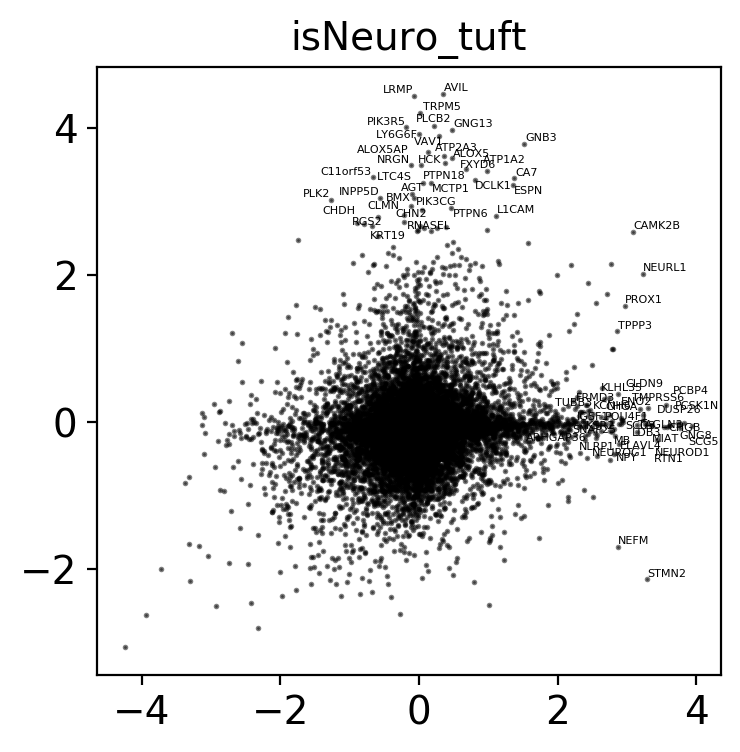

/mnt/thymus_atlas/scjp/species.py:41: RuntimeWarning:

divide by zero encountered in log10

/mnt/thymus_atlas/scjp/species.py:42: RuntimeWarning:

divide by zero encountered in log10



02_Output/HTA08.v02.A04.FigS1_epi_ismyo.pdf


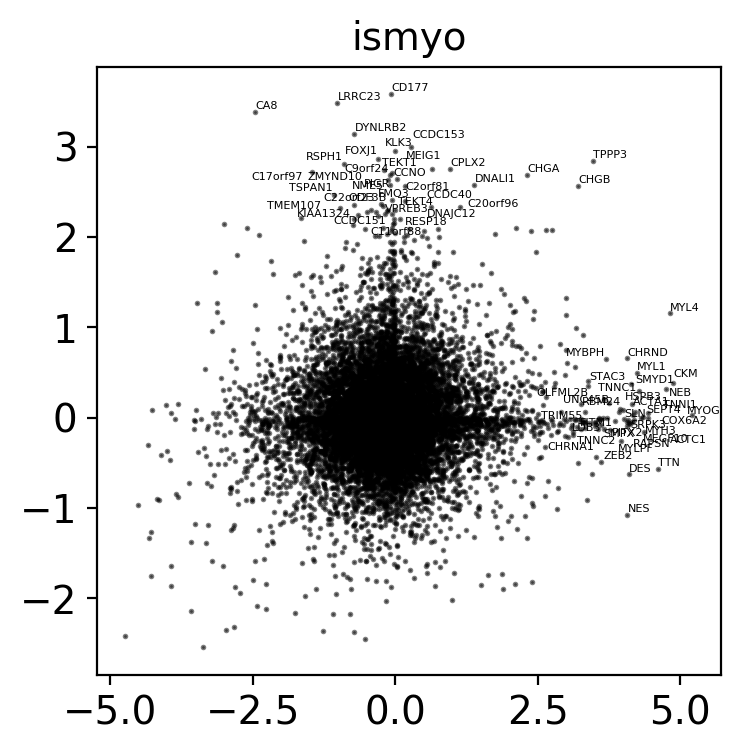

/mnt/thymus_atlas/scjp/species.py:41: RuntimeWarning:

divide by zero encountered in log10

/mnt/thymus_atlas/scjp/species.py:42: RuntimeWarning:

divide by zero encountered in log10



02_Output/HTA08.v02.A04.FigS1_epi_ismyo2.pdf


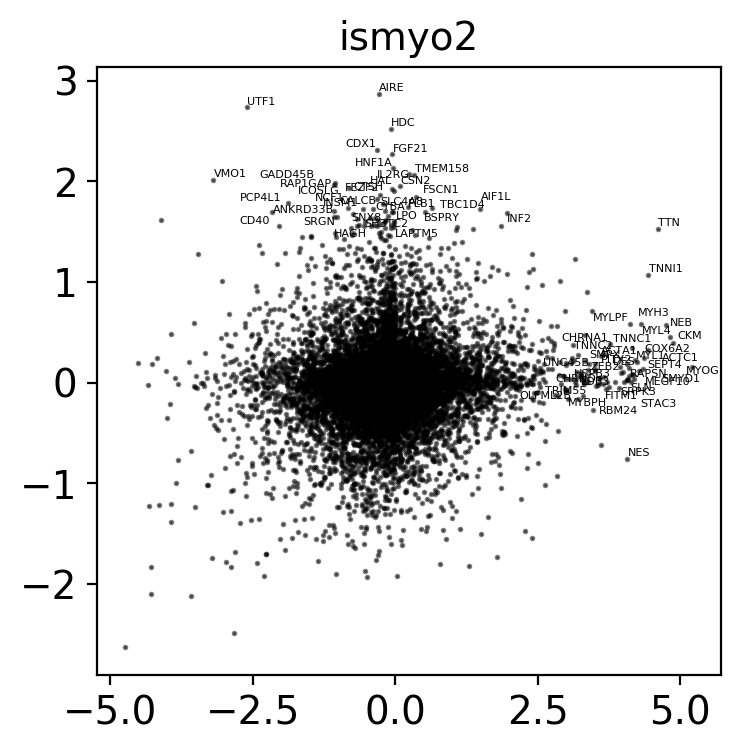

In [717]:
for ct in ['isNeuro_tuft','ismyo','ismyo2']:
    species.draw_scatter_speices_ct(ct,fc_tec,version,fig_folder,percentile_thres=99.75,adjust_lim=5)
   # scjp.jp_save_fig(version,'Fig_HM_'+ct,fig_folder=fig_folder)
    plt.show()

/mnt/thymus_atlas/scjp/species.py:41: RuntimeWarning:

divide by zero encountered in log10

/mnt/thymus_atlas/scjp/species.py:42: RuntimeWarning:

divide by zero encountered in log10



02_Output/HTA08.v02.A04.FigS1_epi_isTuft.pdf


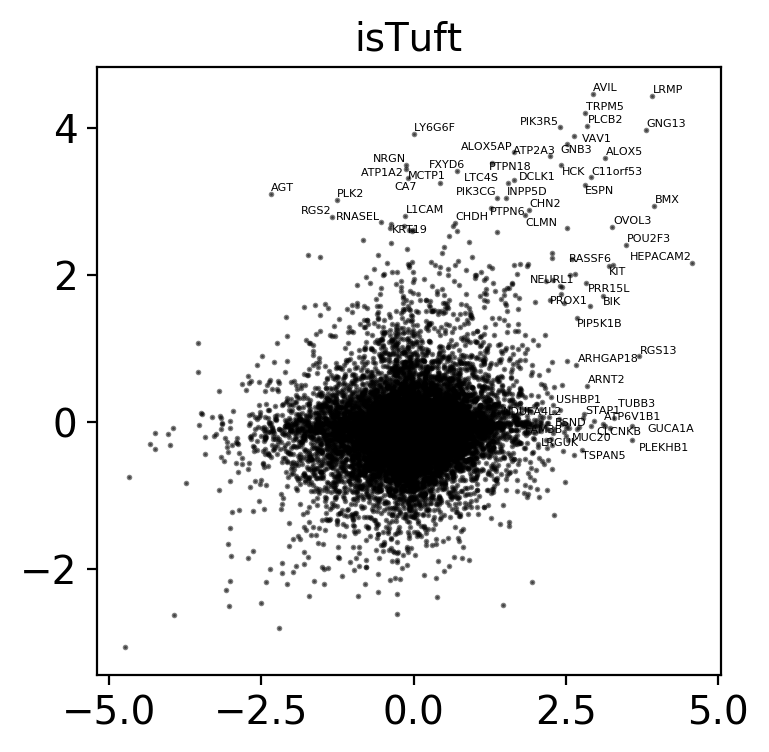

/mnt/thymus_atlas/scjp/species.py:41: RuntimeWarning:

divide by zero encountered in log10

/mnt/thymus_atlas/scjp/species.py:42: RuntimeWarning:

divide by zero encountered in log10



02_Output/HTA08.v02.A04.FigS1_epi_ismTECI.pdf


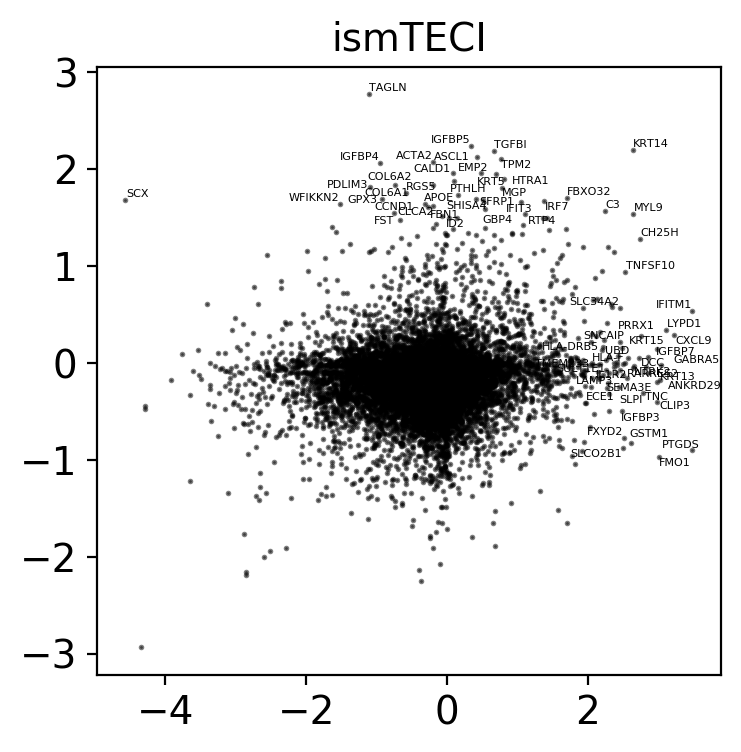

/mnt/thymus_atlas/scjp/species.py:41: RuntimeWarning:

divide by zero encountered in log10

/mnt/thymus_atlas/scjp/species.py:42: RuntimeWarning:

divide by zero encountered in log10



02_Output/HTA08.v02.A04.FigS1_epi_ismcTEC.pdf


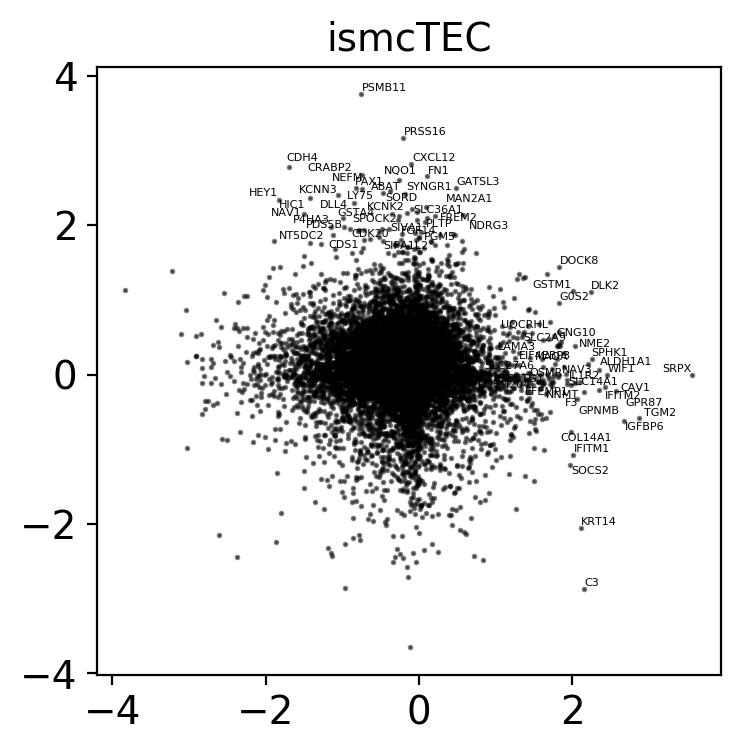

/mnt/thymus_atlas/scjp/species.py:41: RuntimeWarning:

divide by zero encountered in log10

/mnt/thymus_atlas/scjp/species.py:42: RuntimeWarning:

divide by zero encountered in log10



02_Output/HTA08.v02.A04.FigS1_epi_isGCM2.pdf


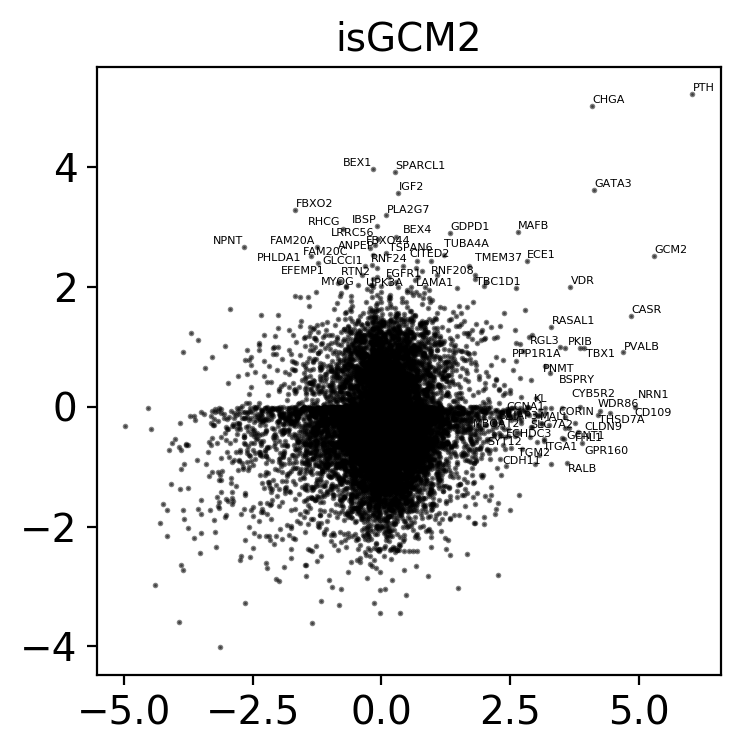

/mnt/thymus_atlas/scjp/species.py:41: RuntimeWarning:

divide by zero encountered in log10

/mnt/thymus_atlas/scjp/species.py:42: RuntimeWarning:

divide by zero encountered in log10



02_Output/HTA08.v02.A04.FigS1_epi_isNeuro.pdf


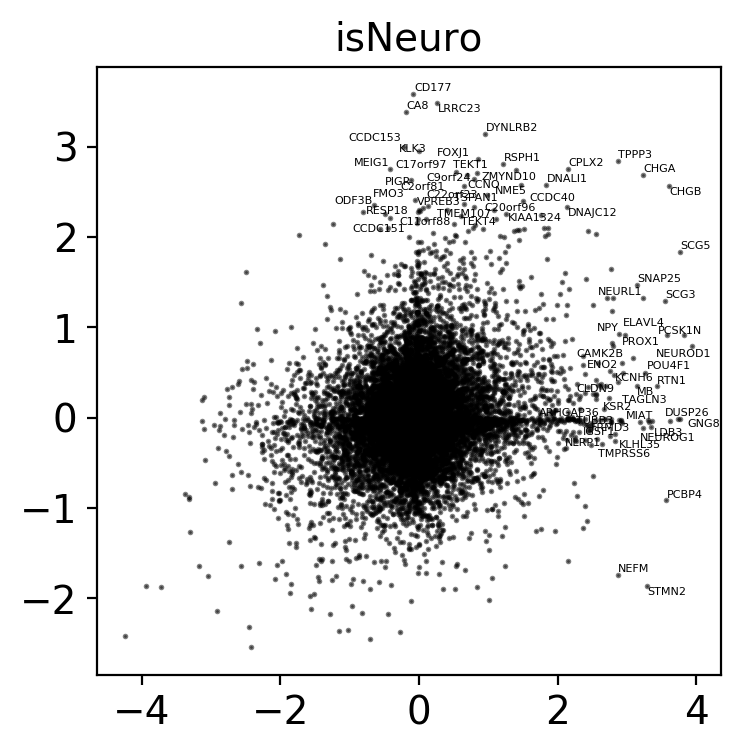

/mnt/thymus_atlas/scjp/species.py:41: RuntimeWarning:

divide by zero encountered in log10

/mnt/thymus_atlas/scjp/species.py:42: RuntimeWarning:

divide by zero encountered in log10



02_Output/HTA08.v02.A04.FigS1_epi_isNeuro2.pdf


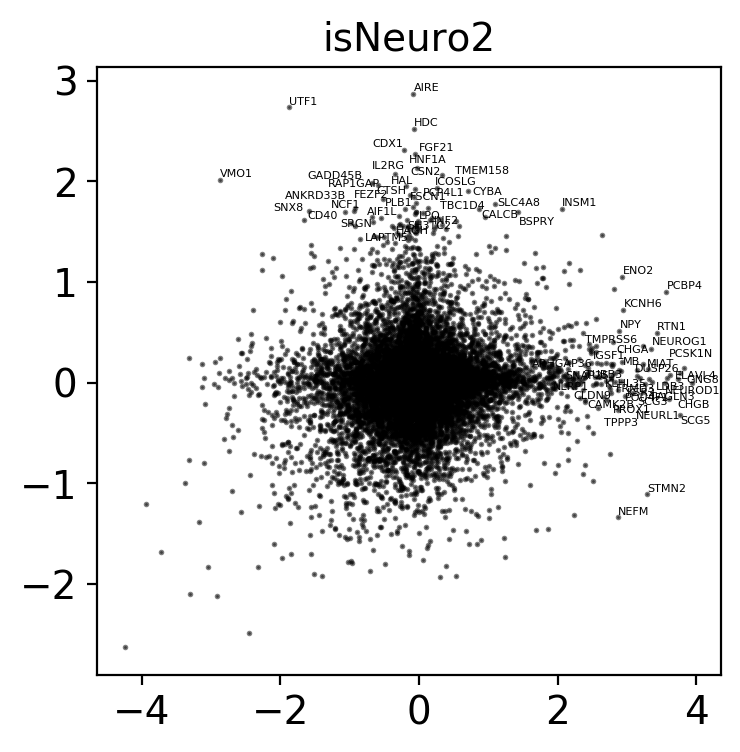

/mnt/thymus_atlas/scjp/species.py:41: RuntimeWarning:

divide by zero encountered in log10

/mnt/thymus_atlas/scjp/species.py:42: RuntimeWarning:

divide by zero encountered in log10



02_Output/HTA08.v02.A04.FigS1_epi_iscTEC.pdf


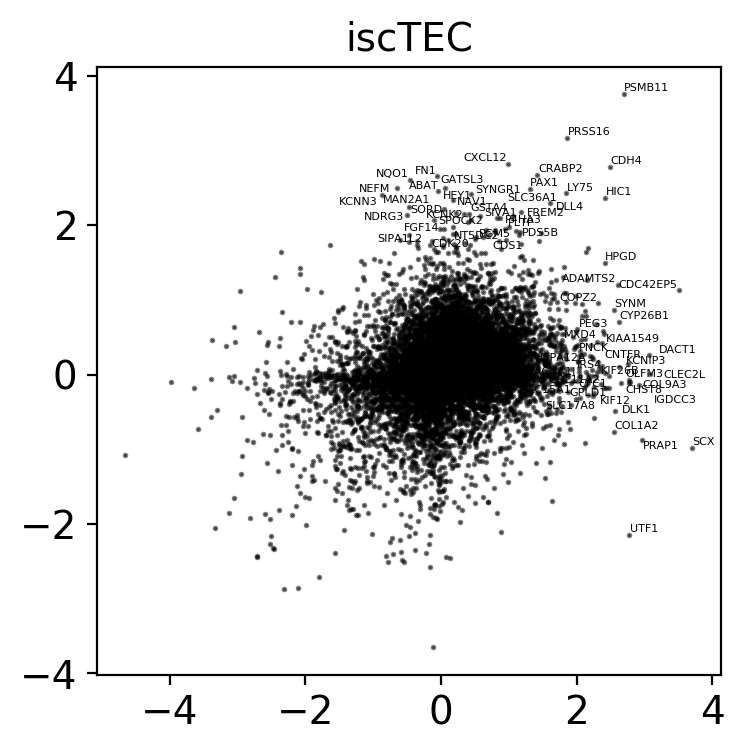

/mnt/thymus_atlas/scjp/species.py:41: RuntimeWarning:

divide by zero encountered in log10

/mnt/thymus_atlas/scjp/species.py:42: RuntimeWarning:

divide by zero encountered in log10



02_Output/HTA08.v02.A04.FigS1_epi_ismTECII.pdf


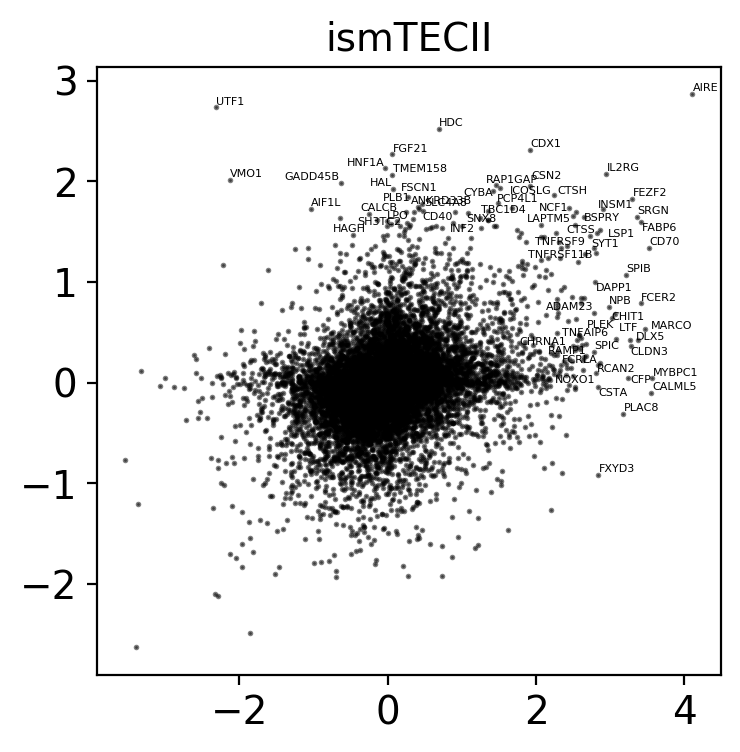

/mnt/thymus_atlas/scjp/species.py:42: RuntimeWarning:

divide by zero encountered in log10



02_Output/HTA08.v02.A04.FigS1_epi_ismTECIII.pdf


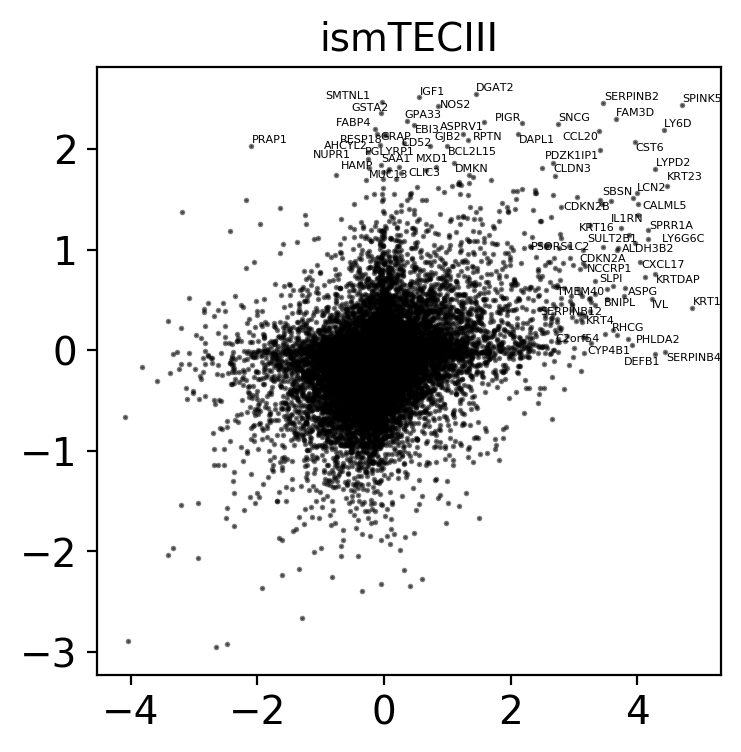

/mnt/thymus_atlas/scjp/species.py:41: RuntimeWarning:

divide by zero encountered in log10

/mnt/thymus_atlas/scjp/species.py:42: RuntimeWarning:

divide by zero encountered in log10



02_Output/HTA08.v02.A04.FigS1_epi_ismyo.pdf


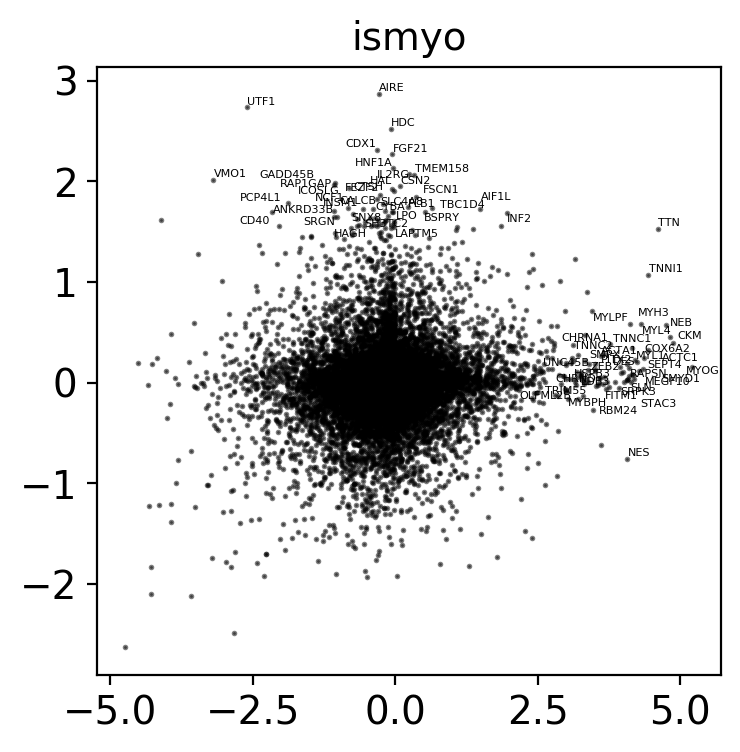

In [666]:
for ct in fc_tec.keys():
    species.draw_scatter_speices_ct(ct,fc_tec,version,fig_folder,percentile_thres=99.75,adjust_lim=5)
   # scjp.jp_save_fig(version,'Fig_HM_'+ct,fig_folder=fig_folder)
    plt.show()

In [ ]:
lr_epi = model.transfer_annotation_jp(TEC_hs,'anno_final_v4',TEC_hs,'anno_pred')

In [954]:
def show_marker_from_lr(lr,ct,genelist):

    c = lr_epi.classes_==ct
    return genelist[np.argsort(-lr_epi.coef_[c])]

In [961]:
print(show_marker_from_lr(lr_epi,'TEC(neuro)',TEC_hs.raw.var_names))

Index([['PCSK1N', 'NNAT', 'BEX1', 'STMN1', 'CIB2', 'TUBA1A', 'HES6', 'GHRH', 'CLDN3', 'WFDC2', 'SCG5', 'DAPL1', 'STK33', 'MYO6', 'KIF19', 'SYNE2', 'ASCL1', 'TESC', 'C4orf48', 'MAP1B', 'CPE', 'TCEAL7', 'NGFRAP1', 'CAMK2B', 'NTHL1', 'CLDN4', 'OVOS2', 'BEX2', 'FAM213A', 'FAM60A', 'SCCPDH', 'PGM2L1', 'SH3BGRL3', 'HEY1', 'CRIP2', 'AGPAT2', 'CMIP', 'MARCKSL1', 'KIF1A', 'MB', 'GNG8', 'HES4', 'FXYD6', 'FAM107A', 'SSR4', 'HES1', 'GPX2', 'TMEM59', 'PEG10', 'P4HTM', 'SOX4', 'CETN2', 'AES', 'CLDN9', 'ENO2', 'EID1', 'SCG3', 'PCBP4', 'TACC2', 'SPOCK1', 'LURAP1L', 'TTC3', 'PGF', 'TBCB', 'NPDC1', 'NHLH1', 'CD24', 'KLHL35', 'NLRP1', 'RGS17', 'C21orf59', 'MAPT', 'OLFM1', 'UBE2E3', 'CA8', 'CAPSL', 'TCF4', 'C2orf40', 'MMP24-AS1', 'SCAND1', 'HSPA2', 'SMARCE1', 'RAB3B', 'NELL1', 'CHMP2A', 'ZNF750', 'ATP6V1G1', 'TIA1', 'NEURL1', 'CNOT7', 'SNAP25', 'PCLO', 'SAMHD1', 'MAP2', 'RERE', 'PODXL2', 'NGB', 'TUBB4B', 'CHGB', 'KCNH2', ...]], dtype='object', name='index')


## mature T cells

In [765]:
humanised_names = [species.mouse_to_human(x) for x in mm_jp.raw.var_names]

In [766]:
mm_h = sc.AnnData(mm_jp.raw.X,var=mm_jp.raw.var,obs=mm_jp.obs)

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [767]:
mm_h.var_names = humanised_names

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [768]:
mm_h.raw = mm_h

In [769]:
mm_c, hs_c = model.get_common_var_raw(mm_h,hs)

calculating a...
calculating b...


In [770]:
set(mm_c.obs['anno_level_17'])

{'B',
 'B-T_doublet',
 'CD4+T',
 'CD8+T',
 'DC1',
 'DC2',
 'DN(P)',
 'DN(Q)',
 'DP(P)',
 'DP(Q)',
 'Endo',
 'Epi_Gcm2',
 'Ery',
 'Fb',
 'IELpA',
 'IELpB/NKT',
 'Mac',
 'Mono',
 'TEC_early',
 'T_unknown',
 'Treg',
 'aDC',
 'cTEC',
 'mTEC',
 'pDC',
 'αβT(entry)',
 'γδT'}

In [771]:
mm_select_mature = [
 'NKT','CD4+T',
 'CD8+T',
'IELpA',
 'IELpB/NKT',
'αβT(entry)',
 'γδT','Treg']

In [772]:
mm_T = mm_c[mm_c.obs['anno_level_17'].isin(mm_select_mature)]

In [773]:
hs_select_mature = [
 'CD4+T',
 'CD8+T',
 'CD8αα(I)',
 'CD8αα(II)',
 'Treg','T(agonist)',
 'Treg(diff)', 'αβT(entry)',
 'γδT', 
 'NKT']

In [774]:
c1 = hs_c.obs['anno_final_v8'].isin(hs_select_mature)
c2 = hs_c.obs['Stage'].isin('F4,P1'.split(','))

hs_T = hs_c[c1&c2]

In [775]:
hs_T.obs['anno_merge'] = [x+'_hs' for x in hs_T.obs['anno_final_v8']]
mm_T.obs['anno_merge'] = [x+'_mm' for x in mm_T.obs['anno_level_17']]

Trying to set attribute `.obs` of view, making a copy.
Trying to set attribute `.obs` of view, making a copy.


In [776]:
ad = {}
ad['hs'] = hs_T
ad['mm'] = mm_T

In [777]:
T = scjp.merge_matrix(ad)

24933
Sample
n_counts
n_genes
donor
organ
sort
method
file
mito
doublet_scores
predicted_doublets
name
source
birth
batch
bbk
Donor
Order
Age
Gender
Source
Stage
Stage2
Cycle_score
isCycle
scrublet_doublets
is_Fig1
is_file_Fig1
true_doublets
missed_doublets_scbl
missed_doublets_jp
anno_doublet_4_scores
anno_doublet_5_scores
anno_doublet_6_scores
anno_doublet_7_scores
anno_doublet_8_scores
anno_doublet_T_scores
dbl_jp_method
broad_doublets
anno_pred
anno_fig1_detailed.replaced.1
anno_fig1_detailed
anno_predict_B
anno_predict_fig1.replaced.1
anno_predict_fig1
anno_final_v1
anno_final_v2_epi
donor_method
factor
anno_final_v3
anno_final_v4
anno_final_v5
anno_final_v6
anno_final_v7
anno_final_v8
is_TRA_fl
is_TRB_fl
is_TRA_np
is_TRB_np
VDJ_TRAJ54
VDJ_TRAV25
VDJ_TRAJ22
VDJ_TRAV8-2
VDJ_TRBV6-9
VDJ_TRBV4-3
VDJ_TRAV8-1
VDJ_TRAV17
VDJ_TRAJ4
VDJ_TRAV29DV5
VDJ_TRAJ26
VDJ_TRAV5
VDJ_TRBV12-4
VDJ_TRAJ39
VDJ_TRAJ15
VDJ_TRBV4-2
VDJ_TRAJ17
VDJ_TRAJ27
VDJ_TRAV4
VDJ_TRBV11-3
VDJ_TRAV26-2
VDJ_TRAJ10
VDJ_TRA

## mouse to human

creating lr model...


/home/ubuntu/.local/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning:

Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.

/home/ubuntu/.local/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:469: FutureWarning:

Default multi_class will be changed to 'auto' in 0.22. Specify the multi_class option to silence this warning.



making lr prediction...


Trying to set attribute `.obs` of view, making a copy.


updating lr to adata...


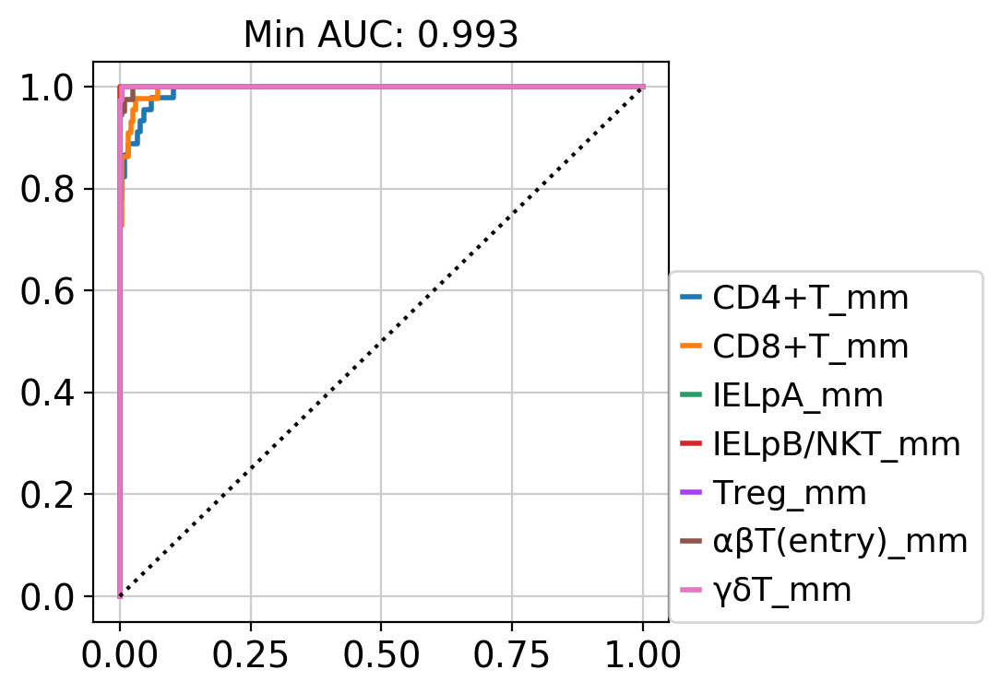

In [582]:
lr_mouse = model.transfer_annotation_jp(T[T.obs['name']=='mm'],'anno_merge',
                                       T[T.obs['name']=='hs'],'anno_pred_mm',raw=False)

In [583]:
proba_MtH = lr_mouse.predict_proba(T.X)

In [584]:
a = proba_MtH[T.obs['anno_merge']=='CD8+T_hs'].mean(axis=0)
b = lr_mouse.classes_

sorted([(b1,a1) for a1,b1 in zip(a,b)],key=lambda x:-x[1])

[('CD4+T_mm', 0.43731764073081403),
 ('CD8+T_mm', 0.196884610241958),
 ('IELpB/NKT_mm', 0.16105378098428116),
 ('IELpA_mm', 0.0987527612354019),
 ('Treg_mm', 0.07845481996266618),
 ('γδT_mm', 0.021326972749369975),
 ('αβT(entry)_mm', 0.006209414095509088)]

## human to mouse

creating lr model...
making lr prediction...
updating lr to adata...


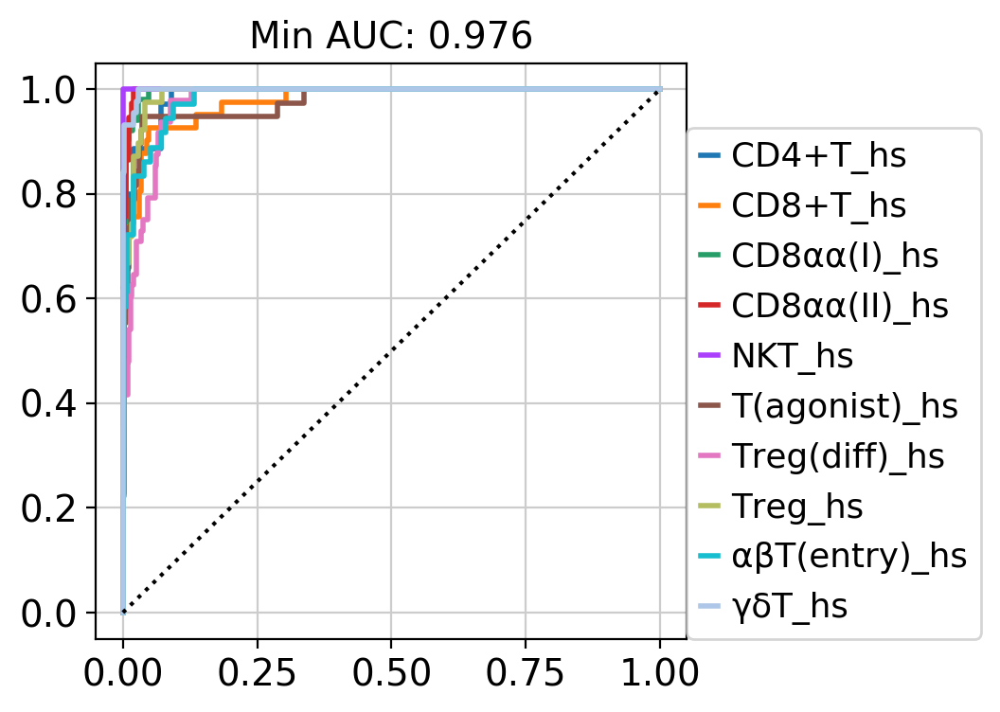

In [585]:
c1 = T.obs['name']=='hs'
lr_human = model.transfer_annotation_jp(T[c1],'anno_merge',
                                       T,'anno_pred_hs',
                                        raw=False)

In [586]:
proba_HtM = lr_human.predict_proba(T.X)

In [587]:
a = proba_HtM[T.obs['anno_merge']=='T_CD8_mm'].mean(axis=0)
b = lr_human.classes_

sorted([(b1,a1) for a1,b1 in zip(a,b)],key=lambda x:-x[1])

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: RuntimeWarning:

Mean of empty slice.

/home/ubuntu/.local/lib/python3.6/site-packages/numpy/core/_methods.py:154: RuntimeWarning:

invalid value encountered in true_divide



[('CD4+T_hs', nan),
 ('CD8+T_hs', nan),
 ('CD8αα(I)_hs', nan),
 ('CD8αα(II)_hs', nan),
 ('NKT_hs', nan),
 ('T(agonist)_hs', nan),
 ('Treg(diff)_hs', nan),
 ('Treg_hs', nan),
 ('αβT(entry)_hs', nan),
 ('γδT_hs', nan)]

In [588]:
HtM_mean_proba =[]
for mm_label in lr_mouse.classes_:
    HtM_mean_proba.append(proba_HtM[T.obs['anno_merge']==mm_label].mean(axis=0))
HtM_mean_proba = np.vstack(HtM_mean_proba)  

In [589]:
MtH_mean_proba =[]
for hs_label in lr_human.classes_:
    MtH_mean_proba.append(proba_MtH[T.obs['anno_merge']==hs_label].mean(axis=0))
MtH_mean_proba = np.vstack(MtH_mean_proba)      

In [590]:
HtM_mean_proba.shape

(7, 10)

In [591]:
MtH_mean_proba.shape

(10, 7)

In [592]:
lr_mouse.classes_

array(['CD4+T_mm', 'CD8+T_mm', 'IELpA_mm', 'IELpB/NKT_mm', 'Treg_mm',
       'αβT(entry)_mm', 'γδT_mm'], dtype=object)

In [593]:
hs_order = [ 
            'αβT(entry)_hs','CD4+T_hs', 'CD8+T_hs','Treg(diff)_hs', 'Treg_hs','T(agonist)_hs',
             'CD8αα(I)_hs', 'CD8αα(II)_hs','NKT_hs', 'γδT_hs'

]
hs_index = [list(lr_human.classes_).index(x) for x in hs_order]

mm_order = [ 
            'αβT(entry)_mm', 'CD4+T_mm', 'CD8+T_mm','Treg_mm',
            'IELpA_mm','IELpB/NKT_mm','γδT_mm'
           ]
mm_index = [list(lr_mouse.classes_).index(x) for x in mm_order]

02_Output/HTA08.v02.A04.FigS1_matureT_mouse_comp_HtM.pdf


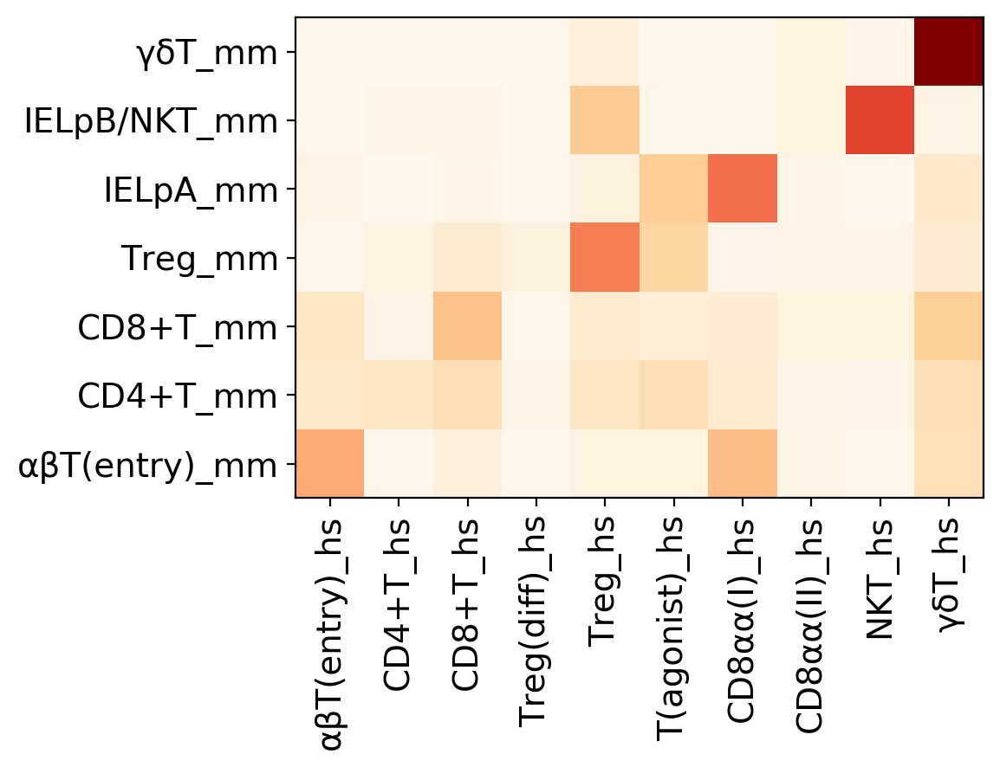

In [594]:
fig, ax = plt.subplots(figsize=(6,6))
im = ax.imshow(HtM_mean_proba[mm_index][:,hs_index])
plt.grid(False)

xlabel = lr_human.classes_[hs_index]
ylabel = lr_mouse.classes_[mm_index]

ax.set_xticks(np.arange(len(xlabel)))
ax.set_yticks(np.arange(len(ylabel)+1))

plt.ylim(-0.5,len(ylabel)-0.5)

ax.set_xticklabels(xlabel)
ax.set_yticklabels(ylabel)

plt.setp(ax.get_xticklabels(),rotation=90)

fig.tight_layout()
plt.grid(False)
scjp.jp_save_fig(version,'FigS1_matureT_mouse_comp_HtM',fig_folder=fig_folder)

02_Output/HTA08.v02.A04.FigS1_matureT_mouse_comp_MtH.pdf


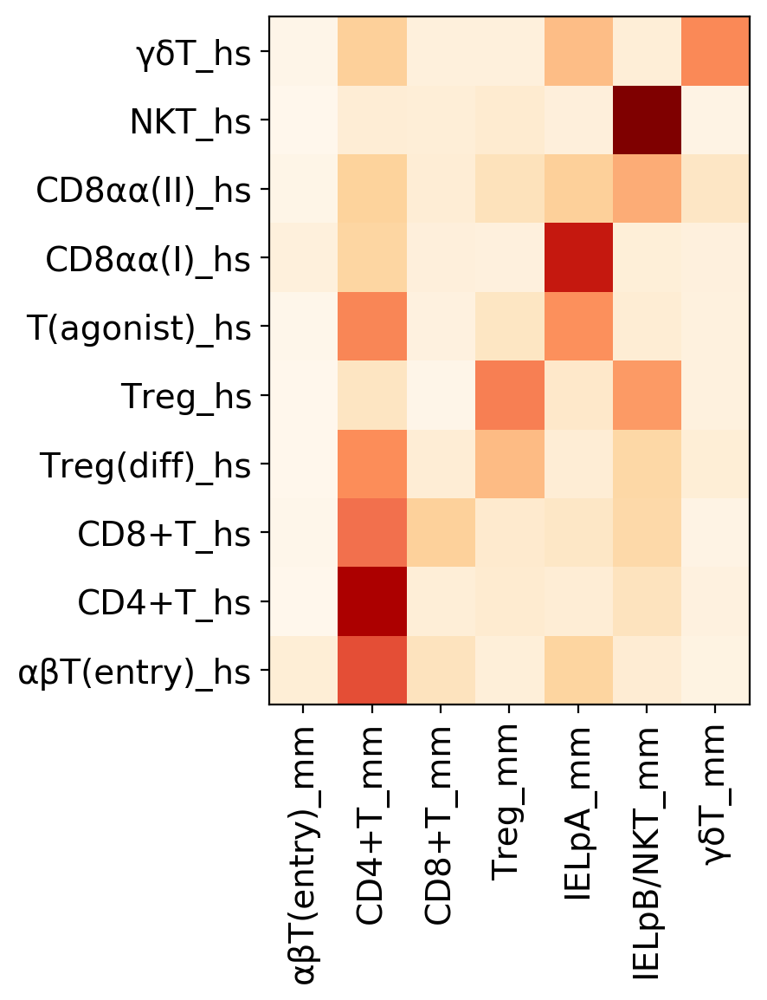

In [595]:
fig, ax = plt.subplots(figsize=(6,6))
im = ax.imshow(MtH_mean_proba[hs_index][:,mm_index])
plt.grid(False)

xlabel = lr_mouse.classes_[mm_index]
ylabel = lr_human.classes_[hs_index]

ax.set_xticks(np.arange(len(xlabel)))
ax.set_yticks(np.arange(len(ylabel)+1))

plt.ylim(-0.5,len(ylabel)-0.5)

ax.set_xticklabels(xlabel)
ax.set_yticklabels(ylabel)

plt.setp(ax.get_xticklabels(),rotation=90)

fig.tight_layout()
plt.grid(False)
scjp.jp_save_fig(version,'FigS1_matureT_mouse_comp_MtH',fig_folder=fig_folder)

In [596]:
multi = MtH_mean_proba[hs_index][:,mm_index]*HtM_mean_proba[mm_index][:,hs_index].T

02_Output/HTA08.v02.A04.FigS1_matureT_mouse_combi.pdf


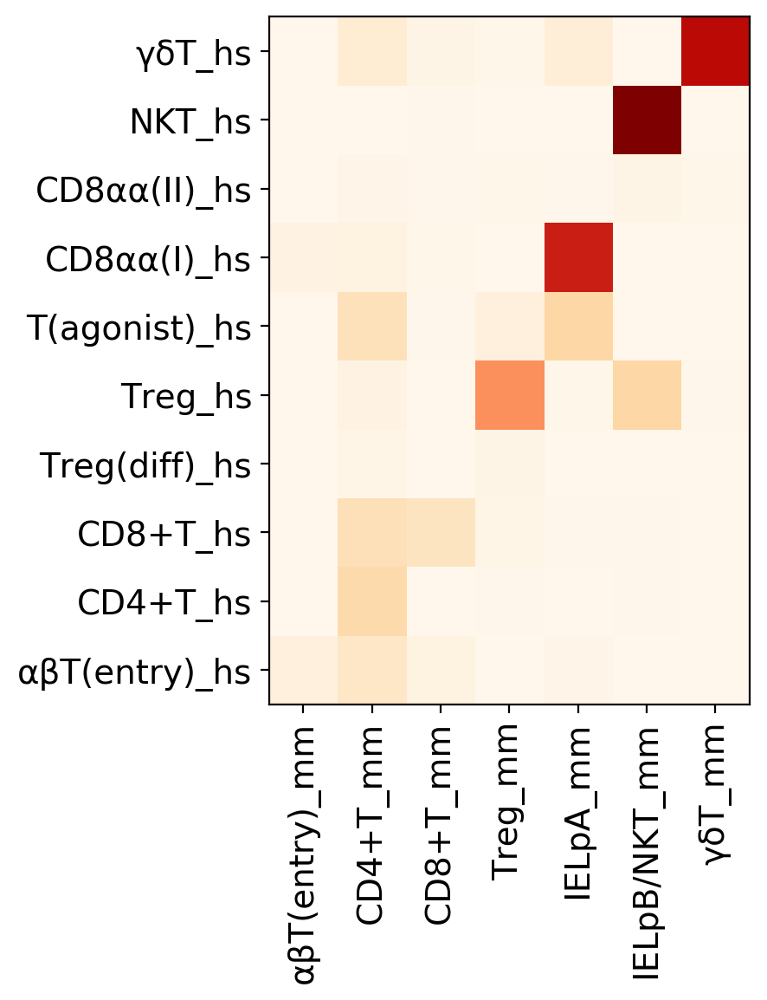

In [597]:
fig, ax = plt.subplots(figsize=(6,6))
im = ax.imshow(multi,vmax=0.4)
plt.grid(False)

xlabel = lr_mouse.classes_[mm_index]
ylabel = lr_human.classes_[hs_index]

ax.set_xticks(np.arange(len(xlabel)))
ax.set_yticks(np.arange(len(ylabel)+1))

plt.ylim(-0.5,len(ylabel)-0.5)

ax.set_xticklabels(xlabel)
ax.set_yticklabels(ylabel)

plt.setp(ax.get_xticklabels(),rotation=90)

fig.tight_layout()
plt.grid(False)
scjp.jp_save_fig(version,'FigS1_matureT_mouse_combi',fig_folder=fig_folder)

In [ ]:
hs_order = [ 
            'αβT(entry)_hs','CD4+T_hs', 'CD8+T_hs','Treg(diff)_hs', 'Treg_hs','T(agonist)_hs',
             'CD8αα(I)_hs', 'CD8αα(II)_hs','NKT_hs', 'NK_hs','γδT_hs'

]
hs_index = [list(lr_human.classes_).index(x) for x in hs_order]

mm_order = [ 
            'αβT(entry)_mm', 'CD4+T_mm', 'CD8+T_mm','Treg_mm',
            'IELpA_mm','IELpB/NKT_mm','γδT_mm'
           ]
mm_index = [list(lr_mouse.classes_).index(x) for x in mm_order]

In [764]:
T

AnnData object with n_obs × n_vars = 54602 × 17034 
    obs: 'Sample', 'n_counts', 'n_genes', 'donor', 'organ', 'sort', 'method', 'file', 'mito', 'doublet_scores', 'predicted_doublets', 'name', 'source', 'birth', 'batch', 'bbk', 'Donor', 'Order', 'Age', 'Gender', 'Source', 'Stage', 'Stage2', 'Cycle_score', 'isCycle', 'scrublet_doublets', 'is_Fig1', 'is_file_Fig1', 'true_doublets', 'missed_doublets_scbl', 'missed_doublets_jp', 'anno_doublet_4_scores', 'anno_doublet_5_scores', 'anno_doublet_6_scores', 'anno_doublet_7_scores', 'anno_doublet_8_scores', 'anno_doublet_T_scores', 'dbl_jp_method', 'broad_doublets', 'anno_pred', 'anno_fig1_detailed.replaced.1', 'anno_fig1_detailed', 'anno_predict_B', 'anno_predict_fig1.replaced.1', 'anno_predict_fig1', 'anno_final_v1', 'anno_final_v2_epi', 'donor_method', 'factor', 'anno_final_v3', 'anno_final_v4', 'anno_final_v5', 'anno_final_v6', 'anno_final_v7', 'anno_final_v8', 'is_TRA_fl', 'is_TRB_fl', 'is_TRA_np', 'is_TRB_np', 'VDJ_TRAJ54', 'VDJ_TRAV25', 

In [778]:
T.obs['isEntry'] = T.obs['anno_merge'].isin('αβT(entry)_hs,αβT(entry)_mm'.split(','))

In [598]:
T.obs['isTnfrsf9'] = T.obs['anno_merge'].isin('IELpA_mm,CD8αα(I)_hs'.split(','))
T.obs['isCD8'] = T.obs['anno_merge'].isin('CD8+T_hs,CD8+T_mm'.split(','))
T.obs['isCD4'] = T.obs['anno_merge'].isin('CD4+T_hs,CD4+T_mm'.split(','))
T.obs['isTreg'] = T.obs['anno_merge'].isin('Treg_hs,Treg_mm'.split(','))
T.obs['isTgd'] = T.obs['anno_merge'].isin('γδT_hs,γδT_mm'.split(','))
T.obs['isNKT'] = T.obs['anno_merge'].isin('NKT_hs,IELpB/NKT_mm'.split(','))
T.obs['isCD8aaII'] = T.obs['anno_merge'].isin('CD8αα(II)_hs,IELpB/NKT_mm'.split(','))

In [779]:
T_hs = T[T.obs['name']=='hs']
T_hs.raw = T_hs

In [780]:
T_mm = T[T.obs['name']=='mm']
T_mm.raw = T_mm

In [781]:
T.raw = T

In [604]:
fc = defaultdict(lambda : defaultdict())

In [782]:
for ct in ['isEntry']:
    print(ct)
    fc[ct]['hs'] = markers.volcano_plot(T_hs,ct,True,False)
    fc[ct]['mm'] = markers.volcano_plot(T_mm,ct,True,False)

isEntry


/mnt/thymus_atlas/scjp/species.py:41: RuntimeWarning:

divide by zero encountered in log10

/mnt/thymus_atlas/scjp/species.py:42: RuntimeWarning:

divide by zero encountered in log10



02_Output/HTA08.v02.A04.FigS1_epi_isEntry.pdf


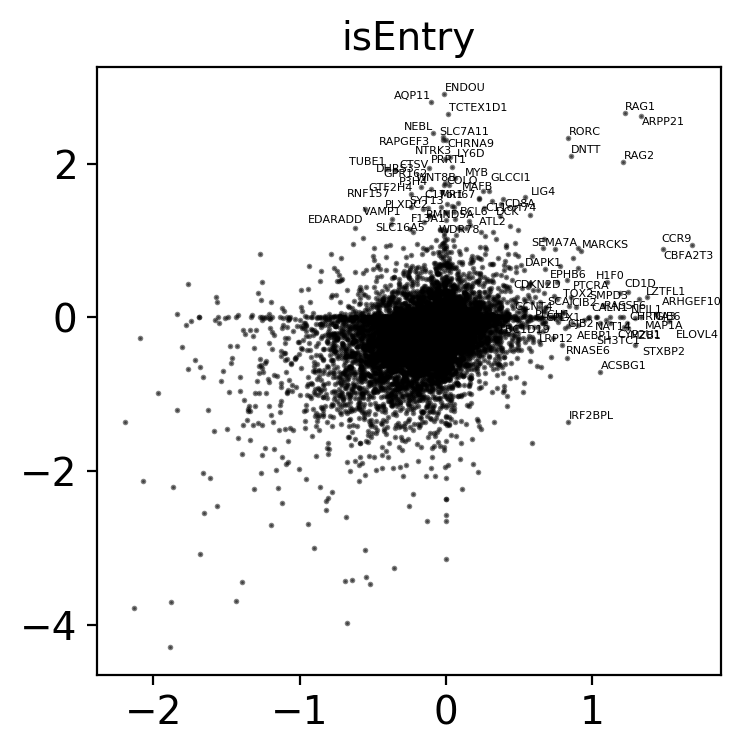

In [783]:
for ct in ['isEntry']:
    species.draw_scatter_speices_ct(ct,fc,version,fig_folder,percentile_thres=99.75,adjust_lim=5)
    #scjp.jp_save_fig(version,'Fig_HM_'+ct,fig_folder=fig_folder)
    plt.show()

In [605]:
for ct in ['isNKT','isTnfrsf9','isCD8aaII','isCD8','isCD4','isTreg','isTgd']:
    print(ct)
    fc[ct]['hs'] = markers.volcano_plot(T_hs,ct,True,False)
    fc[ct]['mm'] = markers.volcano_plot(T_mm,ct,True,False)

isNKT
isTnfrsf9
isCD8aaII
isCD8
isCD4
isTreg
isTgd


/mnt/thymus_atlas/scjp/species.py:41: RuntimeWarning:

divide by zero encountered in log10

/mnt/thymus_atlas/scjp/species.py:42: RuntimeWarning:

divide by zero encountered in log10



02_Output/HTA08.v02.A04.FigS1_epi_isNKT.pdf


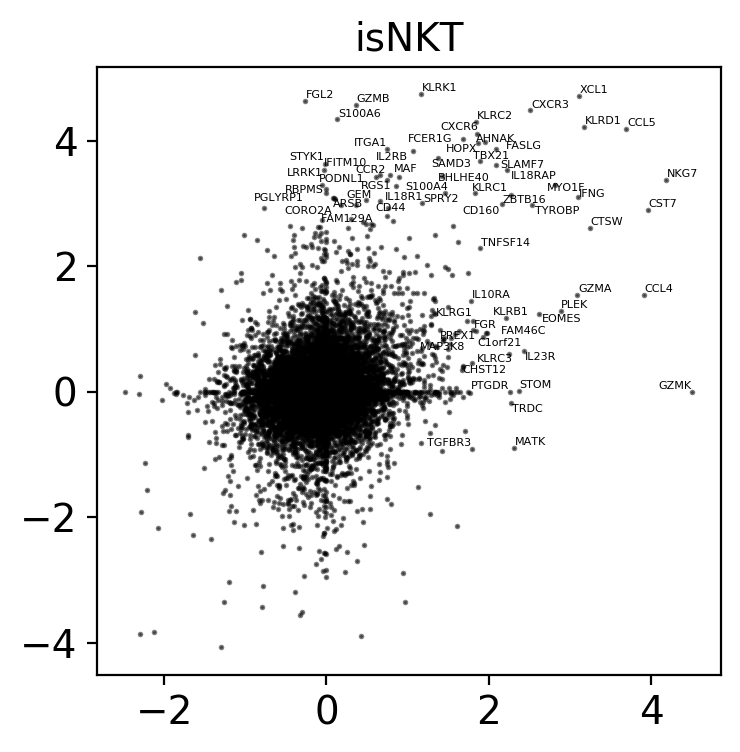

/mnt/thymus_atlas/scjp/species.py:42: RuntimeWarning:

divide by zero encountered in log10



02_Output/HTA08.v02.A04.FigS1_epi_isTnfrsf9.pdf


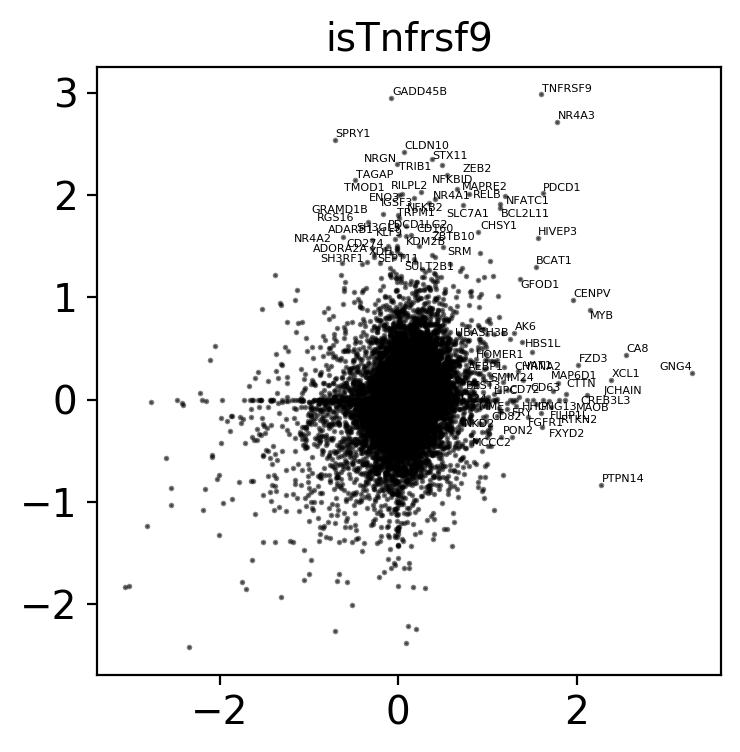

/mnt/thymus_atlas/scjp/species.py:41: RuntimeWarning:

divide by zero encountered in log10

/mnt/thymus_atlas/scjp/species.py:42: RuntimeWarning:

divide by zero encountered in log10



02_Output/HTA08.v02.A04.FigS1_epi_isCD8aaII.pdf


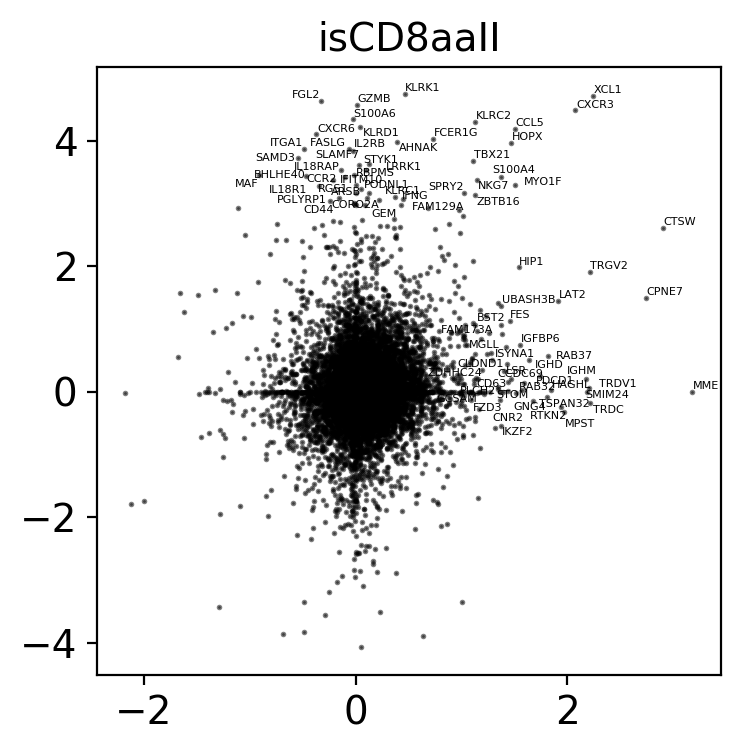

/mnt/thymus_atlas/scjp/species.py:42: RuntimeWarning:

divide by zero encountered in log10



02_Output/HTA08.v02.A04.FigS1_epi_isCD8.pdf


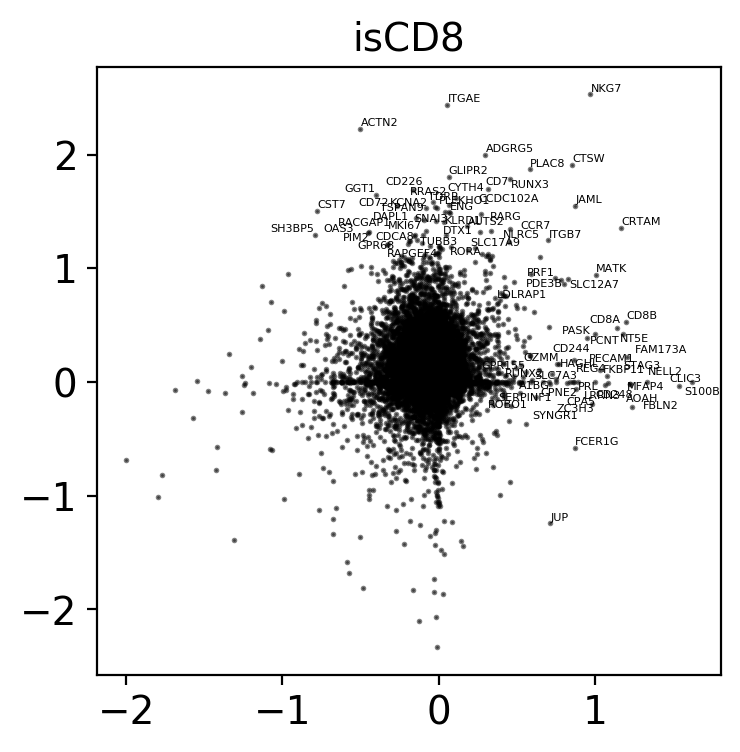

/mnt/thymus_atlas/scjp/species.py:41: RuntimeWarning:

divide by zero encountered in log10

/mnt/thymus_atlas/scjp/species.py:42: RuntimeWarning:

divide by zero encountered in log10



02_Output/HTA08.v02.A04.FigS1_epi_isCD4.pdf


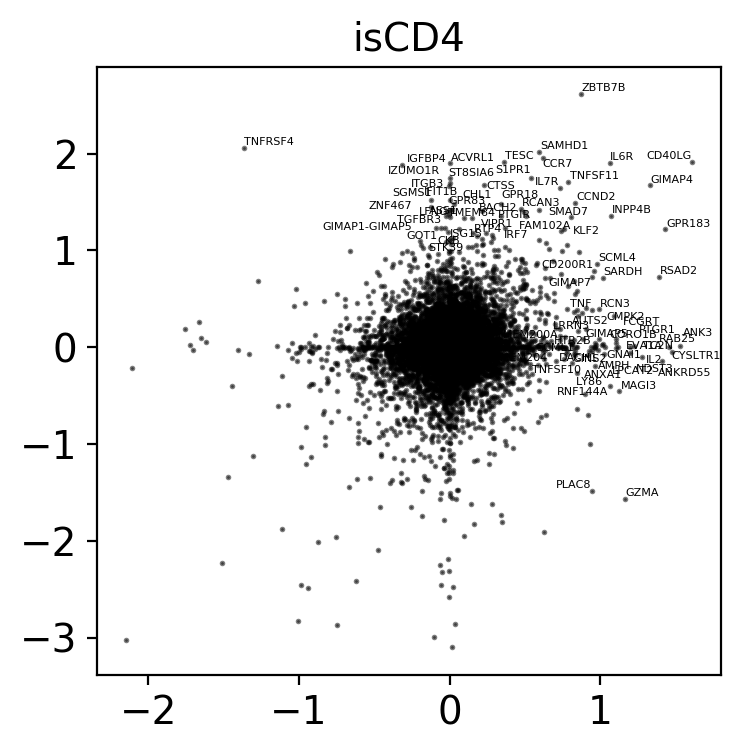

/mnt/thymus_atlas/scjp/species.py:41: RuntimeWarning:

divide by zero encountered in log10

/mnt/thymus_atlas/scjp/species.py:42: RuntimeWarning:

divide by zero encountered in log10



02_Output/HTA08.v02.A04.FigS1_epi_isTreg.pdf


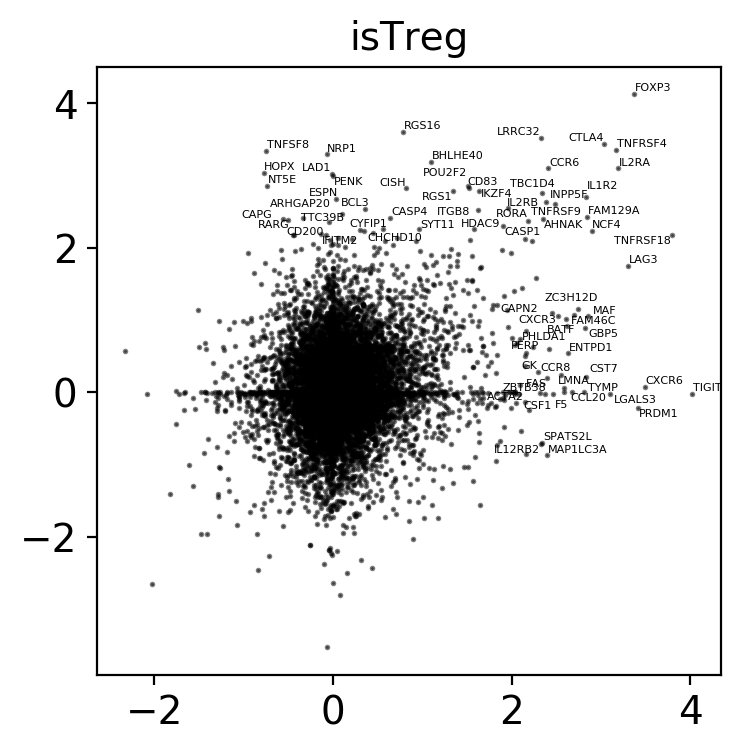

/mnt/thymus_atlas/scjp/species.py:41: RuntimeWarning:

divide by zero encountered in log10

/mnt/thymus_atlas/scjp/species.py:42: RuntimeWarning:

divide by zero encountered in log10



02_Output/HTA08.v02.A04.FigS1_epi_isTgd.pdf


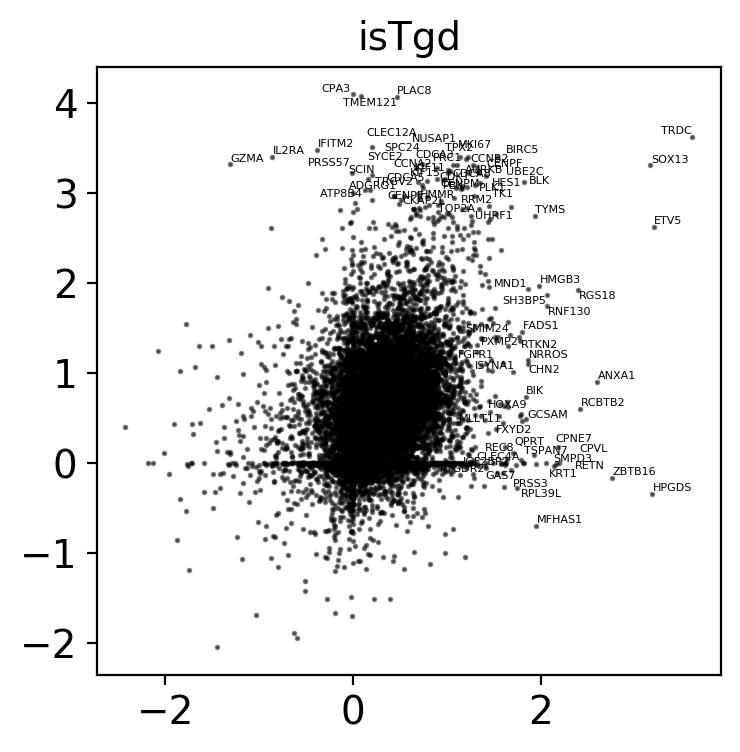

In [667]:
for ct in ['isNKT','isTnfrsf9','isCD8aaII','isCD8','isCD4','isTreg','isTgd']:
    species.draw_scatter_speices_ct(ct,fc,version,fig_folder,percentile_thres=99.75,adjust_lim=5)
    #scjp.jp_save_fig(version,'Fig_HM_'+ct,fig_folder=fig_folder)
    plt.show()

## DNDP T cells

In [633]:
mm_select = ['HSC','DN(P)',
 'DN(Q)',
 'DP(P)',
 'DP(Q)','αβT(entry)']

In [634]:
mm_T = mm_c[mm_c.obs['anno_level_17'].isin(mm_select)]

In [635]:
hs_select = ['ETP',
 'DN(P)',
 'DN(Q)',
 'DN(early)',
 'DP(P)',
 'DP(Q)', 'αβT(entry)']



In [636]:
c1 = hs_c.obs['anno_final_v8'].isin(hs_select)
c2 = hs_c.obs['Stage'].isin('F4,P1'.split(','))

hs_T = hs_c[c1&c2]

In [637]:
hs_T.obs['anno_merge'] = [x+'_hs' for x in hs_T.obs['anno_final_v8']]
mm_T.obs['anno_merge'] = [x+'_mm' for x in mm_T.obs['anno_level_17']]

Trying to set attribute `.obs` of view, making a copy.
Trying to set attribute `.obs` of view, making a copy.


In [638]:
ad = {}
ad['hs'] = hs_T
ad['mm'] = mm_T

In [639]:
T = scjp.merge_matrix(ad)

54602
Sample
n_counts
n_genes
donor
organ
sort
method
file
mito
doublet_scores
predicted_doublets
name
source
birth
batch
bbk
Donor
Order
Age
Gender
Source
Stage
Stage2
Cycle_score
isCycle
scrublet_doublets
is_Fig1
is_file_Fig1
true_doublets
missed_doublets_scbl
missed_doublets_jp
anno_doublet_4_scores
anno_doublet_5_scores
anno_doublet_6_scores
anno_doublet_7_scores
anno_doublet_8_scores
anno_doublet_T_scores
dbl_jp_method
broad_doublets
anno_pred
anno_fig1_detailed.replaced.1
anno_fig1_detailed
anno_predict_B
anno_predict_fig1.replaced.1
anno_predict_fig1
anno_final_v1
anno_final_v2_epi
donor_method
factor
anno_final_v3
anno_final_v4
anno_final_v5
anno_final_v6
anno_final_v7
anno_final_v8
is_TRA_fl
is_TRB_fl
is_TRA_np
is_TRB_np
VDJ_TRAJ54
VDJ_TRAV25
VDJ_TRAJ22
VDJ_TRAV8-2
VDJ_TRBV6-9
VDJ_TRBV4-3
VDJ_TRAV8-1
VDJ_TRAV17
VDJ_TRAJ4
VDJ_TRAV29DV5
VDJ_TRAJ26
VDJ_TRAV5
VDJ_TRBV12-4
VDJ_TRAJ39
VDJ_TRAJ15
VDJ_TRBV4-2
VDJ_TRAJ17
VDJ_TRAJ27
VDJ_TRAV4
VDJ_TRBV11-3
VDJ_TRAV26-2
VDJ_TRAJ10
VDJ_TRA

## mouse to human

creating lr model...
making lr prediction...


Trying to set attribute `.obs` of view, making a copy.


updating lr to adata...


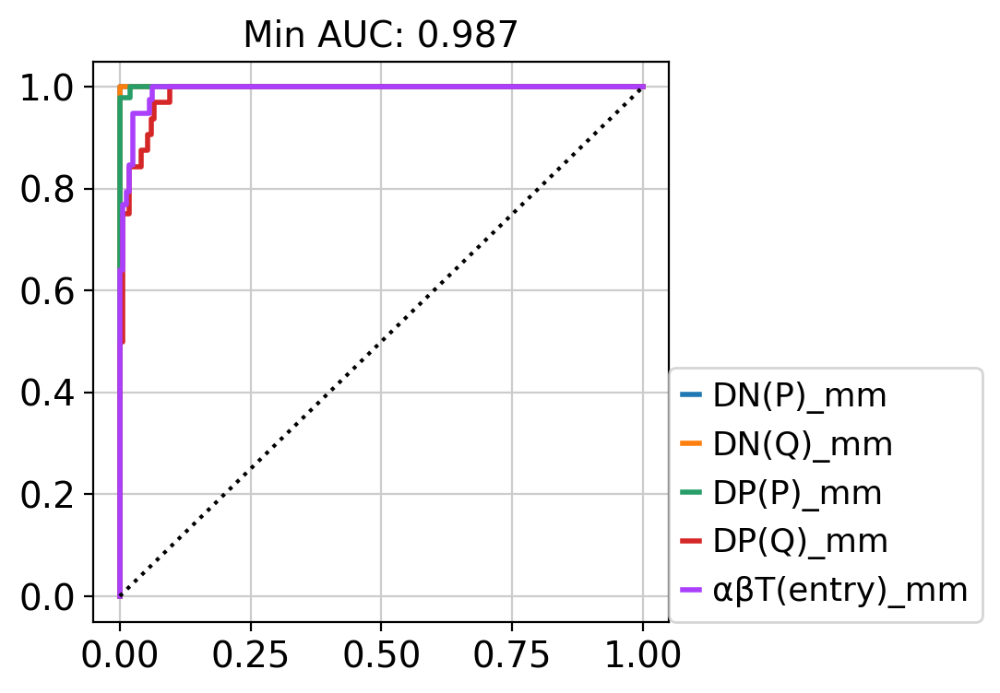

In [640]:
lr_mouse = model.transfer_annotation_jp(T[T.obs['name']=='mm'],'anno_merge',
                                       T[T.obs['name']=='hs'],'anno_pred_mm',raw=False)

In [641]:
proba_MtH = lr_mouse.predict_proba(T.X)

In [642]:
a = proba_MtH[T.obs['anno_merge']=='DN(P)_hs'].mean(axis=0)
b = lr_mouse.classes_

sorted([(b1,a1) for a1,b1 in zip(a,b)],key=lambda x:-x[1])

[('DP(P)_mm', 0.6286666788880556),
 ('DN(P)_mm', 0.20599862517642775),
 ('DN(Q)_mm', 0.0947801908271478),
 ('αβT(entry)_mm', 0.06953608308096278),
 ('DP(Q)_mm', 0.001018422027403477)]

## human to mouse

creating lr model...
making lr prediction...
updating lr to adata...


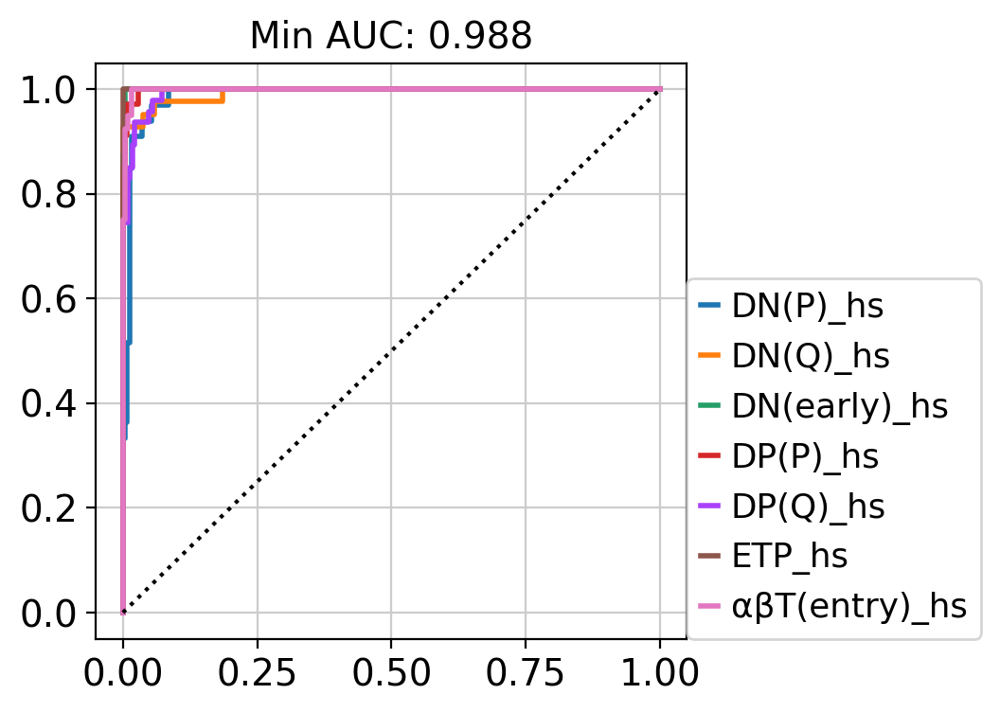

In [643]:
c1 = T.obs['name']=='hs'
lr_human = model.transfer_annotation_jp(T[c1],'anno_merge',
                                       T,'anno_pred_hs',
                                        raw=False)

In [644]:
proba_HtM = lr_human.predict_proba(T.X)

In [645]:
a = proba_HtM[T.obs['anno_merge']=='DN(P)_mm'].mean(axis=0)
b = lr_human.classes_

sorted([(b1,a1) for a1,b1 in zip(a,b)],key=lambda x:-x[1])

[('DN(early)_hs', 0.6288295478658791),
 ('DP(P)_hs', 0.17561206960562084),
 ('DN(P)_hs', 0.09265047731827245),
 ('αβT(entry)_hs', 0.07962734666969297),
 ('ETP_hs', 0.023046546612422527),
 ('DN(Q)_hs', 0.00018098278667154181),
 ('DP(Q)_hs', 5.302914144054543e-05)]

In [646]:
HtM_mean_proba =[]
for mm_label in lr_mouse.classes_:
    HtM_mean_proba.append(proba_HtM[T.obs['anno_merge']==mm_label].mean(axis=0))
HtM_mean_proba = np.vstack(HtM_mean_proba)  

In [647]:
MtH_mean_proba =[]
for hs_label in lr_human.classes_:
    MtH_mean_proba.append(proba_MtH[T.obs['anno_merge']==hs_label].mean(axis=0))
MtH_mean_proba = np.vstack(MtH_mean_proba)      

In [648]:
HtM_mean_proba.shape

(5, 7)

In [649]:
MtH_mean_proba.shape

(7, 5)

In [650]:
lr_human.classes_

array(['DN(P)_hs', 'DN(Q)_hs', 'DN(early)_hs', 'DP(P)_hs', 'DP(Q)_hs',
       'ETP_hs', 'αβT(entry)_hs'], dtype=object)

In [651]:
lr_mouse.classes_

array(['DN(P)_mm', 'DN(Q)_mm', 'DP(P)_mm', 'DP(Q)_mm', 'αβT(entry)_mm'],
      dtype=object)

In [652]:
hs_order = ['ETP_hs','DN(early)_hs','DN(P)_hs', 'DN(Q)_hs',
            'DP(P)_hs', 'DP(Q)_hs', 
            'αβT(entry)_hs'

]
hs_index = [list(lr_human.classes_).index(x) for x in hs_order]

In [654]:
mm_order = ['DN(P)_mm', 'DN(Q)_mm', 'DP(P)_mm', 'DP(Q)_mm',
            'αβT(entry)_mm', 
           ]
mm_index = [list(lr_mouse.classes_).index(x) for x in mm_order]

02_Output/HTA08.v02.A04.FigS1_developT_mouse_comp_HtM.pdf


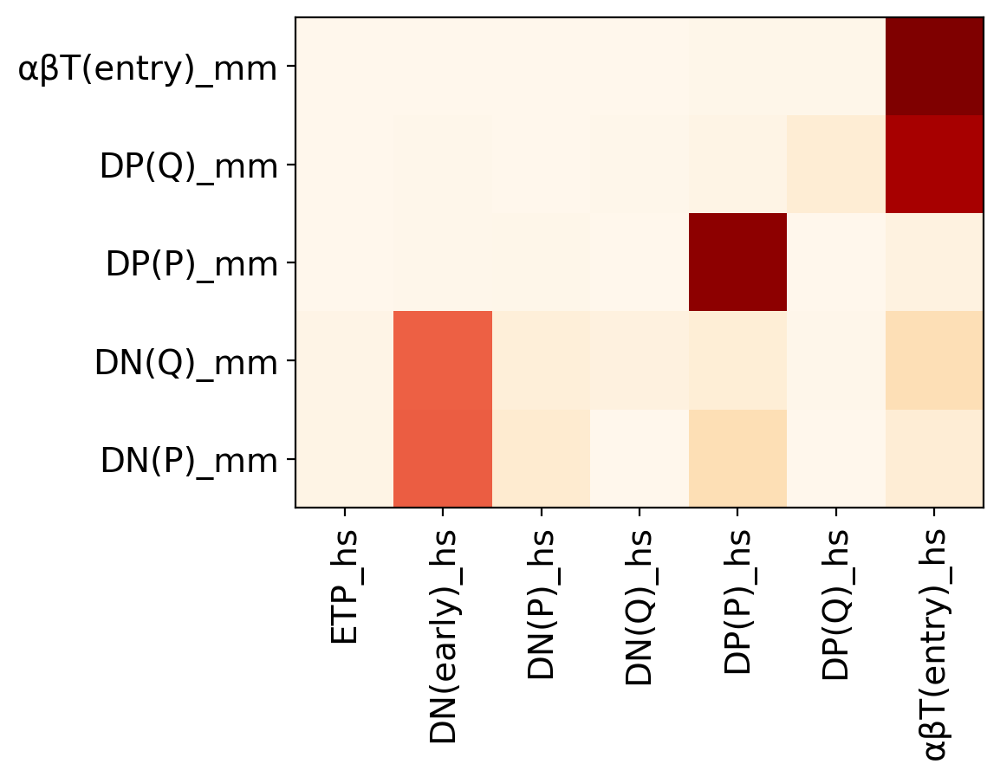

In [655]:
fig, ax = plt.subplots(figsize=(6,6))
im = ax.imshow(HtM_mean_proba[mm_index][:,hs_index])
plt.grid(False)

xlabel = lr_human.classes_[hs_index]
ylabel = lr_mouse.classes_[mm_index]

ax.set_xticks(np.arange(len(xlabel)))
ax.set_yticks(np.arange(len(ylabel)+1))

plt.ylim(-0.5,len(ylabel)-0.5)

ax.set_xticklabels(xlabel)
ax.set_yticklabels(ylabel)

plt.setp(ax.get_xticklabels(),rotation=90)

fig.tight_layout()
plt.grid(False)
scjp.jp_save_fig(version,'FigS1_developT_mouse_comp_HtM',fig_folder=fig_folder)

02_Output/HTA08.v02.A04.FigS1_developT_mouse_comp_MtH.pdf


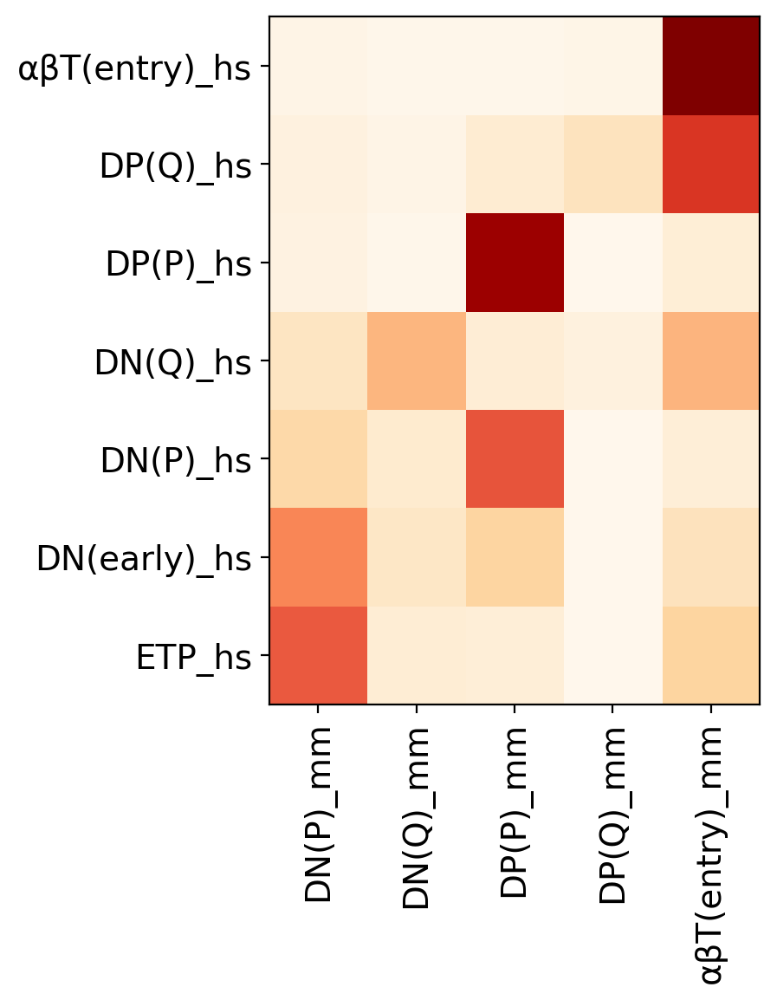

In [656]:
fig, ax = plt.subplots(figsize=(6,6))
im = ax.imshow(MtH_mean_proba[hs_index][:,mm_index])
plt.grid(False)

xlabel = lr_mouse.classes_[mm_index]
ylabel = lr_human.classes_[hs_index]

ax.set_xticks(np.arange(len(xlabel)))
ax.set_yticks(np.arange(len(ylabel)+1))

plt.ylim(-0.5,len(ylabel)-0.5)

ax.set_xticklabels(xlabel)
ax.set_yticklabels(ylabel)

plt.setp(ax.get_xticklabels(),rotation=90)

fig.tight_layout()
plt.grid(False)
scjp.jp_save_fig(version,'FigS1_developT_mouse_comp_MtH',fig_folder=fig_folder)

In [657]:
multi = MtH_mean_proba[hs_index][:,mm_index]*HtM_mean_proba[mm_index][:,hs_index].T

02_Output/HTA08.v02.A04.FigS1_developT_mouse_combi.pdf


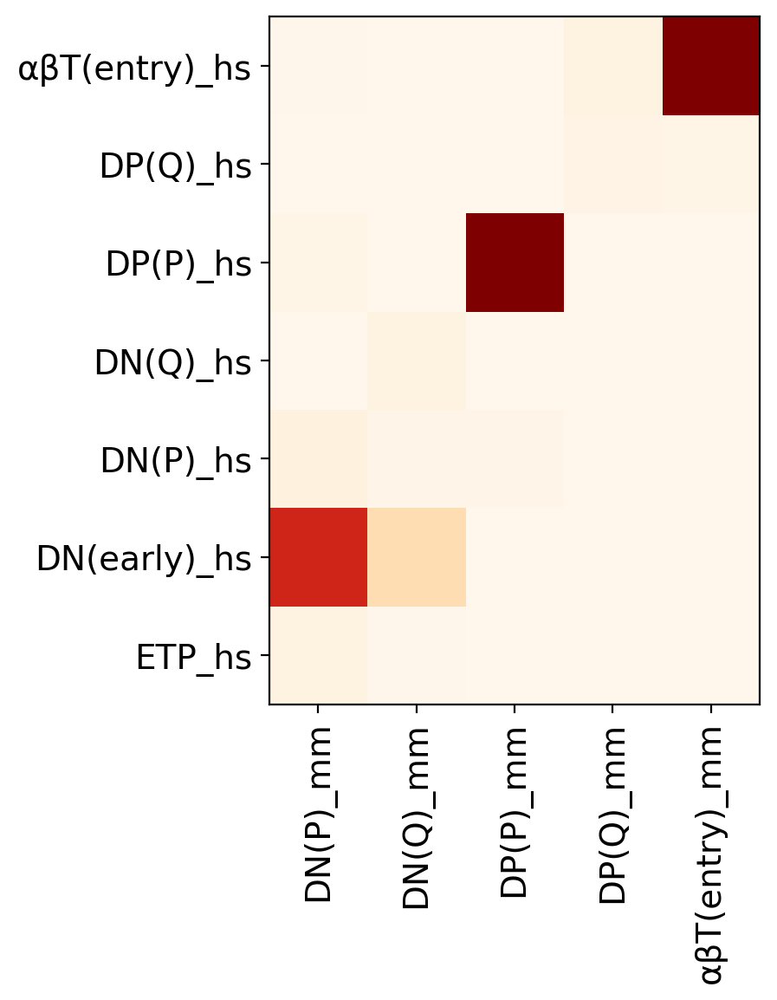

In [658]:
fig, ax = plt.subplots(figsize=(6,6))
im = ax.imshow(multi,vmax=0.4)
plt.grid(False)

xlabel = lr_mouse.classes_[mm_index]
ylabel = lr_human.classes_[hs_index]

ax.set_xticks(np.arange(len(xlabel)))
ax.set_yticks(np.arange(len(ylabel)+1))

plt.ylim(-0.5,len(ylabel)-0.5)

ax.set_xticklabels(xlabel)
ax.set_yticklabels(ylabel)

plt.setp(ax.get_xticklabels(),rotation=90)

fig.tight_layout()
plt.grid(False)
scjp.jp_save_fig(version,'FigS1_developT_mouse_combi',fig_folder=fig_folder)

In [659]:
T.obs['isDN(P)'] = T.obs['anno_merge'].isin('DN(P)_mm,DN(P)_hs,DN(early)_hs'.split(','))
T.obs['isDN(Q)'] = T.obs['anno_merge'].isin('DN(Q)_hs,DN(Q)_mm'.split(','))
T.obs['isDP(P)'] = T.obs['anno_merge'].isin('DP(P)_hs,DP(P)_mm'.split(','))
T.obs['isDP(Q)'] = T.obs['anno_merge'].isin('DP(Q)_hs,DP(Q)_mm'.split(','))
T.obs['isEntry'] = T.obs['anno_merge'].isin('αβT(entry)_hs,αβT(entry)_mm'.split(','))
T.obs['isDN'] = T.obs['anno_merge'].isin('DN(P)_mm,DN(P)_hs,DN(early)_hs,DN(Q)_hs,DN(Q)_mm'.split(','))
T.obs['isDP'] = T.obs['anno_merge'].isin('DP(P)_mm,DP(P)_hs,DP(Q)_hs,DP(Q)_mm'.split(','))

In [660]:
T_hs = T[T.obs['name']=='hs']
T_hs.raw = T_hs

In [661]:
T_mm = T[T.obs['name']=='mm']
T_mm.raw = T_mm

In [662]:
#fc = defaultdict(lambda : defaultdict())

In [664]:
for ct in ['isDP','isDN','isDN(P)','isDN(Q)','isDP(P)','isDP(Q)','isEntry']:
    print(ct)
    fc[ct]['hs'] = markers.volcano_plot(T_hs,ct,True,False)
    fc[ct]['mm'] = markers.volcano_plot(T_mm,ct,True,False)

isDP
isDN
isDN(P)
isDN(Q)
isDP(P)
isDP(Q)
isEntry


/mnt/thymus_atlas/scjp/species.py:41: RuntimeWarning:

divide by zero encountered in log10

/mnt/thymus_atlas/scjp/species.py:42: RuntimeWarning:

divide by zero encountered in log10



02_Output/HTA08.v02.A04.FigS1_epi_isDP.pdf


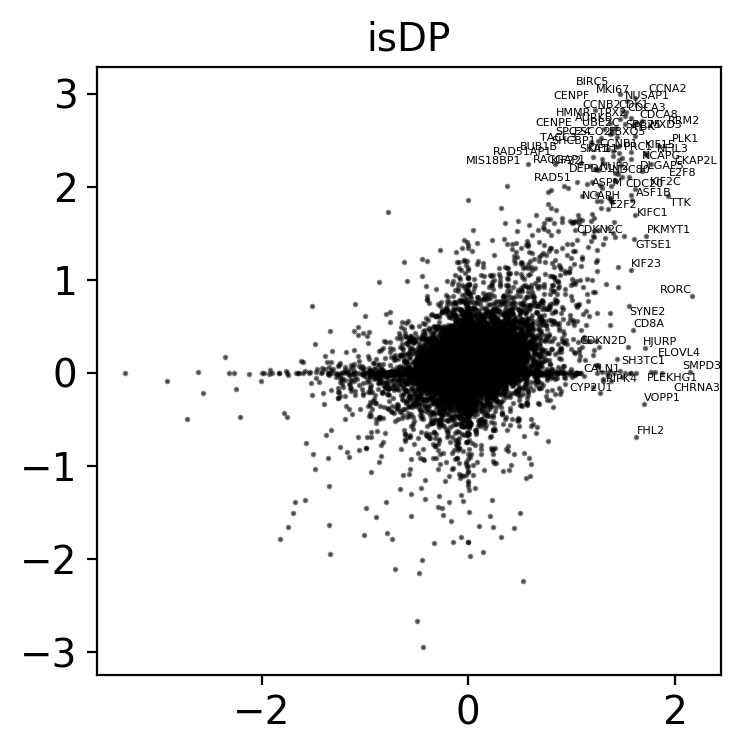

/mnt/thymus_atlas/scjp/species.py:41: RuntimeWarning:

divide by zero encountered in log10

/mnt/thymus_atlas/scjp/species.py:42: RuntimeWarning:

divide by zero encountered in log10



02_Output/HTA08.v02.A04.FigS1_epi_isDN.pdf


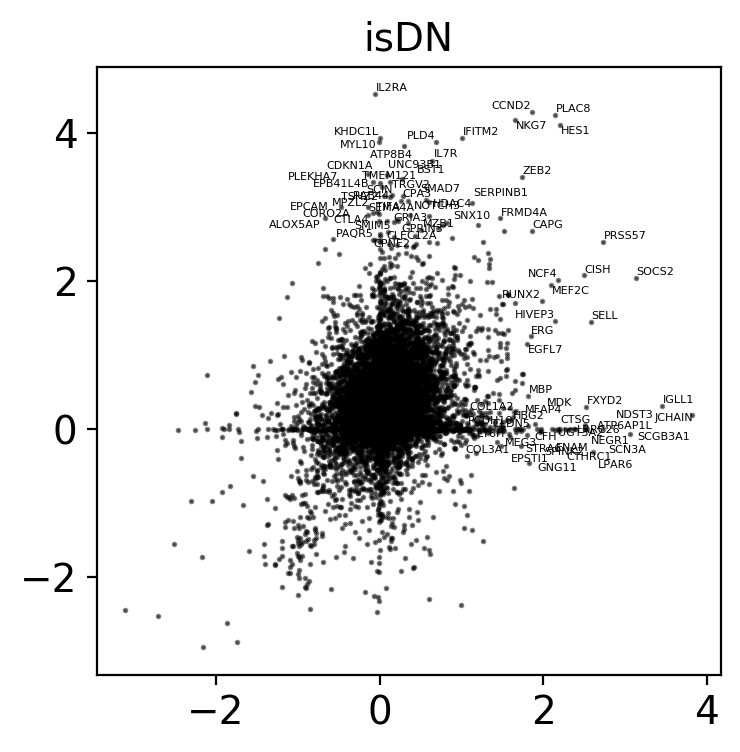

/mnt/thymus_atlas/scjp/species.py:41: RuntimeWarning:

divide by zero encountered in log10

/mnt/thymus_atlas/scjp/species.py:42: RuntimeWarning:

divide by zero encountered in log10



02_Output/HTA08.v02.A04.FigS1_epi_isDN(P).pdf


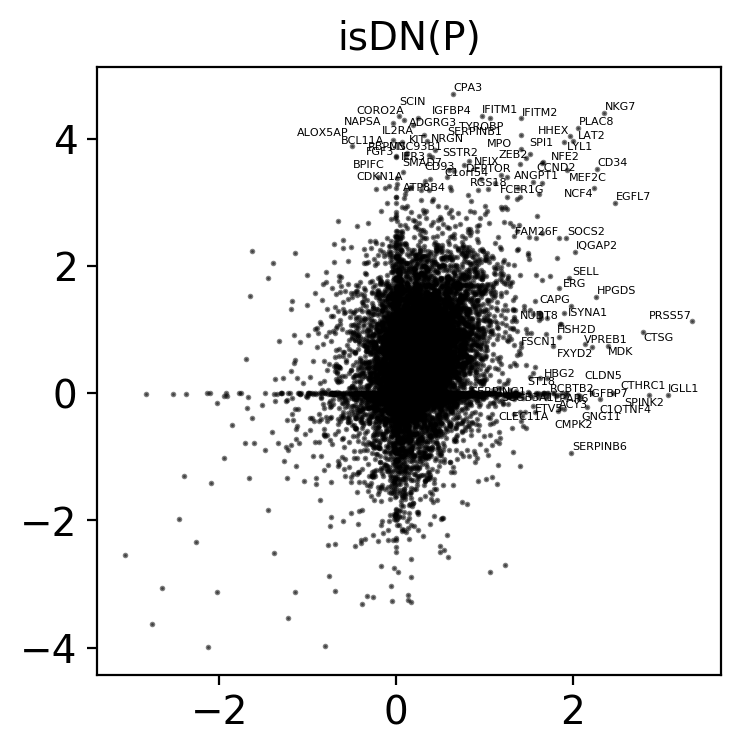

/mnt/thymus_atlas/scjp/species.py:41: RuntimeWarning:

divide by zero encountered in log10

/mnt/thymus_atlas/scjp/species.py:42: RuntimeWarning:

divide by zero encountered in log10



02_Output/HTA08.v02.A04.FigS1_epi_isDN(Q).pdf


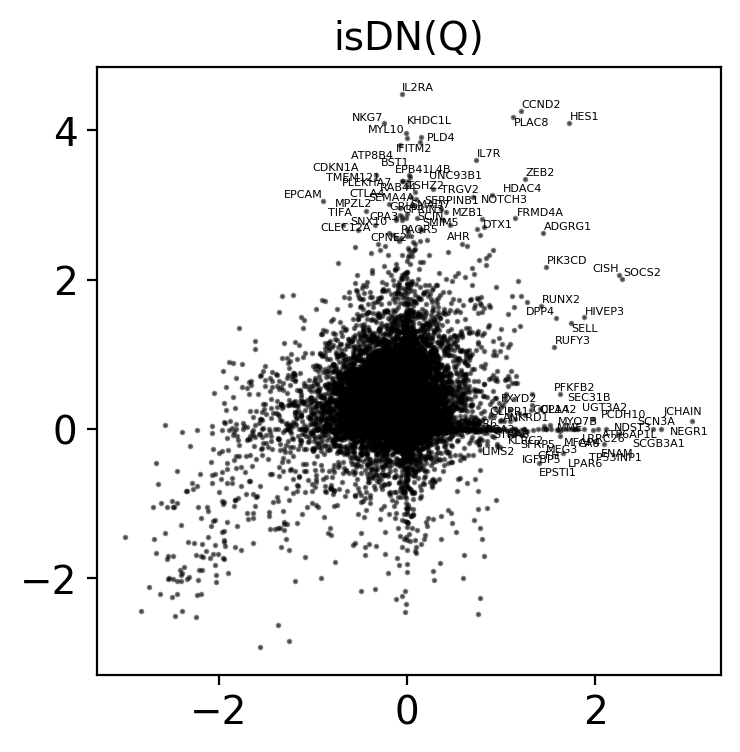

/mnt/thymus_atlas/scjp/species.py:41: RuntimeWarning:

divide by zero encountered in log10

/mnt/thymus_atlas/scjp/species.py:42: RuntimeWarning:

divide by zero encountered in log10



02_Output/HTA08.v02.A04.FigS1_epi_isDP(P).pdf


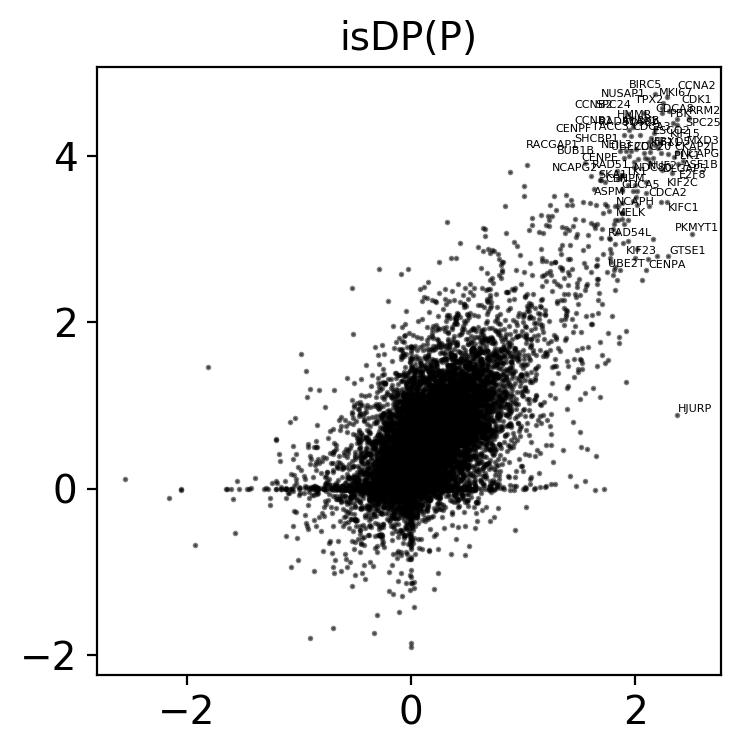

/mnt/thymus_atlas/scjp/species.py:41: RuntimeWarning:

divide by zero encountered in log10

/mnt/thymus_atlas/scjp/species.py:42: RuntimeWarning:

divide by zero encountered in log10



02_Output/HTA08.v02.A04.FigS1_epi_isDP(Q).pdf


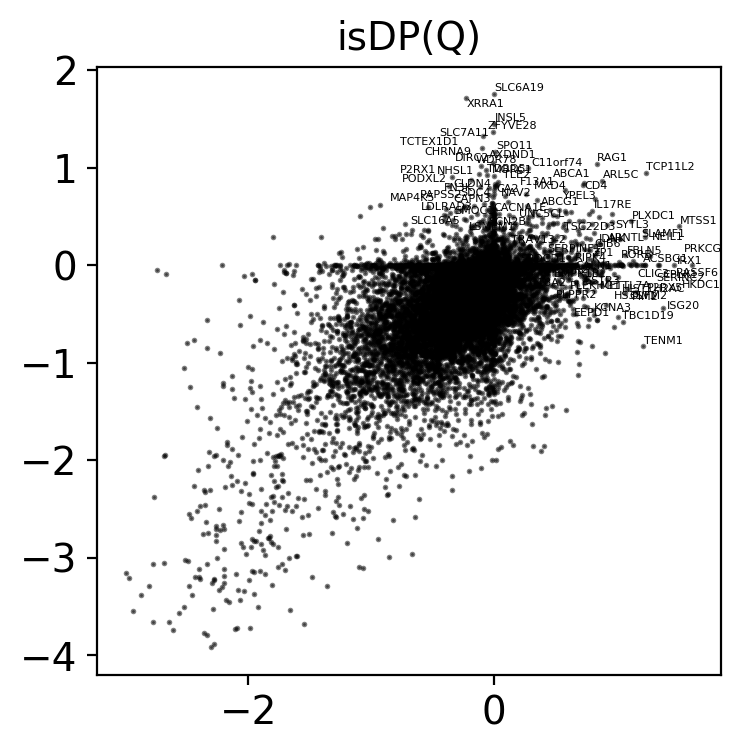

/mnt/thymus_atlas/scjp/species.py:41: RuntimeWarning:

divide by zero encountered in log10

/mnt/thymus_atlas/scjp/species.py:42: RuntimeWarning:

divide by zero encountered in log10



02_Output/HTA08.v02.A04.FigS1_epi_isEntry.pdf


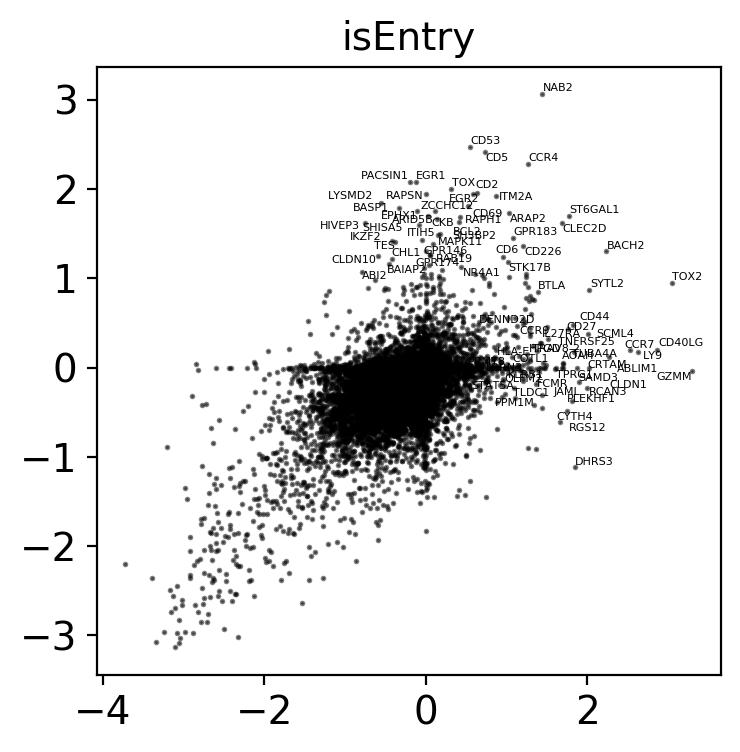

In [668]:
for ct in ['isDP','isDN','isDN(P)','isDN(Q)','isDP(P)','isDP(Q)','isEntry']:
    species.draw_scatter_speices_ct(ct,fc,version,fig_folder,percentile_thres=99.75,adjust_lim=5)
    #scjp.jp_save_fig(version,'Fig_HM_'+ct,fig_folder=fig_folder)
    plt.show()

02_Output/HTA08.v02.A04.Fig_mouse_ido_age.pdf


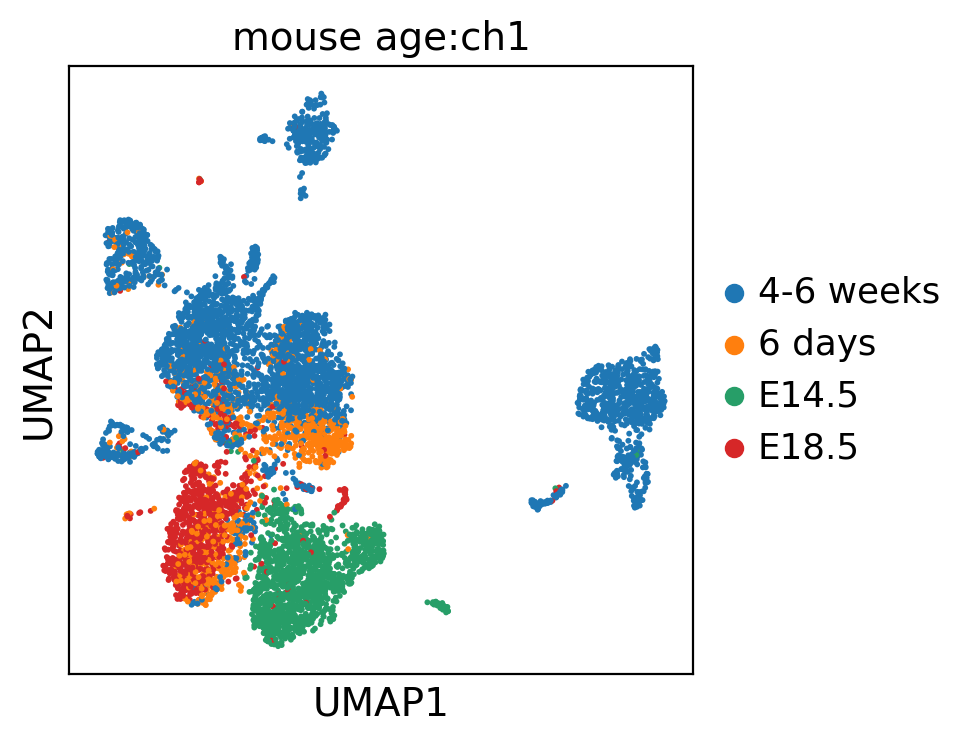

In [707]:
scjp.us(ST_mm,'mouse age:ch1',show=False)
scjp.jp_save_fig(version,'Fig_mouse_ido_age',fig_folder=fig_folder)

02_Output/HTA08.v02.A04.Fig_mouse_ido.pdf


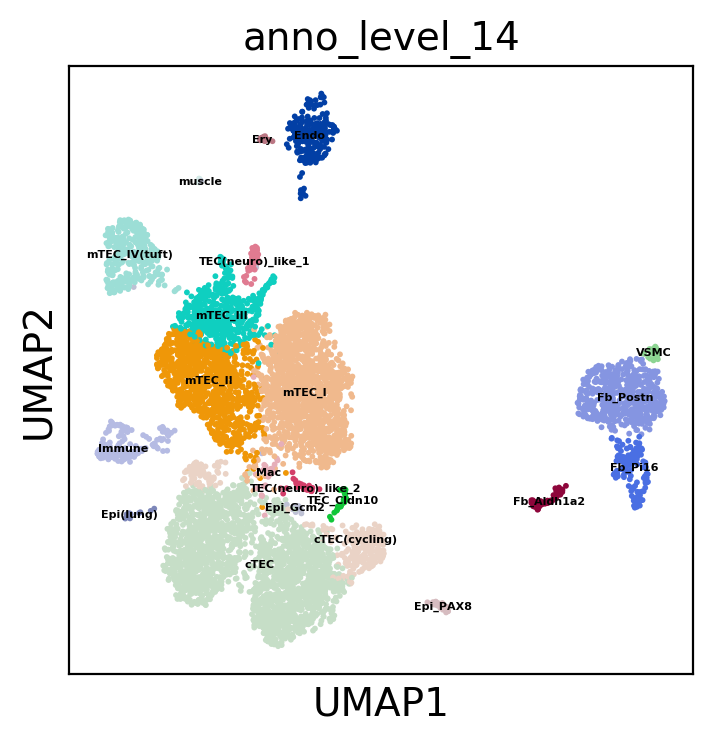

In [686]:
scjp.us(ST_mm,'anno_level_14',legend_loc='on data',legend_fontsize=4,show=False)
scjp.jp_save_fig(version,'Fig_mouse_ido',fig_folder=fig_folder)

02_Output/HTA08.v02.A04.Fig_mouse_ido_genes.pdf


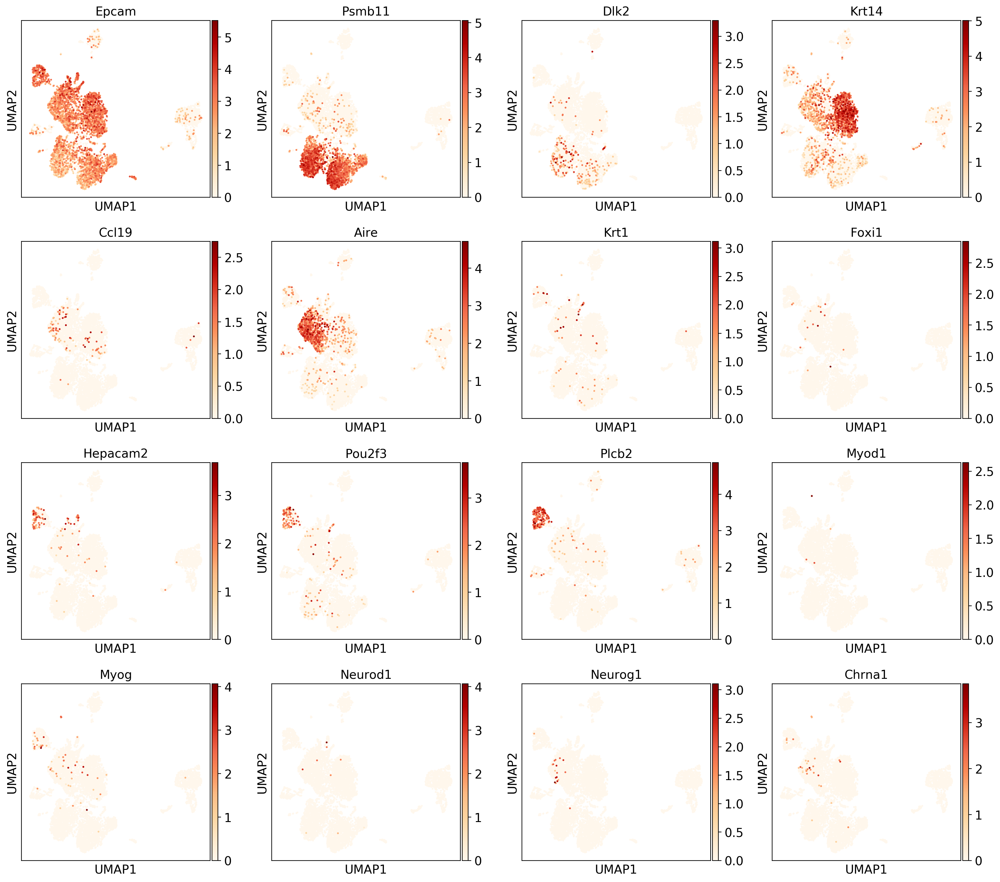

In [710]:
scjp.us(ST_mm,'Epcam,Psmb11,Dlk2,Krt14,Ccl19,Aire,Krt1,Foxi1,Hepacam2,Pou2f3,Plcb2,Myod1,Myog,Neurod1,Neurog1,Chrna1',show=False)
scjp.jp_save_fig(version,'Fig_mouse_ido_genes',fig_folder=fig_folder)

In [744]:
mm_jptca = mm_jptca[~mm_jptca.obs['anno_level_17'].isin('Epi_Gcm2,B-T_doublet'.split(','))]

In [745]:
mm_jptca.obs['stage'] = ['prenatal' if x=='tca' else 'postnatal' for x in mm_jptca.obs['name']]

Trying to set attribute `.obs` of view, making a copy.


... storing 'stage' as categorical


02_Output/HTA08.v02.A04.Fig_mouse_total_stage.pdf


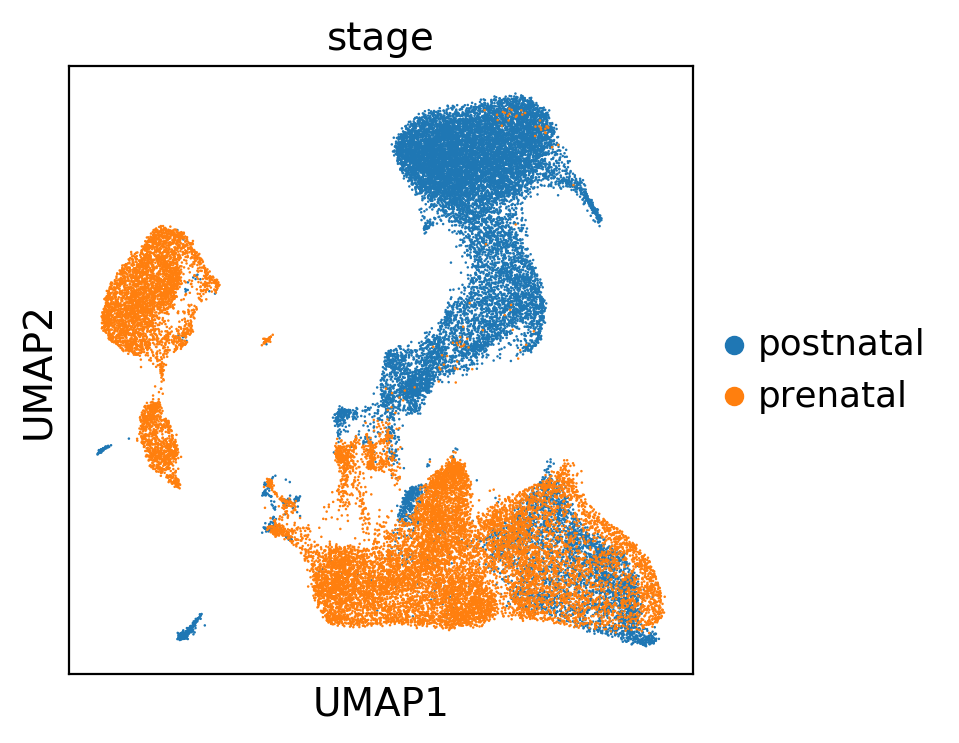

In [746]:
scjp.us(mm_jptca,'stage')
scjp.jp_save_fig(version,'Fig_mouse_total_stage',fig_folder=fig_folder)

In [735]:
mm_jptca.obs['cell types'] = list(mm_jptca.obs['anno_level_17'])

02_Output/HTA08.v02.A04.Fig_mouse_total_annotatino.pdf


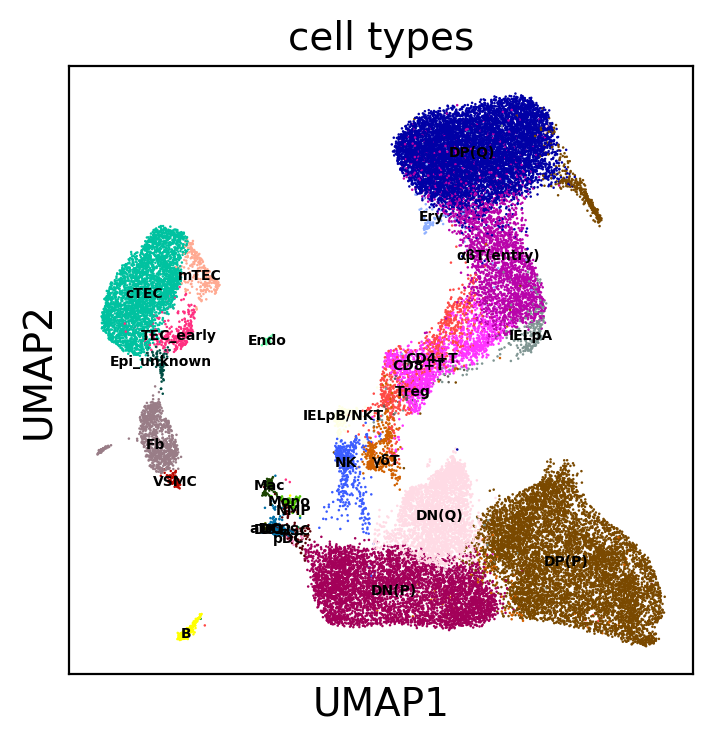

In [747]:
scjp.us(mm_jptca,'cell types',legend_loc='on data',legend_fontsize=5)
scjp.jp_save_fig(version,'Fig_mouse_total_annotatino',fig_folder=fig_folder)

In [738]:
mm_jptca.obs['age'] = list(mm_jptca.obs['Age'])

02_Output/HTA08.v02.A04.Fig_mouse_total_age.pdf


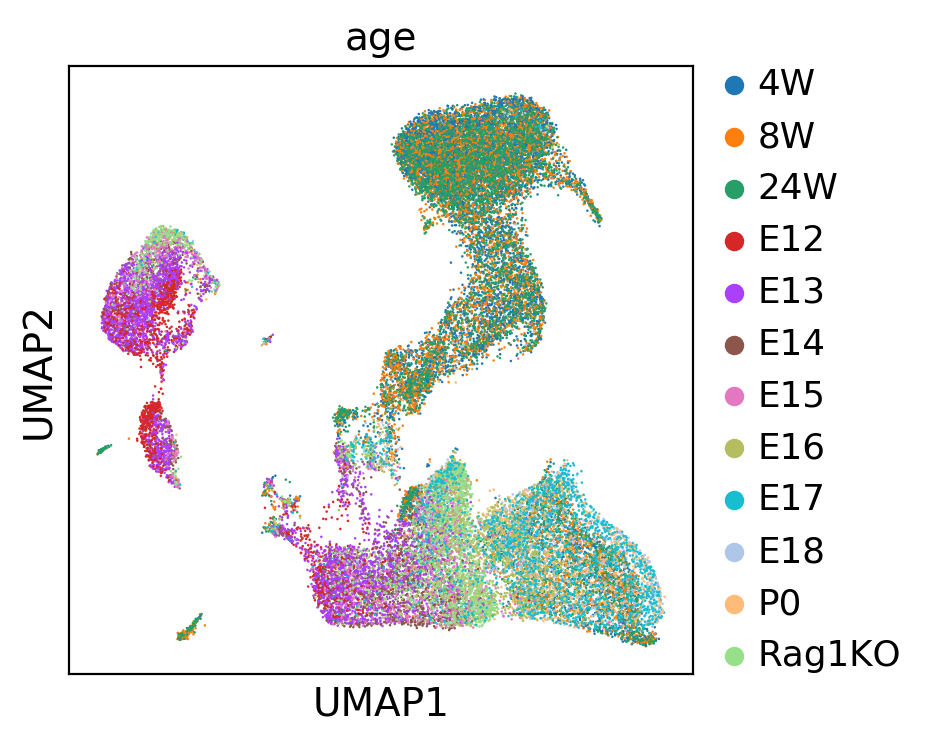

In [748]:
scjp.us(mm_jptca,'age')
scjp.jp_save_fig(version,'Fig_mouse_total_age',fig_folder=fig_folder)

In [ ]:
scjp.us(mm_jptca,'Sema3e,Plxnd1')

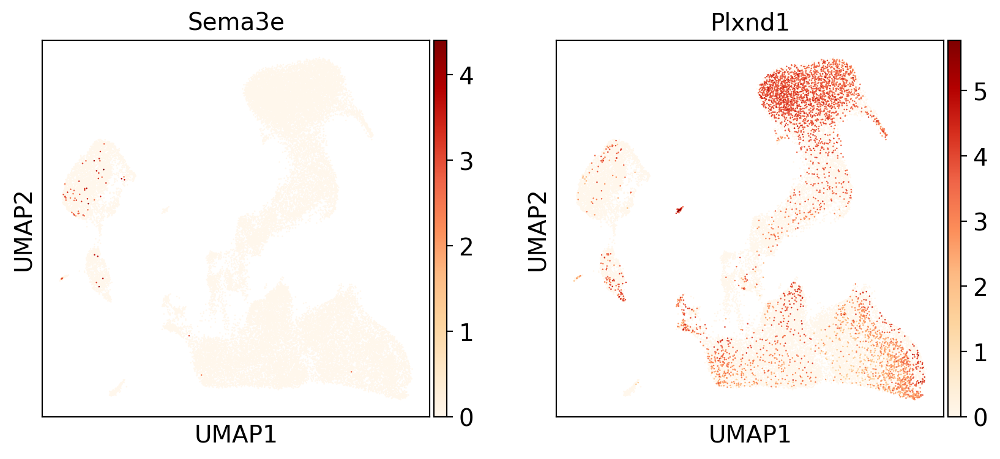

In [820]:
scjp.us(mm_jptca,'Sema3e,Plxnd1')

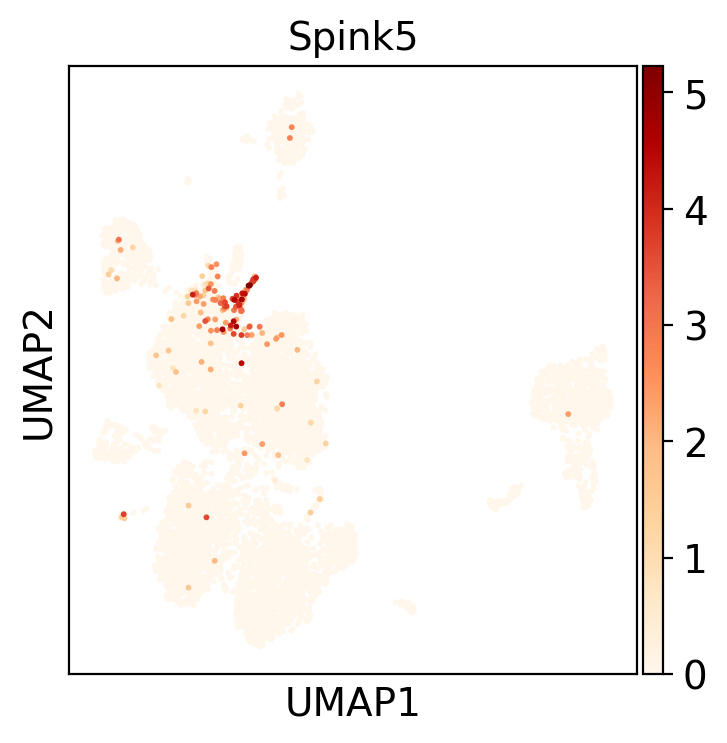

In [822]:
scjp.us(ST_mm,'Spink5')